In [1]:
import os
from pathlib import Path

import torch
from torch import nn
from torch import optim
from torch.utils.data import TensorDataset, DataLoader

import torchvision
from torchvision import transforms
from torchvision import datasets

from tqdm import tqdm

import time

from PIL import Image
import matplotlib.pyplot as plt

#used for finding most emoji-like final generated image
import torch.nn.functional as F_nn

colab = os.getenv('COLAB_GPU') != None

if colab:
    #used for making folders from Google Drive accessible
    from google.colab import drive

Ran for GPU compatability for running the model on local system:


---


**(Don't run these commands for running on Google Colab)**

> pip uninstall torch torchvision torchaudio

> pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118

In [2]:
#doesn't need to run on Google Colab, just checks if running the model locally that it will use your GPU


#makes sure GPU will be used for processing
if not colab:
    print("CUDA version for PyTorch", torch.version.cuda)
    print(torch.cuda.get_device_name(0))
    processing_device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    torch.set_default_device(processing_device)
    print(f"Model will use: {torch.get_default_device()}")


CUDA version for PyTorch 11.8
NVIDIA GeForce RTX 3050 Ti Laptop GPU
Model will use: cuda:0


In [3]:
#directory path from Colab Notebooks folder in Google Drive
folder = "images_faces_only"

image_folder_path = folder
if colab:
    drive.mount("/content/drive")
    image_folder_path = f"/content/drive/My Drive/Colab Notebooks/{folder}"

print(f"\nVerifying that the images can be found in the directory and used in the model in the folder \"{folder}\":")
print(os.listdir(image_folder_path))



Verifying that the images can be found in the directory and used in the model in the folder "images_faces_only":
['Apple', 'DoCoMo', 'Facebook', 'Gmail', 'Google', 'JoyPixels', 'KDDI', 'Samsung', 'SoftBank', 'Twitter', 'Windows']


In [4]:
image_dimentions = 64

def load_and_preprocess_images(data_dir, target_size=(64, 64)):
    #got rid of dataset extra augmentation to reduce rotated corners in outputted images
    transform = transforms.Compose([
        transforms.Resize(target_size),
        transforms.ToTensor()
    ])

    images = []
    labels = []
    class_to_idx = {}

    for idx, class_name in enumerate(sorted(os.listdir(data_dir))):
        class_path = os.path.join(data_dir, class_name)
        
        # Only train on certain classes
        if class_name not in ['Apple', 'Google', 'Facebook', 'Samsung', 'Twitter', 'Windows', 'JoyPixels']:
            continue
        
        class_to_idx[class_name] = idx
        for file_name in tqdm(os.listdir(class_path)):
            file_path = os.path.join(class_path, file_name)
            if os.path.isdir(file_path):
                continue
            image = Image.open(file_path).convert("RGB")
            image = transform(image)
            images.append(image)
            labels.append(idx)

    images = torch.stack(images)
    labels = torch.tensor(labels)

    #if running on cuda:
    #images = torch.stack(images).to(processing_device)
    #labels = torch.tensor(labels).to(processing_device)

    return images, labels, class_to_idx

#loading the data
data_dir = image_folder_path #directory path from Colab Notebooks folder in Google Drive
target_size = (image_dimentions, image_dimentions)
images, labels, class_to_idx = load_and_preprocess_images(data_dir, target_size)

  0%|          | 0/348 [00:00<?, ?it/s]c:\Users\adam4\anaconda3\lib\site-packages\PIL\Image.py:945: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(
100%|██████████| 322/322 [00:00<00:00, 959.27it/s]


In [5]:
class GeneratorNet(nn.Module):
    def __init__(self):
        super(GeneratorNet, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(100, 512, 4, 1, 0),  #layer takes in (100, 1, 1), and outputs (512, 4, 4)
            nn.BatchNorm2d(512),
            nn.ReLU(),

            nn.ConvTranspose2d(512, 256, 4, 2, 1),  #layer outputs (256, 8, 8)
            nn.BatchNorm2d(256),
            nn.ReLU(),

            nn.ConvTranspose2d(256, 128, 4, 2, 1),  #layer outputs (128, 16, 16)
            nn.BatchNorm2d(128),
            nn.ReLU(),

            nn.ConvTranspose2d(128, 64, 4, 2, 1),   #layer outputs (64, 32, 32)
            nn.BatchNorm2d(64),
            nn.ReLU(),
            
            nn.ConvTranspose2d(64, 3, 4, 2, 1),     #returns an image of dimensions (3, 64, 64)
            nn.Tanh(),
        )

    def forward(self, x):
        x = x.view(x.size(0), 100, 1, 1)  #reshape noise to input layer dimensions for the batch_size with (100, 1, 1)
        return self.model(x)

generator = GeneratorNet()

#if running on cuda:
#generator = GeneratorNet().to(processing_device)

In [6]:
#class DiscriminatorNet(nn.Module):
#    def __init__(self):
#        super(DiscriminatorNet, self).__init__()
#        self.model = nn.Sequential(
#            nn.Conv2d(3, 64, 4, 2, 1),      #layer takes in image (3, 64, 64), and outputs (64, 32, 32)
#            nn.LeakyReLU(0.2),
#            nn.Conv2d(64, 128, 4, 2, 1),    #layer outputs (128, 16, 16)
#            nn.BatchNorm2d(128),
#            nn.LeakyReLU(0.2),
#            nn.Conv2d(128, 256, 4, 2, 1),   #layer outputs (256, 8, 8)
#            nn.BatchNorm2d(256),
#            nn.LeakyReLU(0.2),
#            nn.Conv2d(256, 512, 4, 2, 1),   #layer outputs (512, 4, 4)
#            nn.BatchNorm2d(512),
#            nn.LeakyReLU(0.2),
#            nn.Conv2d(512, 1, 4, 1, 0),     #layer outputs (1, 1, 1)
#            nn.Sigmoid(),
#        )
#
#    def forward(self, x):
#        return self.model(x).view(-1, 1)
#
#discriminator = DiscriminatorNet()
#
##if running locally use instead:
##discriminator = DiscriminatorNet().to(processing_device)

In [7]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(3, 64, 4, 2, 1),      #layer takes in image (3, 64, 64), and outputs (64, 32, 32)
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, 4, 2, 1),    #layer outputs (128, 16, 16)
            nn.InstanceNorm2d(128, affine=True), 
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, 4, 2, 1),   #layer outputs (256, 8, 8)
            nn.InstanceNorm2d(256, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv2d(256, 512, 4, 2, 1),   #layer outputs (512, 4, 4)
            nn.InstanceNorm2d(512, affine=True),
            nn.LeakyReLU(0.2),
            nn.Conv2d(512, 1, 4, 1, 0),     #layer outputs (1, 1, 1)
        )

    def forward(self, x):
        return self.model(x).view(-1, 1)

discriminator = Discriminator()

#if running locally use instead:
#discriminator = DiscriminatorNet().to(processing_device)

In [8]:
import torchinfo
print(torchinfo.summary(generator, input_size=(128, 100, 1, 1)))
print(torchinfo.summary(discriminator, input_size=(128, 3, 64, 64)))

Layer (type:depth-idx)                   Output Shape              Param #
GeneratorNet                             [128, 3, 64, 64]          --
├─Sequential: 1-1                        [128, 3, 64, 64]          --
│    └─ConvTranspose2d: 2-1              [128, 512, 4, 4]          819,712
│    └─BatchNorm2d: 2-2                  [128, 512, 4, 4]          1,024
│    └─ReLU: 2-3                         [128, 512, 4, 4]          --
│    └─ConvTranspose2d: 2-4              [128, 256, 8, 8]          2,097,408
│    └─BatchNorm2d: 2-5                  [128, 256, 8, 8]          512
│    └─ReLU: 2-6                         [128, 256, 8, 8]          --
│    └─ConvTranspose2d: 2-7              [128, 128, 16, 16]        524,416
│    └─BatchNorm2d: 2-8                  [128, 128, 16, 16]        256
│    └─ReLU: 2-9                         [128, 128, 16, 16]        --
│    └─ConvTranspose2d: 2-10             [128, 64, 32, 32]         131,136
│    └─BatchNorm2d: 2-11                 [128, 64, 32, 32]

In [9]:
#if on cuda add param to all return statements: (..., device=processing_device)

def real_targets(size):
    return torch.full((size, 1), 0.9) #added label smoothing (floating points)

def fake_targets(size):
    return torch.full((size, 1), 0.1) #added label smoothing (floating points)

def noise(size):
    return torch.randn(size, 100)  #assume noise vector has 100 features

In [10]:
def image_grid(width, height, show_image=True, save_path=None, input_noise=None, size=8):
    if input_noise == None:
        input_noise = noise(width * height)
    generated_images = generator(input_noise).detach()
    generated_images = torch.clip(generated_images, 0, 1)
    grid = torchvision.utils.make_grid(generated_images, nrow=width, normalize=False)
    plt.figure(figsize=(size, size))
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis("off")

    if save_path != None:
        path = Path(save_path)
        path.parent.mkdir(parents=True, exist_ok=True)
        plt.savefig(path)
    
    if show_image:
        plt.show()

In [11]:
model_directory_root = 'models'
model_subdirectory = 'model'
model_directory = model_directory_root + '/' + model_subdirectory + '/'

def load_model():
    generator.load_state_dict(torch.load(model_directory + 'generator.pt', weights_only=True))
    discriminator.load_state_dict(torch.load(model_directory + 'discriminator.pt', weights_only=True))

def save_model():
    path = Path(model_directory)
    path.mkdir(parents=True, exist_ok=True)
    torch.save(generator.state_dict(), model_directory + 'generator.pt')
    torch.save(discriminator.state_dict(), model_directory + 'discriminator.pt')

In [12]:
# Only run this cell if you want to load saved model weights

#try:
#    load_model()
#    print('model loaded')
#except:
#    print('model failed to load')

In [13]:
# Noise to use when generating samples. Set to None to use different noise each epoch.
sample_noise = noise(9)


In [14]:
## TEMP
def critic_loss(real_scores, fake_scores):
    return -(torch.mean(real_scores) - torch.mean(fake_scores))

def generator_loss(fake_scores):
    return -torch.mean(fake_scores)

clip_value = 0.01  # Clipping range
for p in discriminator.parameters():
    p.data.clamp_(-clip_value, clip_value)


def gradient_penalty(discriminator, real_samples, fake_samples):
    alpha = torch.rand(real_samples.size(0), 1, 1, 1, device=real_samples.device)
    interpolates = (alpha * real_samples + (1 - alpha) * fake_samples).requires_grad_(True)
    scores = discriminator(interpolates)
    gradients = torch.autograd.grad(
        outputs=scores,
        inputs=interpolates,
        grad_outputs=torch.ones_like(scores, device=real_samples.device),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradients = gradients.view(gradients.size(0), -1)
    penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return penalty

lambda_gp = 10  # Gradient penalty coefficient


Epoch #0 / 2000, Generator Loss: -0.6808786392211914, Discriminator Loss: 0.3012809157371521
Generated images for Epoch #0:


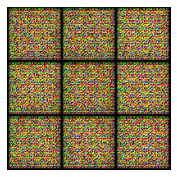

0:27
Epoch #1 / 2000, Generator Loss: -0.8468323945999146, Discriminator Loss: -0.2091236114501953
Epoch #2 / 2000, Generator Loss: -1.3047211170196533, Discriminator Loss: -1.5104281902313232
Epoch #3 / 2000, Generator Loss: -1.36494779586792, Discriminator Loss: -2.9785518646240234
Epoch #4 / 2000, Generator Loss: -2.873779296875, Discriminator Loss: -5.598464488983154
Generated images for Epoch #4:


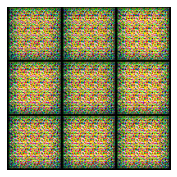

2:16
Epoch #5 / 2000, Generator Loss: -1.800529956817627, Discriminator Loss: -8.934460639953613
Epoch #6 / 2000, Generator Loss: -6.644115447998047, Discriminator Loss: -14.458511352539062
Epoch #7 / 2000, Generator Loss: -2.369781017303467, Discriminator Loss: -20.621389389038086
Epoch #8 / 2000, Generator Loss: -7.6813554763793945, Discriminator Loss: -29.136499404907227
Generated images for Epoch #8:


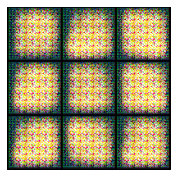

4:05
Epoch #9 / 2000, Generator Loss: -3.7128214836120605, Discriminator Loss: -36.85352325439453
Epoch #10 / 2000, Generator Loss: -4.116611003875732, Discriminator Loss: -45.1734733581543
Epoch #11 / 2000, Generator Loss: 0.2503335475921631, Discriminator Loss: -48.6755485534668
Epoch #12 / 2000, Generator Loss: 5.205217361450195, Discriminator Loss: -48.91099166870117
Generated images for Epoch #12:


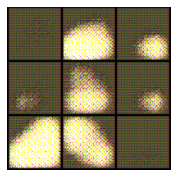

5:53
Epoch #13 / 2000, Generator Loss: 13.458820343017578, Discriminator Loss: -45.39179992675781
Epoch #14 / 2000, Generator Loss: 20.997352600097656, Discriminator Loss: -45.43505859375
Epoch #15 / 2000, Generator Loss: 19.215621948242188, Discriminator Loss: -48.848907470703125
Epoch #16 / 2000, Generator Loss: 33.34577178955078, Discriminator Loss: -44.622432708740234
Generated images for Epoch #16:


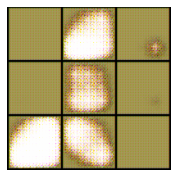

9:23
Epoch #17 / 2000, Generator Loss: 36.963714599609375, Discriminator Loss: -48.20712661743164
Epoch #18 / 2000, Generator Loss: 35.21070861816406, Discriminator Loss: -56.51226806640625
Epoch #19 / 2000, Generator Loss: 35.877723693847656, Discriminator Loss: -53.97313690185547
Epoch #20 / 2000, Generator Loss: 40.28777313232422, Discriminator Loss: -50.37186050415039
Generated images for Epoch #20:


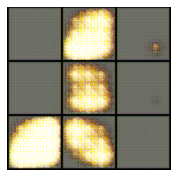

11:12
Epoch #21 / 2000, Generator Loss: 40.65617370605469, Discriminator Loss: -56.051212310791016
Epoch #22 / 2000, Generator Loss: 32.19093322753906, Discriminator Loss: -48.450584411621094
Epoch #23 / 2000, Generator Loss: 37.67857360839844, Discriminator Loss: -56.46466064453125
Epoch #24 / 2000, Generator Loss: 37.51932144165039, Discriminator Loss: -59.227699279785156
Generated images for Epoch #24:


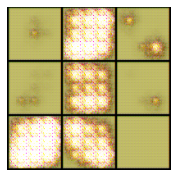

13:00
Epoch #25 / 2000, Generator Loss: 42.894615173339844, Discriminator Loss: -66.04598999023438
Epoch #26 / 2000, Generator Loss: 40.863494873046875, Discriminator Loss: -70.24223327636719
Epoch #27 / 2000, Generator Loss: 26.841510772705078, Discriminator Loss: -58.09187316894531
Epoch #28 / 2000, Generator Loss: 42.718994140625, Discriminator Loss: -50.607051849365234
Generated images for Epoch #28:


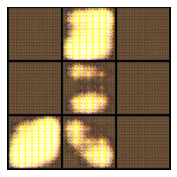

14:49
Epoch #29 / 2000, Generator Loss: 51.01646423339844, Discriminator Loss: -55.41367721557617
Epoch #30 / 2000, Generator Loss: 38.119537353515625, Discriminator Loss: -67.93458557128906
Epoch #31 / 2000, Generator Loss: 15.080453872680664, Discriminator Loss: -60.194190979003906
Epoch #32 / 2000, Generator Loss: 25.216289520263672, Discriminator Loss: -59.50392150878906
Generated images for Epoch #32:


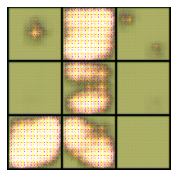

16:38
Epoch #33 / 2000, Generator Loss: 36.30299377441406, Discriminator Loss: -60.883941650390625
Epoch #34 / 2000, Generator Loss: 41.09184265136719, Discriminator Loss: -63.803001403808594
Epoch #35 / 2000, Generator Loss: 37.63624954223633, Discriminator Loss: -67.8585433959961
Epoch #36 / 2000, Generator Loss: 41.530250549316406, Discriminator Loss: -58.68963623046875
Generated images for Epoch #36:


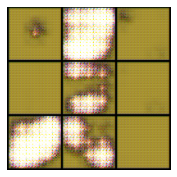

18:26
Epoch #37 / 2000, Generator Loss: 45.09296417236328, Discriminator Loss: -53.11475372314453
Epoch #38 / 2000, Generator Loss: 37.52989196777344, Discriminator Loss: -54.716915130615234
Epoch #39 / 2000, Generator Loss: 37.052345275878906, Discriminator Loss: -54.78660202026367
Epoch #40 / 2000, Generator Loss: 27.657939910888672, Discriminator Loss: -50.90273666381836
Generated images for Epoch #40:


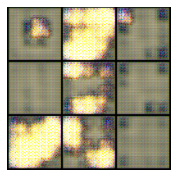

20:15
Epoch #41 / 2000, Generator Loss: 22.855545043945312, Discriminator Loss: -50.90425109863281
Epoch #42 / 2000, Generator Loss: 31.3499698638916, Discriminator Loss: -46.13488006591797
Epoch #43 / 2000, Generator Loss: 21.833984375, Discriminator Loss: -58.650001525878906
Epoch #44 / 2000, Generator Loss: 22.20749855041504, Discriminator Loss: -55.55712890625
Generated images for Epoch #44:


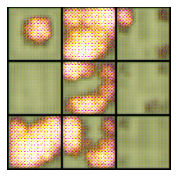

22:04
Epoch #45 / 2000, Generator Loss: 31.81257438659668, Discriminator Loss: -53.42413330078125
Epoch #46 / 2000, Generator Loss: 34.81660461425781, Discriminator Loss: -46.06906509399414
Epoch #47 / 2000, Generator Loss: 29.30809211730957, Discriminator Loss: -47.16358947753906
Epoch #48 / 2000, Generator Loss: 32.26431655883789, Discriminator Loss: -54.85179138183594
Generated images for Epoch #48:


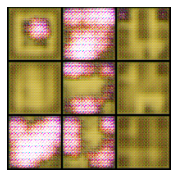

23:52
Epoch #49 / 2000, Generator Loss: 29.857200622558594, Discriminator Loss: -55.23260498046875
Epoch #50 / 2000, Generator Loss: 35.40034866333008, Discriminator Loss: -46.37618637084961
Epoch #51 / 2000, Generator Loss: 26.486907958984375, Discriminator Loss: -42.15616226196289
Epoch #52 / 2000, Generator Loss: 23.128334045410156, Discriminator Loss: -42.83196258544922
Generated images for Epoch #52:


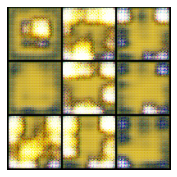

25:41
Epoch #53 / 2000, Generator Loss: 27.783306121826172, Discriminator Loss: -45.823917388916016
Epoch #54 / 2000, Generator Loss: 26.48552703857422, Discriminator Loss: -46.93708038330078
Epoch #55 / 2000, Generator Loss: 27.38279151916504, Discriminator Loss: -49.763816833496094
Epoch #56 / 2000, Generator Loss: 16.411041259765625, Discriminator Loss: -53.56484603881836
Generated images for Epoch #56:


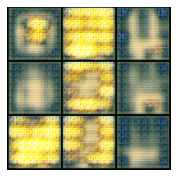

27:31
Epoch #57 / 2000, Generator Loss: 26.54949951171875, Discriminator Loss: -46.831581115722656
Epoch #58 / 2000, Generator Loss: 33.321311950683594, Discriminator Loss: -49.28233337402344
Epoch #59 / 2000, Generator Loss: 22.844541549682617, Discriminator Loss: -50.93213653564453
Epoch #60 / 2000, Generator Loss: 23.959165573120117, Discriminator Loss: -45.741844177246094
Generated images for Epoch #60:


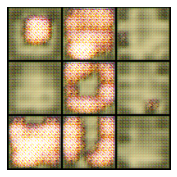

29:20
Epoch #61 / 2000, Generator Loss: 25.301586151123047, Discriminator Loss: -47.12518310546875
Epoch #62 / 2000, Generator Loss: 25.210582733154297, Discriminator Loss: -54.15491485595703
Epoch #63 / 2000, Generator Loss: 22.169981002807617, Discriminator Loss: -39.51455307006836
Epoch #64 / 2000, Generator Loss: 28.176403045654297, Discriminator Loss: -42.588443756103516
Generated images for Epoch #64:


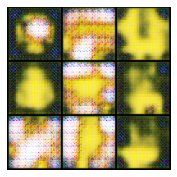

31:09
Epoch #65 / 2000, Generator Loss: 31.25531578063965, Discriminator Loss: -37.24745559692383
Epoch #66 / 2000, Generator Loss: 35.416053771972656, Discriminator Loss: -44.0142707824707
Epoch #67 / 2000, Generator Loss: 26.28065299987793, Discriminator Loss: -42.80767059326172
Epoch #68 / 2000, Generator Loss: 18.335309982299805, Discriminator Loss: -37.677223205566406
Generated images for Epoch #68:


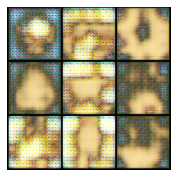

32:58
Epoch #69 / 2000, Generator Loss: 20.213905334472656, Discriminator Loss: -40.350852966308594
Epoch #70 / 2000, Generator Loss: 18.127277374267578, Discriminator Loss: -41.14833068847656
Epoch #71 / 2000, Generator Loss: 18.069080352783203, Discriminator Loss: -42.391639709472656
Epoch #72 / 2000, Generator Loss: 26.445037841796875, Discriminator Loss: -43.53715133666992
Generated images for Epoch #72:


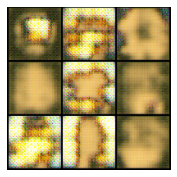

34:47
Epoch #73 / 2000, Generator Loss: 22.4013671875, Discriminator Loss: -43.866859436035156
Epoch #74 / 2000, Generator Loss: 16.55403709411621, Discriminator Loss: -39.2979736328125
Epoch #75 / 2000, Generator Loss: 25.321828842163086, Discriminator Loss: -37.86821365356445
Epoch #76 / 2000, Generator Loss: 23.844953536987305, Discriminator Loss: -36.92906951904297
Generated images for Epoch #76:


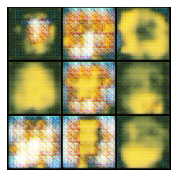

36:36
Epoch #77 / 2000, Generator Loss: 15.681700706481934, Discriminator Loss: -35.67945861816406
Epoch #78 / 2000, Generator Loss: 18.84185218811035, Discriminator Loss: -36.525474548339844
Epoch #79 / 2000, Generator Loss: 20.392669677734375, Discriminator Loss: -40.732200622558594
Epoch #80 / 2000, Generator Loss: 13.013553619384766, Discriminator Loss: -34.73603439331055
Generated images for Epoch #80:


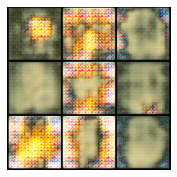

38:26
Epoch #81 / 2000, Generator Loss: 14.903679847717285, Discriminator Loss: -40.26633071899414
Epoch #82 / 2000, Generator Loss: 11.456817626953125, Discriminator Loss: -38.87789535522461
Epoch #83 / 2000, Generator Loss: 10.570871353149414, Discriminator Loss: -34.94294738769531
Epoch #84 / 2000, Generator Loss: 18.856483459472656, Discriminator Loss: -37.63587188720703
Generated images for Epoch #84:


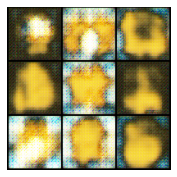

40:15
Epoch #85 / 2000, Generator Loss: 23.181209564208984, Discriminator Loss: -32.550384521484375
Epoch #86 / 2000, Generator Loss: 14.547718048095703, Discriminator Loss: -30.763450622558594
Epoch #87 / 2000, Generator Loss: 14.295768737792969, Discriminator Loss: -36.31683349609375
Epoch #88 / 2000, Generator Loss: 11.455509185791016, Discriminator Loss: -36.798484802246094
Generated images for Epoch #88:


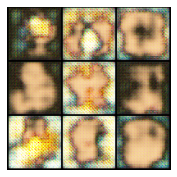

42:04
Epoch #89 / 2000, Generator Loss: 13.274568557739258, Discriminator Loss: -36.74092483520508
Epoch #90 / 2000, Generator Loss: 10.460355758666992, Discriminator Loss: -34.41898727416992
Epoch #91 / 2000, Generator Loss: 13.656669616699219, Discriminator Loss: -35.859283447265625
Epoch #92 / 2000, Generator Loss: 13.49907398223877, Discriminator Loss: -39.095916748046875
Generated images for Epoch #92:


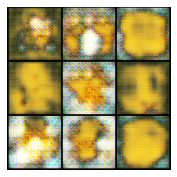

43:54
Epoch #93 / 2000, Generator Loss: 10.877762794494629, Discriminator Loss: -39.58272933959961
Epoch #94 / 2000, Generator Loss: 15.444968223571777, Discriminator Loss: -40.62726974487305
Epoch #95 / 2000, Generator Loss: 12.596324920654297, Discriminator Loss: -40.2909049987793
Epoch #96 / 2000, Generator Loss: 10.796058654785156, Discriminator Loss: -38.550209045410156
Generated images for Epoch #96:


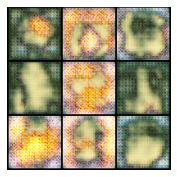

45:44
Epoch #97 / 2000, Generator Loss: 10.70750617980957, Discriminator Loss: -40.18779754638672
Epoch #98 / 2000, Generator Loss: 9.027884483337402, Discriminator Loss: -35.14543151855469
Epoch #99 / 2000, Generator Loss: 10.840991973876953, Discriminator Loss: -41.9499626159668
Epoch #100 / 2000, Generator Loss: 9.510083198547363, Discriminator Loss: -34.27684783935547
Generated images for Epoch #100:


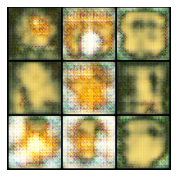

47:35
Epoch #101 / 2000, Generator Loss: 12.434446334838867, Discriminator Loss: -34.92500305175781
Epoch #102 / 2000, Generator Loss: 12.300922393798828, Discriminator Loss: -33.846527099609375
Epoch #103 / 2000, Generator Loss: 11.88758659362793, Discriminator Loss: -34.90299987792969
Epoch #104 / 2000, Generator Loss: 12.243125915527344, Discriminator Loss: -35.48111343383789
Generated images for Epoch #104:


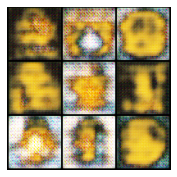

49:24
Epoch #105 / 2000, Generator Loss: 14.671890258789062, Discriminator Loss: -34.2257194519043
Epoch #106 / 2000, Generator Loss: 11.846010208129883, Discriminator Loss: -35.6353759765625
Epoch #107 / 2000, Generator Loss: 9.609905242919922, Discriminator Loss: -33.310302734375
Epoch #108 / 2000, Generator Loss: 9.98674488067627, Discriminator Loss: -39.73128890991211
Generated images for Epoch #108:


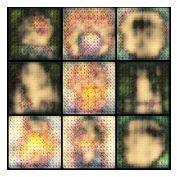

51:13
Epoch #109 / 2000, Generator Loss: 8.787020683288574, Discriminator Loss: -38.809120178222656
Epoch #110 / 2000, Generator Loss: 6.6585283279418945, Discriminator Loss: -34.712799072265625
Epoch #111 / 2000, Generator Loss: 1.3656798601150513, Discriminator Loss: -42.691341400146484
Epoch #112 / 2000, Generator Loss: 9.201183319091797, Discriminator Loss: -36.43191909790039
Generated images for Epoch #112:


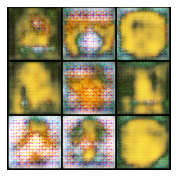

53:02
Epoch #113 / 2000, Generator Loss: 9.08279800415039, Discriminator Loss: -38.69948196411133
Epoch #114 / 2000, Generator Loss: 12.263248443603516, Discriminator Loss: -33.88372802734375
Epoch #115 / 2000, Generator Loss: 14.96236801147461, Discriminator Loss: -33.008697509765625
Epoch #116 / 2000, Generator Loss: 7.807835578918457, Discriminator Loss: -32.13368225097656
Generated images for Epoch #116:


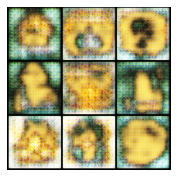

54:51
Epoch #117 / 2000, Generator Loss: 8.792177200317383, Discriminator Loss: -41.031707763671875
Epoch #118 / 2000, Generator Loss: 7.466797828674316, Discriminator Loss: -37.782867431640625
Epoch #119 / 2000, Generator Loss: 14.089614868164062, Discriminator Loss: -33.55545425415039
Epoch #120 / 2000, Generator Loss: 13.820691108703613, Discriminator Loss: -36.72598648071289
Generated images for Epoch #120:


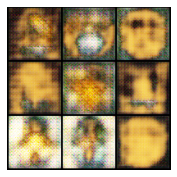

56:41
Epoch #121 / 2000, Generator Loss: 11.165450096130371, Discriminator Loss: -40.51289367675781
Epoch #122 / 2000, Generator Loss: 7.943747043609619, Discriminator Loss: -35.99332046508789
Epoch #123 / 2000, Generator Loss: 9.959478378295898, Discriminator Loss: -34.141082763671875
Epoch #124 / 2000, Generator Loss: 8.766550064086914, Discriminator Loss: -34.18935775756836
Generated images for Epoch #124:


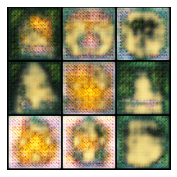

58:32
Epoch #125 / 2000, Generator Loss: 11.068727493286133, Discriminator Loss: -35.92827606201172
Epoch #126 / 2000, Generator Loss: 7.049765586853027, Discriminator Loss: -37.3521842956543
Epoch #127 / 2000, Generator Loss: 7.834869384765625, Discriminator Loss: -35.16973876953125
Epoch #128 / 2000, Generator Loss: 13.796882629394531, Discriminator Loss: -32.58614730834961
Generated images for Epoch #128:


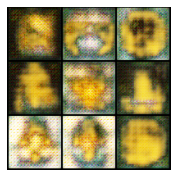

60:23
Epoch #129 / 2000, Generator Loss: 7.072964668273926, Discriminator Loss: -30.161169052124023
Epoch #130 / 2000, Generator Loss: 11.322521209716797, Discriminator Loss: -33.2916259765625
Epoch #131 / 2000, Generator Loss: 8.827917098999023, Discriminator Loss: -33.02201461791992
Epoch #132 / 2000, Generator Loss: 7.577157974243164, Discriminator Loss: -31.5885009765625
Generated images for Epoch #132:


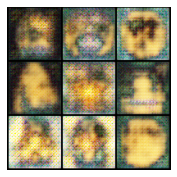

62:12
Epoch #133 / 2000, Generator Loss: 8.104232788085938, Discriminator Loss: -37.92669677734375
Epoch #134 / 2000, Generator Loss: 5.801874160766602, Discriminator Loss: -30.936492919921875
Epoch #135 / 2000, Generator Loss: 10.75497055053711, Discriminator Loss: -31.27918243408203
Epoch #136 / 2000, Generator Loss: 8.37156867980957, Discriminator Loss: -29.963144302368164
Generated images for Epoch #136:


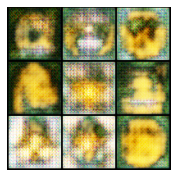

64:00
Epoch #137 / 2000, Generator Loss: 5.497649669647217, Discriminator Loss: -34.58893585205078
Epoch #138 / 2000, Generator Loss: 12.234916687011719, Discriminator Loss: -31.904476165771484
Epoch #139 / 2000, Generator Loss: 7.851736545562744, Discriminator Loss: -33.63589859008789
Epoch #140 / 2000, Generator Loss: 6.312535285949707, Discriminator Loss: -35.77080535888672
Generated images for Epoch #140:


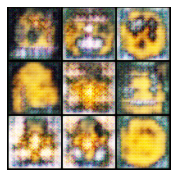

65:49
Epoch #141 / 2000, Generator Loss: 8.037944793701172, Discriminator Loss: -35.08796310424805
Epoch #142 / 2000, Generator Loss: 9.082175254821777, Discriminator Loss: -32.058067321777344
Epoch #143 / 2000, Generator Loss: 10.455989837646484, Discriminator Loss: -33.87950134277344
Epoch #144 / 2000, Generator Loss: 8.910655975341797, Discriminator Loss: -32.70598602294922
Generated images for Epoch #144:


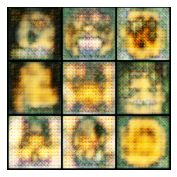

67:38
Epoch #145 / 2000, Generator Loss: 8.72205638885498, Discriminator Loss: -39.790470123291016
Epoch #146 / 2000, Generator Loss: 4.524724006652832, Discriminator Loss: -33.705177307128906
Epoch #147 / 2000, Generator Loss: 6.584517478942871, Discriminator Loss: -33.55271530151367
Epoch #148 / 2000, Generator Loss: 11.910943984985352, Discriminator Loss: -33.02278518676758
Generated images for Epoch #148:


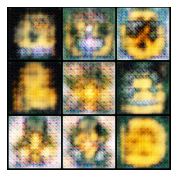

69:27
Epoch #149 / 2000, Generator Loss: 9.810093879699707, Discriminator Loss: -31.61067008972168
Epoch #150 / 2000, Generator Loss: 10.488191604614258, Discriminator Loss: -28.38978385925293
Epoch #151 / 2000, Generator Loss: 9.50822925567627, Discriminator Loss: -35.564002990722656
Epoch #152 / 2000, Generator Loss: 10.283586502075195, Discriminator Loss: -32.6599006652832
Generated images for Epoch #152:


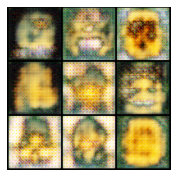

71:16
Epoch #153 / 2000, Generator Loss: 9.872471809387207, Discriminator Loss: -30.914806365966797
Epoch #154 / 2000, Generator Loss: 8.271834373474121, Discriminator Loss: -37.00962448120117
Epoch #155 / 2000, Generator Loss: 7.157663345336914, Discriminator Loss: -28.742286682128906
Epoch #156 / 2000, Generator Loss: 8.508769989013672, Discriminator Loss: -28.990901947021484
Generated images for Epoch #156:


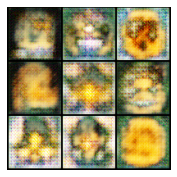

73:04
Epoch #157 / 2000, Generator Loss: 5.705812931060791, Discriminator Loss: -27.783292770385742
Epoch #158 / 2000, Generator Loss: 8.89001750946045, Discriminator Loss: -27.69562530517578
Epoch #159 / 2000, Generator Loss: 6.047811031341553, Discriminator Loss: -29.411039352416992
Epoch #160 / 2000, Generator Loss: 8.604804992675781, Discriminator Loss: -29.071338653564453
Generated images for Epoch #160:


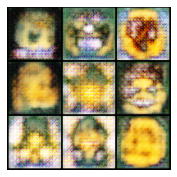

74:53
Epoch #161 / 2000, Generator Loss: 8.550630569458008, Discriminator Loss: -32.391212463378906
Epoch #162 / 2000, Generator Loss: 7.735875606536865, Discriminator Loss: -26.491819381713867
Epoch #163 / 2000, Generator Loss: 7.627865791320801, Discriminator Loss: -33.433258056640625
Epoch #164 / 2000, Generator Loss: 5.1913228034973145, Discriminator Loss: -31.186695098876953
Generated images for Epoch #164:


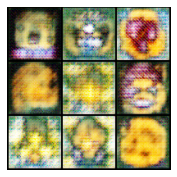

76:42
Epoch #165 / 2000, Generator Loss: 6.220845699310303, Discriminator Loss: -27.526351928710938
Epoch #166 / 2000, Generator Loss: 6.511648178100586, Discriminator Loss: -32.28221130371094
Epoch #167 / 2000, Generator Loss: 0.6448873281478882, Discriminator Loss: -28.298675537109375
Epoch #168 / 2000, Generator Loss: 4.729180812835693, Discriminator Loss: -27.10739517211914
Generated images for Epoch #168:


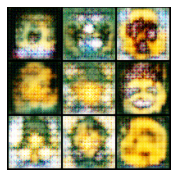

78:30
Epoch #169 / 2000, Generator Loss: 5.398255348205566, Discriminator Loss: -26.219642639160156
Epoch #170 / 2000, Generator Loss: 1.7342170476913452, Discriminator Loss: -27.259061813354492
Epoch #171 / 2000, Generator Loss: 3.2346436977386475, Discriminator Loss: -27.974151611328125
Epoch #172 / 2000, Generator Loss: 6.182904243469238, Discriminator Loss: -36.56108474731445
Generated images for Epoch #172:


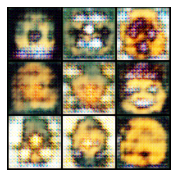

80:19
Epoch #173 / 2000, Generator Loss: 5.177138328552246, Discriminator Loss: -26.31924819946289
Epoch #174 / 2000, Generator Loss: 7.0167131423950195, Discriminator Loss: -30.779037475585938
Epoch #175 / 2000, Generator Loss: 4.608290672302246, Discriminator Loss: -30.892559051513672
Epoch #176 / 2000, Generator Loss: 6.2202277183532715, Discriminator Loss: -28.875553131103516
Generated images for Epoch #176:


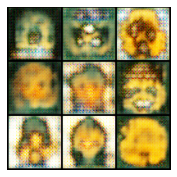

82:08
Epoch #177 / 2000, Generator Loss: 3.332655906677246, Discriminator Loss: -32.395145416259766
Epoch #178 / 2000, Generator Loss: 6.826853275299072, Discriminator Loss: -33.38349151611328
Epoch #179 / 2000, Generator Loss: 6.039884567260742, Discriminator Loss: -30.068378448486328
Epoch #180 / 2000, Generator Loss: 3.3033971786499023, Discriminator Loss: -32.37910461425781
Generated images for Epoch #180:


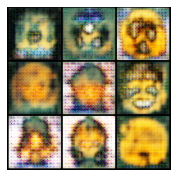

83:57
Epoch #181 / 2000, Generator Loss: 6.729419708251953, Discriminator Loss: -32.52769088745117
Epoch #182 / 2000, Generator Loss: 3.457782030105591, Discriminator Loss: -29.140422821044922
Epoch #183 / 2000, Generator Loss: 6.3134565353393555, Discriminator Loss: -19.554645538330078
Epoch #184 / 2000, Generator Loss: 1.1890677213668823, Discriminator Loss: -29.95694351196289
Generated images for Epoch #184:


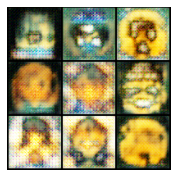

85:46
Epoch #185 / 2000, Generator Loss: 0.9219362735748291, Discriminator Loss: -28.615760803222656
Epoch #186 / 2000, Generator Loss: 5.788987159729004, Discriminator Loss: -29.127351760864258
Epoch #187 / 2000, Generator Loss: 3.7889132499694824, Discriminator Loss: -29.012741088867188
Epoch #188 / 2000, Generator Loss: 6.9718780517578125, Discriminator Loss: -27.675025939941406
Generated images for Epoch #188:


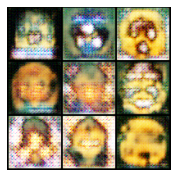

87:35
Epoch #189 / 2000, Generator Loss: 3.090198516845703, Discriminator Loss: -32.472801208496094
Epoch #190 / 2000, Generator Loss: 4.978821754455566, Discriminator Loss: -30.180435180664062
Epoch #191 / 2000, Generator Loss: 3.8442840576171875, Discriminator Loss: -22.993467330932617
Epoch #192 / 2000, Generator Loss: 3.910621166229248, Discriminator Loss: -28.807401657104492
Generated images for Epoch #192:


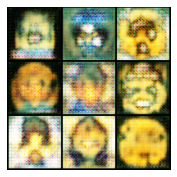

89:26
Epoch #193 / 2000, Generator Loss: 1.9497538805007935, Discriminator Loss: -27.44536590576172
Epoch #194 / 2000, Generator Loss: 1.5846989154815674, Discriminator Loss: -27.53841781616211
Epoch #195 / 2000, Generator Loss: 4.627220630645752, Discriminator Loss: -30.5789852142334
Epoch #196 / 2000, Generator Loss: 4.158031463623047, Discriminator Loss: -28.508995056152344
Generated images for Epoch #196:


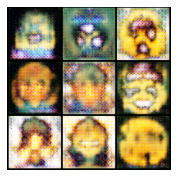

91:16
Epoch #197 / 2000, Generator Loss: 4.697336196899414, Discriminator Loss: -27.775976181030273
Epoch #198 / 2000, Generator Loss: 2.0854902267456055, Discriminator Loss: -27.370162963867188
Epoch #199 / 2000, Generator Loss: 5.153343200683594, Discriminator Loss: -30.048728942871094
Epoch #200 / 2000, Generator Loss: 3.6403005123138428, Discriminator Loss: -24.79265022277832
Generated images for Epoch #200:


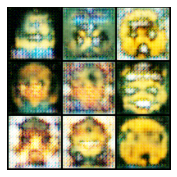

93:05
Epoch #201 / 2000, Generator Loss: 6.418603897094727, Discriminator Loss: -29.97462272644043
Epoch #202 / 2000, Generator Loss: 1.3483221530914307, Discriminator Loss: -24.808246612548828
Epoch #203 / 2000, Generator Loss: 3.6912825107574463, Discriminator Loss: -26.683563232421875
Epoch #204 / 2000, Generator Loss: 5.2819437980651855, Discriminator Loss: -31.34636688232422
Generated images for Epoch #204:


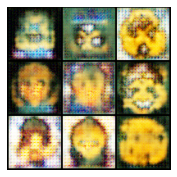

94:54
Epoch #205 / 2000, Generator Loss: 2.727633476257324, Discriminator Loss: -29.49459457397461
Epoch #206 / 2000, Generator Loss: 2.15606427192688, Discriminator Loss: -23.17557716369629
Epoch #207 / 2000, Generator Loss: 0.31034189462661743, Discriminator Loss: -24.609725952148438
Epoch #208 / 2000, Generator Loss: 4.065220832824707, Discriminator Loss: -28.36088752746582
Generated images for Epoch #208:


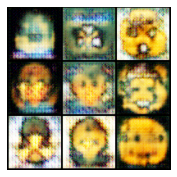

96:42
Epoch #209 / 2000, Generator Loss: 6.311020851135254, Discriminator Loss: -18.02849006652832
Epoch #210 / 2000, Generator Loss: 5.7636823654174805, Discriminator Loss: -30.104785919189453
Epoch #211 / 2000, Generator Loss: 4.395869731903076, Discriminator Loss: -27.96381378173828
Epoch #212 / 2000, Generator Loss: 0.07436241954565048, Discriminator Loss: -26.971355438232422
Generated images for Epoch #212:


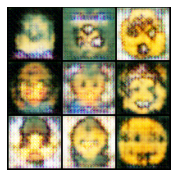

98:31
Epoch #213 / 2000, Generator Loss: 5.079864978790283, Discriminator Loss: -28.540103912353516
Epoch #214 / 2000, Generator Loss: 1.8599145412445068, Discriminator Loss: -30.305200576782227
Epoch #215 / 2000, Generator Loss: 4.282905578613281, Discriminator Loss: -28.46768569946289
Epoch #216 / 2000, Generator Loss: 2.3212594985961914, Discriminator Loss: -25.4310302734375
Generated images for Epoch #216:


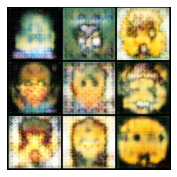

100:20
Epoch #217 / 2000, Generator Loss: 5.977406978607178, Discriminator Loss: -25.853029251098633
Epoch #218 / 2000, Generator Loss: 3.043978214263916, Discriminator Loss: -24.106369018554688
Epoch #219 / 2000, Generator Loss: 3.91117000579834, Discriminator Loss: -21.124813079833984
Epoch #220 / 2000, Generator Loss: 2.8452370166778564, Discriminator Loss: -31.796327590942383
Generated images for Epoch #220:


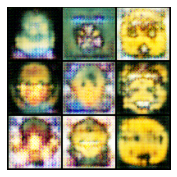

102:08
Epoch #221 / 2000, Generator Loss: 5.125007629394531, Discriminator Loss: -30.689075469970703
Epoch #222 / 2000, Generator Loss: 4.216577529907227, Discriminator Loss: -29.121030807495117
Epoch #223 / 2000, Generator Loss: 5.29494571685791, Discriminator Loss: -27.479774475097656
Epoch #224 / 2000, Generator Loss: 2.60276198387146, Discriminator Loss: -33.43565368652344
Generated images for Epoch #224:


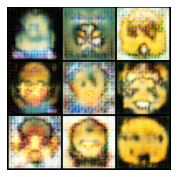

103:57
Epoch #225 / 2000, Generator Loss: 2.442023992538452, Discriminator Loss: -27.625656127929688
Epoch #226 / 2000, Generator Loss: 6.439181804656982, Discriminator Loss: -24.907405853271484
Epoch #227 / 2000, Generator Loss: 4.725215435028076, Discriminator Loss: -30.19232177734375
Epoch #228 / 2000, Generator Loss: -0.08177247643470764, Discriminator Loss: -30.299911499023438
Generated images for Epoch #228:


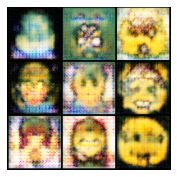

105:46
Epoch #229 / 2000, Generator Loss: 5.419327735900879, Discriminator Loss: -29.60126495361328
Epoch #230 / 2000, Generator Loss: 4.340127468109131, Discriminator Loss: -26.83791160583496
Epoch #231 / 2000, Generator Loss: 6.4450178146362305, Discriminator Loss: -27.498558044433594
Epoch #232 / 2000, Generator Loss: 1.4782131910324097, Discriminator Loss: -23.985273361206055
Generated images for Epoch #232:


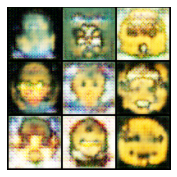

107:35
Epoch #233 / 2000, Generator Loss: 7.419754981994629, Discriminator Loss: -31.195096969604492
Epoch #234 / 2000, Generator Loss: 3.114452362060547, Discriminator Loss: -25.029277801513672
Epoch #235 / 2000, Generator Loss: 6.076961517333984, Discriminator Loss: -30.095062255859375
Epoch #236 / 2000, Generator Loss: -0.4821382761001587, Discriminator Loss: -35.66616439819336
Generated images for Epoch #236:


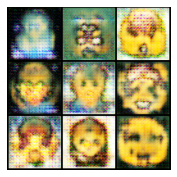

109:23
Epoch #237 / 2000, Generator Loss: 3.0378429889678955, Discriminator Loss: -28.873334884643555
Epoch #238 / 2000, Generator Loss: 1.6713732481002808, Discriminator Loss: -24.837600708007812
Epoch #239 / 2000, Generator Loss: 5.129703521728516, Discriminator Loss: -25.81686782836914
Epoch #240 / 2000, Generator Loss: 6.053114891052246, Discriminator Loss: -21.490516662597656
Generated images for Epoch #240:


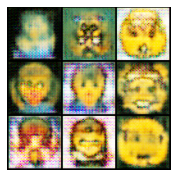

111:12
Epoch #241 / 2000, Generator Loss: 1.7774419784545898, Discriminator Loss: -27.125518798828125
Epoch #242 / 2000, Generator Loss: 1.9698560237884521, Discriminator Loss: -31.120708465576172
Epoch #243 / 2000, Generator Loss: 0.13908210396766663, Discriminator Loss: -32.146636962890625
Epoch #244 / 2000, Generator Loss: 0.7965725064277649, Discriminator Loss: -27.85112762451172
Generated images for Epoch #244:


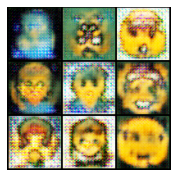

113:01
Epoch #245 / 2000, Generator Loss: 2.938920021057129, Discriminator Loss: -30.44188690185547
Epoch #246 / 2000, Generator Loss: 2.7239279747009277, Discriminator Loss: -28.743785858154297
Epoch #247 / 2000, Generator Loss: 5.787873268127441, Discriminator Loss: -32.97333908081055
Epoch #248 / 2000, Generator Loss: 5.44094181060791, Discriminator Loss: -32.99503707885742
Generated images for Epoch #248:


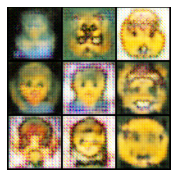

114:49
Epoch #249 / 2000, Generator Loss: 2.5334489345550537, Discriminator Loss: -26.800838470458984
Epoch #250 / 2000, Generator Loss: -0.08816171437501907, Discriminator Loss: -27.196735382080078
Epoch #251 / 2000, Generator Loss: 2.133603811264038, Discriminator Loss: -25.623992919921875
Epoch #252 / 2000, Generator Loss: 2.2582123279571533, Discriminator Loss: -30.9864501953125
Generated images for Epoch #252:


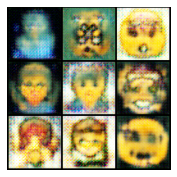

116:39
Epoch #253 / 2000, Generator Loss: 5.225799560546875, Discriminator Loss: -26.93956184387207
Epoch #254 / 2000, Generator Loss: 1.0472164154052734, Discriminator Loss: -26.5843448638916
Epoch #255 / 2000, Generator Loss: 4.495687007904053, Discriminator Loss: -27.313121795654297
Epoch #256 / 2000, Generator Loss: 3.4280474185943604, Discriminator Loss: -27.396608352661133
Generated images for Epoch #256:


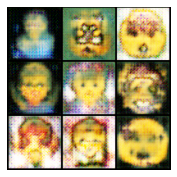

118:28
Epoch #257 / 2000, Generator Loss: 1.928073525428772, Discriminator Loss: -24.45005226135254
Epoch #258 / 2000, Generator Loss: 3.398439407348633, Discriminator Loss: -25.955793380737305
Epoch #259 / 2000, Generator Loss: 5.235309600830078, Discriminator Loss: -27.7568359375
Epoch #260 / 2000, Generator Loss: 4.937692642211914, Discriminator Loss: -25.57607650756836
Generated images for Epoch #260:


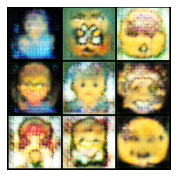

120:16
Epoch #261 / 2000, Generator Loss: 4.906507968902588, Discriminator Loss: -29.336631774902344
Epoch #262 / 2000, Generator Loss: 5.852750778198242, Discriminator Loss: -23.722793579101562
Epoch #263 / 2000, Generator Loss: 0.3366203308105469, Discriminator Loss: -24.357404708862305
Epoch #264 / 2000, Generator Loss: 3.5149288177490234, Discriminator Loss: -28.021495819091797
Generated images for Epoch #264:


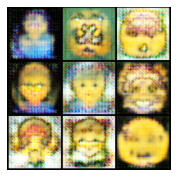

122:05
Epoch #265 / 2000, Generator Loss: 0.27244776487350464, Discriminator Loss: -26.765823364257812
Epoch #266 / 2000, Generator Loss: 3.6359245777130127, Discriminator Loss: -27.94070053100586
Epoch #267 / 2000, Generator Loss: 5.235573768615723, Discriminator Loss: -26.04281234741211
Epoch #268 / 2000, Generator Loss: 0.6622856855392456, Discriminator Loss: -21.51758575439453
Generated images for Epoch #268:


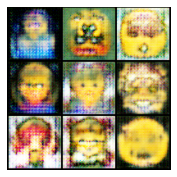

123:54
Epoch #269 / 2000, Generator Loss: 4.352850914001465, Discriminator Loss: -26.854835510253906
Epoch #270 / 2000, Generator Loss: 1.0769221782684326, Discriminator Loss: -23.880542755126953
Epoch #271 / 2000, Generator Loss: 3.8848507404327393, Discriminator Loss: -25.276390075683594
Epoch #272 / 2000, Generator Loss: 2.740245819091797, Discriminator Loss: -27.07875633239746
Generated images for Epoch #272:


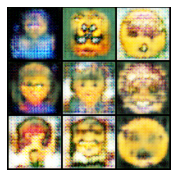

125:43
Epoch #273 / 2000, Generator Loss: 1.7015336751937866, Discriminator Loss: -28.383594512939453
Epoch #274 / 2000, Generator Loss: 2.764404296875, Discriminator Loss: -29.067913055419922
Epoch #275 / 2000, Generator Loss: 2.3990681171417236, Discriminator Loss: -26.988903045654297
Epoch #276 / 2000, Generator Loss: 3.719957113265991, Discriminator Loss: -27.103801727294922
Generated images for Epoch #276:


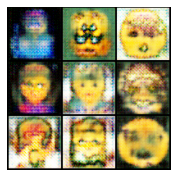

127:31
Epoch #277 / 2000, Generator Loss: 4.201454162597656, Discriminator Loss: -22.242748260498047
Epoch #278 / 2000, Generator Loss: 2.0840656757354736, Discriminator Loss: -27.415916442871094
Epoch #279 / 2000, Generator Loss: 2.5090250968933105, Discriminator Loss: -26.18994903564453
Epoch #280 / 2000, Generator Loss: 2.0371358394622803, Discriminator Loss: -25.504318237304688
Generated images for Epoch #280:


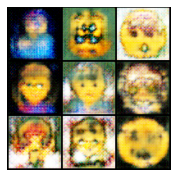

129:20
Epoch #281 / 2000, Generator Loss: 3.1797876358032227, Discriminator Loss: -25.221126556396484
Epoch #282 / 2000, Generator Loss: 3.153796672821045, Discriminator Loss: -27.276460647583008
Epoch #283 / 2000, Generator Loss: 2.1793413162231445, Discriminator Loss: -24.94388198852539
Epoch #284 / 2000, Generator Loss: 2.234145402908325, Discriminator Loss: -22.73598861694336
Generated images for Epoch #284:


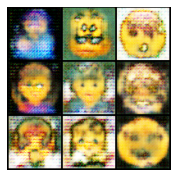

131:09
Epoch #285 / 2000, Generator Loss: 2.8640859127044678, Discriminator Loss: -25.227962493896484
Epoch #286 / 2000, Generator Loss: 3.759035348892212, Discriminator Loss: -28.71893310546875
Epoch #287 / 2000, Generator Loss: 1.3597805500030518, Discriminator Loss: -21.816295623779297
Epoch #288 / 2000, Generator Loss: 3.039602756500244, Discriminator Loss: -27.74770736694336
Generated images for Epoch #288:


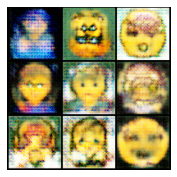

132:57
Epoch #289 / 2000, Generator Loss: 1.3325872421264648, Discriminator Loss: -26.66472625732422
Epoch #290 / 2000, Generator Loss: 2.9884109497070312, Discriminator Loss: -28.678050994873047
Epoch #291 / 2000, Generator Loss: 0.7685708403587341, Discriminator Loss: -20.907747268676758
Epoch #292 / 2000, Generator Loss: 0.9252408742904663, Discriminator Loss: -22.790935516357422
Generated images for Epoch #292:


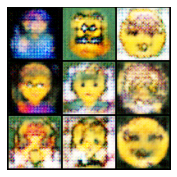

134:46
Epoch #293 / 2000, Generator Loss: 2.3405380249023438, Discriminator Loss: -24.468915939331055
Epoch #294 / 2000, Generator Loss: 2.8711376190185547, Discriminator Loss: -23.6124267578125
Epoch #295 / 2000, Generator Loss: 1.300356388092041, Discriminator Loss: -27.728866577148438
Epoch #296 / 2000, Generator Loss: 0.9416577816009521, Discriminator Loss: -23.695056915283203
Generated images for Epoch #296:


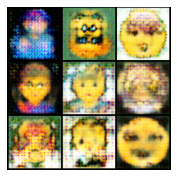

136:35
Epoch #297 / 2000, Generator Loss: 5.172027587890625, Discriminator Loss: -31.75210189819336
Epoch #298 / 2000, Generator Loss: 0.3792012333869934, Discriminator Loss: -26.84929084777832
Epoch #299 / 2000, Generator Loss: 2.3179104328155518, Discriminator Loss: -22.4006404876709
Epoch #300 / 2000, Generator Loss: 3.1783788204193115, Discriminator Loss: -30.761322021484375
Generated images for Epoch #300:


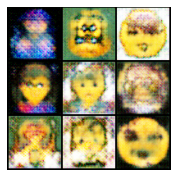

138:23
Epoch #301 / 2000, Generator Loss: 2.9635472297668457, Discriminator Loss: -24.23358917236328
Epoch #302 / 2000, Generator Loss: -0.8903889656066895, Discriminator Loss: -24.01821517944336
Epoch #303 / 2000, Generator Loss: 4.006382942199707, Discriminator Loss: -28.138202667236328
Epoch #304 / 2000, Generator Loss: 2.388993740081787, Discriminator Loss: -23.78374671936035
Generated images for Epoch #304:


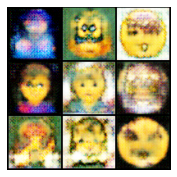

140:12
Epoch #305 / 2000, Generator Loss: 3.943488359451294, Discriminator Loss: -26.99974822998047
Epoch #306 / 2000, Generator Loss: 4.278962135314941, Discriminator Loss: -27.047550201416016
Epoch #307 / 2000, Generator Loss: 2.1301798820495605, Discriminator Loss: -29.097980499267578
Epoch #308 / 2000, Generator Loss: 2.020273208618164, Discriminator Loss: -29.023225784301758
Generated images for Epoch #308:


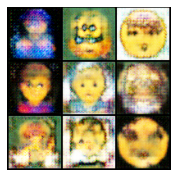

142:01
Epoch #309 / 2000, Generator Loss: 1.983970046043396, Discriminator Loss: -22.165897369384766
Epoch #310 / 2000, Generator Loss: 2.301882266998291, Discriminator Loss: -21.213821411132812
Epoch #311 / 2000, Generator Loss: 1.1210010051727295, Discriminator Loss: -25.42788314819336
Epoch #312 / 2000, Generator Loss: 0.6832610368728638, Discriminator Loss: -28.005464553833008
Generated images for Epoch #312:


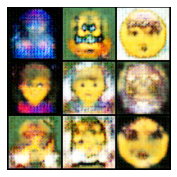

143:50
Epoch #313 / 2000, Generator Loss: 4.075989723205566, Discriminator Loss: -19.7518310546875
Epoch #314 / 2000, Generator Loss: 2.3580236434936523, Discriminator Loss: -25.691036224365234
Epoch #315 / 2000, Generator Loss: -0.682074785232544, Discriminator Loss: -28.040369033813477
Epoch #316 / 2000, Generator Loss: 1.5987908840179443, Discriminator Loss: -26.300827026367188
Generated images for Epoch #316:


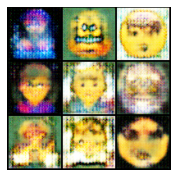

145:39
Epoch #317 / 2000, Generator Loss: 2.6232173442840576, Discriminator Loss: -23.975570678710938
Epoch #318 / 2000, Generator Loss: 4.0350871086120605, Discriminator Loss: -25.3884334564209
Epoch #319 / 2000, Generator Loss: 2.6657330989837646, Discriminator Loss: -22.02132225036621
Epoch #320 / 2000, Generator Loss: 1.1419689655303955, Discriminator Loss: -24.0482177734375
Generated images for Epoch #320:


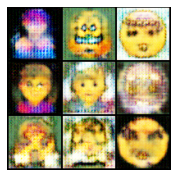

147:28
Epoch #321 / 2000, Generator Loss: -1.5856878757476807, Discriminator Loss: -23.88238525390625
Epoch #322 / 2000, Generator Loss: 3.474713087081909, Discriminator Loss: -22.042545318603516
Epoch #323 / 2000, Generator Loss: 1.265082836151123, Discriminator Loss: -22.271459579467773
Epoch #324 / 2000, Generator Loss: 2.244893789291382, Discriminator Loss: -21.833377838134766
Generated images for Epoch #324:


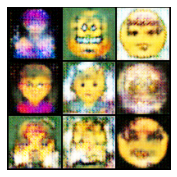

149:17
Epoch #325 / 2000, Generator Loss: -0.15121763944625854, Discriminator Loss: -26.174400329589844
Epoch #326 / 2000, Generator Loss: 3.984734535217285, Discriminator Loss: -25.024349212646484
Epoch #327 / 2000, Generator Loss: 0.8505740165710449, Discriminator Loss: -28.356307983398438
Epoch #328 / 2000, Generator Loss: 1.643442153930664, Discriminator Loss: -25.499916076660156
Generated images for Epoch #328:


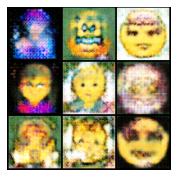

151:06
Epoch #329 / 2000, Generator Loss: 3.7873172760009766, Discriminator Loss: -25.230026245117188
Epoch #330 / 2000, Generator Loss: 2.176701307296753, Discriminator Loss: -26.734840393066406
Epoch #331 / 2000, Generator Loss: 2.5671279430389404, Discriminator Loss: -28.950654983520508
Epoch #332 / 2000, Generator Loss: 1.5873353481292725, Discriminator Loss: -24.008146286010742
Generated images for Epoch #332:


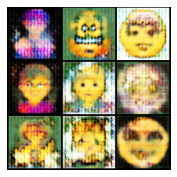

152:55
Epoch #333 / 2000, Generator Loss: 4.06845235824585, Discriminator Loss: -26.105648040771484
Epoch #334 / 2000, Generator Loss: 3.396559953689575, Discriminator Loss: -23.610097885131836
Epoch #335 / 2000, Generator Loss: 1.5439119338989258, Discriminator Loss: -28.20587921142578
Epoch #336 / 2000, Generator Loss: 0.7565388679504395, Discriminator Loss: -19.715486526489258
Generated images for Epoch #336:


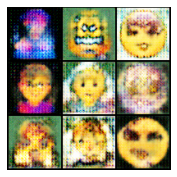

154:43
Epoch #337 / 2000, Generator Loss: 2.167168617248535, Discriminator Loss: -22.290781021118164
Epoch #338 / 2000, Generator Loss: 0.886567234992981, Discriminator Loss: -27.448097229003906
Epoch #339 / 2000, Generator Loss: 1.237831473350525, Discriminator Loss: -23.915699005126953
Epoch #340 / 2000, Generator Loss: 3.1838455200195312, Discriminator Loss: -24.388296127319336
Generated images for Epoch #340:


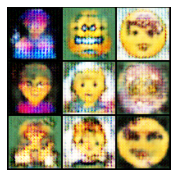

156:32
Epoch #341 / 2000, Generator Loss: -1.29099702835083, Discriminator Loss: -22.835424423217773
Epoch #342 / 2000, Generator Loss: 1.6107311248779297, Discriminator Loss: -24.875673294067383
Epoch #343 / 2000, Generator Loss: 1.5089651346206665, Discriminator Loss: -28.374507904052734
Epoch #344 / 2000, Generator Loss: 0.574368417263031, Discriminator Loss: -29.929676055908203
Generated images for Epoch #344:


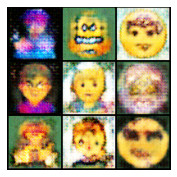

158:21
Epoch #345 / 2000, Generator Loss: 1.8736299276351929, Discriminator Loss: -25.462322235107422
Epoch #346 / 2000, Generator Loss: 2.157416343688965, Discriminator Loss: -21.93911361694336
Epoch #347 / 2000, Generator Loss: 4.071987152099609, Discriminator Loss: -23.444612503051758
Epoch #348 / 2000, Generator Loss: -0.6905853748321533, Discriminator Loss: -21.9987735748291
Generated images for Epoch #348:


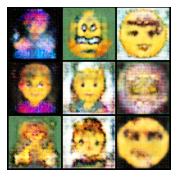

160:10
Epoch #349 / 2000, Generator Loss: 0.41342782974243164, Discriminator Loss: -23.44292640686035
Epoch #350 / 2000, Generator Loss: 2.5420076847076416, Discriminator Loss: -26.583866119384766
Epoch #351 / 2000, Generator Loss: 2.572021961212158, Discriminator Loss: -22.2800235748291
Epoch #352 / 2000, Generator Loss: 2.4209699630737305, Discriminator Loss: -24.828384399414062
Generated images for Epoch #352:


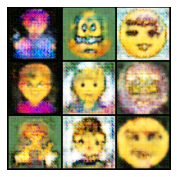

161:58
Epoch #353 / 2000, Generator Loss: -1.0911407470703125, Discriminator Loss: -28.780811309814453
Epoch #354 / 2000, Generator Loss: 0.2850407660007477, Discriminator Loss: -22.106388092041016
Epoch #355 / 2000, Generator Loss: 3.456303119659424, Discriminator Loss: -22.400381088256836
Epoch #356 / 2000, Generator Loss: 2.0484166145324707, Discriminator Loss: -22.534101486206055
Generated images for Epoch #356:


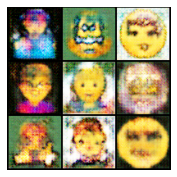

163:47
Epoch #357 / 2000, Generator Loss: 1.3525651693344116, Discriminator Loss: -26.93255615234375
Epoch #358 / 2000, Generator Loss: 0.934727132320404, Discriminator Loss: -25.208284378051758
Epoch #359 / 2000, Generator Loss: 0.3914874792098999, Discriminator Loss: -25.645755767822266
Epoch #360 / 2000, Generator Loss: 3.368382692337036, Discriminator Loss: -26.4952335357666
Generated images for Epoch #360:


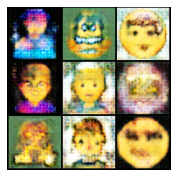

165:36
Epoch #361 / 2000, Generator Loss: 1.1148276329040527, Discriminator Loss: -25.248859405517578
Epoch #362 / 2000, Generator Loss: 2.551286220550537, Discriminator Loss: -26.02253532409668
Epoch #363 / 2000, Generator Loss: 1.9344435930252075, Discriminator Loss: -18.979955673217773
Epoch #364 / 2000, Generator Loss: 2.783853054046631, Discriminator Loss: -24.75759506225586
Generated images for Epoch #364:


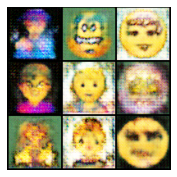

167:24
Epoch #365 / 2000, Generator Loss: 1.1297028064727783, Discriminator Loss: -22.806961059570312
Epoch #366 / 2000, Generator Loss: 1.0526025295257568, Discriminator Loss: -24.606895446777344
Epoch #367 / 2000, Generator Loss: 1.0823839902877808, Discriminator Loss: -21.277809143066406
Epoch #368 / 2000, Generator Loss: 2.8213624954223633, Discriminator Loss: -23.121002197265625
Generated images for Epoch #368:


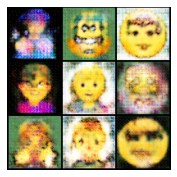

169:14
Epoch #369 / 2000, Generator Loss: 1.5098843574523926, Discriminator Loss: -23.121963500976562
Epoch #370 / 2000, Generator Loss: 0.2783321738243103, Discriminator Loss: -23.65439224243164
Epoch #371 / 2000, Generator Loss: 0.8329154253005981, Discriminator Loss: -21.263700485229492
Epoch #372 / 2000, Generator Loss: 3.577655553817749, Discriminator Loss: -26.085113525390625
Generated images for Epoch #372:


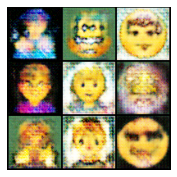

171:04
Epoch #373 / 2000, Generator Loss: 2.370584726333618, Discriminator Loss: -27.408151626586914
Epoch #374 / 2000, Generator Loss: -1.490669846534729, Discriminator Loss: -23.201826095581055
Epoch #375 / 2000, Generator Loss: 1.3722494840621948, Discriminator Loss: -25.811344146728516
Epoch #376 / 2000, Generator Loss: 4.614373207092285, Discriminator Loss: -19.356416702270508
Generated images for Epoch #376:


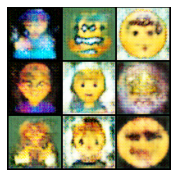

172:53
Epoch #377 / 2000, Generator Loss: 3.2007973194122314, Discriminator Loss: -25.583009719848633
Epoch #378 / 2000, Generator Loss: 2.5388152599334717, Discriminator Loss: -23.701929092407227
Epoch #379 / 2000, Generator Loss: 1.07365882396698, Discriminator Loss: -26.568790435791016
Epoch #380 / 2000, Generator Loss: 4.367495536804199, Discriminator Loss: -23.318950653076172
Generated images for Epoch #380:


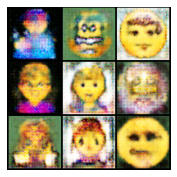

174:42
Epoch #381 / 2000, Generator Loss: 2.3372416496276855, Discriminator Loss: -26.046735763549805
Epoch #382 / 2000, Generator Loss: 0.34818515181541443, Discriminator Loss: -20.440155029296875
Epoch #383 / 2000, Generator Loss: 3.647935390472412, Discriminator Loss: -21.177120208740234
Epoch #384 / 2000, Generator Loss: 0.5742770433425903, Discriminator Loss: -27.4854736328125
Generated images for Epoch #384:


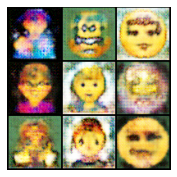

176:31
Epoch #385 / 2000, Generator Loss: 1.7801506519317627, Discriminator Loss: -22.433486938476562
Epoch #386 / 2000, Generator Loss: 3.368633270263672, Discriminator Loss: -25.698341369628906
Epoch #387 / 2000, Generator Loss: 2.452564001083374, Discriminator Loss: -20.657211303710938
Epoch #388 / 2000, Generator Loss: 3.209244728088379, Discriminator Loss: -21.25861358642578
Generated images for Epoch #388:


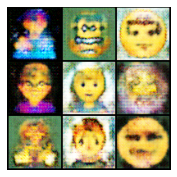

178:20
Epoch #389 / 2000, Generator Loss: 0.21675045788288116, Discriminator Loss: -21.5246524810791
Epoch #390 / 2000, Generator Loss: 2.791489601135254, Discriminator Loss: -23.689449310302734
Epoch #391 / 2000, Generator Loss: 2.18493390083313, Discriminator Loss: -21.466556549072266
Epoch #392 / 2000, Generator Loss: 3.7637243270874023, Discriminator Loss: -28.94167137145996
Generated images for Epoch #392:


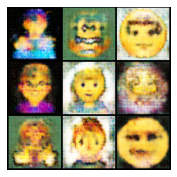

180:09
Epoch #393 / 2000, Generator Loss: 0.6587547659873962, Discriminator Loss: -23.62122344970703
Epoch #394 / 2000, Generator Loss: -0.1815592348575592, Discriminator Loss: -26.394840240478516
Epoch #395 / 2000, Generator Loss: 0.4361206889152527, Discriminator Loss: -24.036407470703125
Epoch #396 / 2000, Generator Loss: 4.06304931640625, Discriminator Loss: -23.44578742980957
Generated images for Epoch #396:


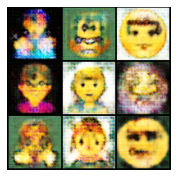

181:58
Epoch #397 / 2000, Generator Loss: 1.3678703308105469, Discriminator Loss: -23.558265686035156
Epoch #398 / 2000, Generator Loss: 1.4465281963348389, Discriminator Loss: -26.24600601196289
Epoch #399 / 2000, Generator Loss: -0.3318468928337097, Discriminator Loss: -24.204381942749023
Epoch #400 / 2000, Generator Loss: 3.111748218536377, Discriminator Loss: -25.255895614624023
Generated images for Epoch #400:


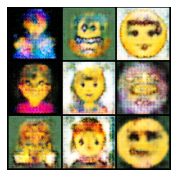

183:47
Epoch #401 / 2000, Generator Loss: 3.2218239307403564, Discriminator Loss: -19.83560562133789
Epoch #402 / 2000, Generator Loss: 3.4813621044158936, Discriminator Loss: -27.592002868652344
Epoch #403 / 2000, Generator Loss: 1.8687801361083984, Discriminator Loss: -28.791746139526367
Epoch #404 / 2000, Generator Loss: 0.545509934425354, Discriminator Loss: -25.997034072875977
Generated images for Epoch #404:


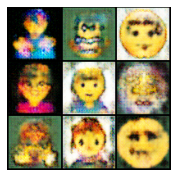

185:37
Epoch #405 / 2000, Generator Loss: 1.7637417316436768, Discriminator Loss: -22.188989639282227
Epoch #406 / 2000, Generator Loss: 2.33286714553833, Discriminator Loss: -25.12298583984375
Epoch #407 / 2000, Generator Loss: 0.9602764844894409, Discriminator Loss: -26.321571350097656
Epoch #408 / 2000, Generator Loss: -0.8757396936416626, Discriminator Loss: -22.926414489746094
Generated images for Epoch #408:


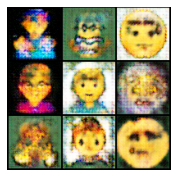

187:26
Epoch #409 / 2000, Generator Loss: 2.6413559913635254, Discriminator Loss: -29.82223892211914
Epoch #410 / 2000, Generator Loss: -0.10308544337749481, Discriminator Loss: -23.428512573242188
Epoch #411 / 2000, Generator Loss: 2.04537296295166, Discriminator Loss: -20.040706634521484
Epoch #412 / 2000, Generator Loss: -0.0583028644323349, Discriminator Loss: -22.40811538696289
Generated images for Epoch #412:


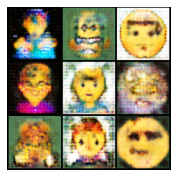

189:15
Epoch #413 / 2000, Generator Loss: 2.1715247631073, Discriminator Loss: -23.704132080078125
Epoch #414 / 2000, Generator Loss: 1.960557460784912, Discriminator Loss: -22.460250854492188
Epoch #415 / 2000, Generator Loss: -0.6771187782287598, Discriminator Loss: -23.288681030273438
Epoch #416 / 2000, Generator Loss: 1.1778284311294556, Discriminator Loss: -21.15338897705078
Generated images for Epoch #416:


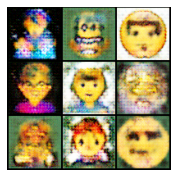

191:04
Epoch #417 / 2000, Generator Loss: 2.6727657318115234, Discriminator Loss: -23.563596725463867
Epoch #418 / 2000, Generator Loss: 1.1933646202087402, Discriminator Loss: -22.146255493164062
Epoch #419 / 2000, Generator Loss: 1.313270092010498, Discriminator Loss: -24.0970401763916
Epoch #420 / 2000, Generator Loss: 1.2636725902557373, Discriminator Loss: -20.465171813964844
Generated images for Epoch #420:


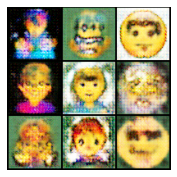

192:53
Epoch #421 / 2000, Generator Loss: 0.7403239011764526, Discriminator Loss: -23.748310089111328
Epoch #422 / 2000, Generator Loss: -0.5071443915367126, Discriminator Loss: -21.909849166870117
Epoch #423 / 2000, Generator Loss: 2.1543314456939697, Discriminator Loss: -25.366661071777344
Epoch #424 / 2000, Generator Loss: 3.2021584510803223, Discriminator Loss: -24.834339141845703
Generated images for Epoch #424:


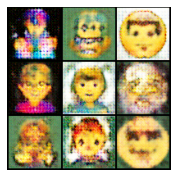

194:42
Epoch #425 / 2000, Generator Loss: 0.5268374681472778, Discriminator Loss: -24.773313522338867
Epoch #426 / 2000, Generator Loss: 0.7390146851539612, Discriminator Loss: -23.51030731201172
Epoch #427 / 2000, Generator Loss: -0.36685580015182495, Discriminator Loss: -24.02166175842285
Epoch #428 / 2000, Generator Loss: 2.4143879413604736, Discriminator Loss: -26.87948989868164
Generated images for Epoch #428:


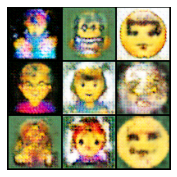

196:32
Epoch #429 / 2000, Generator Loss: 1.2252768278121948, Discriminator Loss: -22.303800582885742
Epoch #430 / 2000, Generator Loss: 0.1308356523513794, Discriminator Loss: -21.714466094970703
Epoch #431 / 2000, Generator Loss: 2.342517614364624, Discriminator Loss: -23.063312530517578
Epoch #432 / 2000, Generator Loss: 0.7620877027511597, Discriminator Loss: -21.881492614746094
Generated images for Epoch #432:


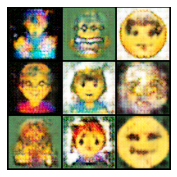

198:21
Epoch #433 / 2000, Generator Loss: 2.3922455310821533, Discriminator Loss: -27.33855438232422
Epoch #434 / 2000, Generator Loss: -1.8438522815704346, Discriminator Loss: -27.749298095703125
Epoch #435 / 2000, Generator Loss: 3.2432799339294434, Discriminator Loss: -21.680862426757812
Epoch #436 / 2000, Generator Loss: 2.1144065856933594, Discriminator Loss: -24.333444595336914
Generated images for Epoch #436:


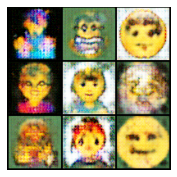

200:11
Epoch #437 / 2000, Generator Loss: 2.4058713912963867, Discriminator Loss: -22.433185577392578
Epoch #438 / 2000, Generator Loss: 3.0841469764709473, Discriminator Loss: -27.328350067138672
Epoch #439 / 2000, Generator Loss: 0.20941653847694397, Discriminator Loss: -23.419918060302734
Epoch #440 / 2000, Generator Loss: 1.705498218536377, Discriminator Loss: -25.553691864013672
Generated images for Epoch #440:


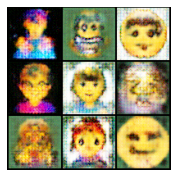

202:00
Epoch #441 / 2000, Generator Loss: 3.0699238777160645, Discriminator Loss: -25.641910552978516
Epoch #442 / 2000, Generator Loss: 1.8323454856872559, Discriminator Loss: -23.13869285583496
Epoch #443 / 2000, Generator Loss: 2.024088144302368, Discriminator Loss: -19.4168701171875
Epoch #444 / 2000, Generator Loss: 2.5778868198394775, Discriminator Loss: -25.85323715209961
Generated images for Epoch #444:


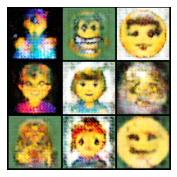

203:49
Epoch #445 / 2000, Generator Loss: 1.8346705436706543, Discriminator Loss: -24.57200050354004
Epoch #446 / 2000, Generator Loss: -0.1475006639957428, Discriminator Loss: -23.685863494873047
Epoch #447 / 2000, Generator Loss: 1.0830342769622803, Discriminator Loss: -24.380929946899414
Epoch #448 / 2000, Generator Loss: 3.1648030281066895, Discriminator Loss: -27.30634307861328
Generated images for Epoch #448:


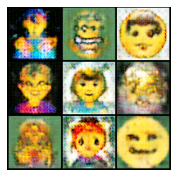

205:39
Epoch #449 / 2000, Generator Loss: 1.1097476482391357, Discriminator Loss: -27.401458740234375
Epoch #450 / 2000, Generator Loss: 1.4864888191223145, Discriminator Loss: -22.281490325927734
Epoch #451 / 2000, Generator Loss: 0.011484354734420776, Discriminator Loss: -27.47081184387207
Epoch #452 / 2000, Generator Loss: 1.4823822975158691, Discriminator Loss: -24.313377380371094
Generated images for Epoch #452:


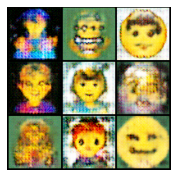

207:28
Epoch #453 / 2000, Generator Loss: 1.607995867729187, Discriminator Loss: -24.086944580078125
Epoch #454 / 2000, Generator Loss: 1.1796338558197021, Discriminator Loss: -25.87281036376953
Epoch #455 / 2000, Generator Loss: 1.0460724830627441, Discriminator Loss: -24.23571014404297
Epoch #456 / 2000, Generator Loss: 0.44747278094291687, Discriminator Loss: -24.81456756591797
Generated images for Epoch #456:


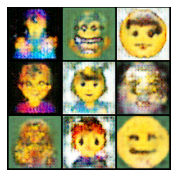

209:18
Epoch #457 / 2000, Generator Loss: 3.0192372798919678, Discriminator Loss: -22.607196807861328
Epoch #458 / 2000, Generator Loss: 2.8926782608032227, Discriminator Loss: -23.742324829101562
Epoch #459 / 2000, Generator Loss: 1.4075398445129395, Discriminator Loss: -21.567155838012695
Epoch #460 / 2000, Generator Loss: 2.2397189140319824, Discriminator Loss: -23.26177215576172
Generated images for Epoch #460:


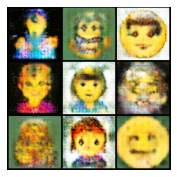

211:07
Epoch #461 / 2000, Generator Loss: 2.3820104598999023, Discriminator Loss: -24.86337661743164
Epoch #462 / 2000, Generator Loss: 1.1146857738494873, Discriminator Loss: -24.29189682006836
Epoch #463 / 2000, Generator Loss: 2.394456386566162, Discriminator Loss: -30.125167846679688
Epoch #464 / 2000, Generator Loss: 2.6620683670043945, Discriminator Loss: -23.98573875427246
Generated images for Epoch #464:


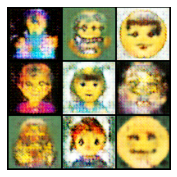

212:57
Epoch #465 / 2000, Generator Loss: 2.5283472537994385, Discriminator Loss: -22.49237060546875
Epoch #466 / 2000, Generator Loss: 2.9292173385620117, Discriminator Loss: -23.09149932861328
Epoch #467 / 2000, Generator Loss: 5.144879341125488, Discriminator Loss: -26.494613647460938
Epoch #468 / 2000, Generator Loss: 3.8740944862365723, Discriminator Loss: -21.629728317260742
Generated images for Epoch #468:


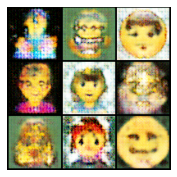

214:46
Epoch #469 / 2000, Generator Loss: 3.7542834281921387, Discriminator Loss: -24.744293212890625
Epoch #470 / 2000, Generator Loss: 3.8846943378448486, Discriminator Loss: -28.560302734375
Epoch #471 / 2000, Generator Loss: 3.9385199546813965, Discriminator Loss: -26.344249725341797
Epoch #472 / 2000, Generator Loss: 1.966977834701538, Discriminator Loss: -24.15703010559082
Generated images for Epoch #472:


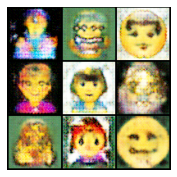

216:36
Epoch #473 / 2000, Generator Loss: 0.6546624898910522, Discriminator Loss: -24.00047492980957
Epoch #474 / 2000, Generator Loss: 5.076369285583496, Discriminator Loss: -25.572612762451172
Epoch #475 / 2000, Generator Loss: 4.262826919555664, Discriminator Loss: -24.680994033813477
Epoch #476 / 2000, Generator Loss: 1.370701789855957, Discriminator Loss: -27.375932693481445
Generated images for Epoch #476:


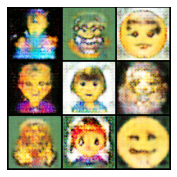

218:25
Epoch #477 / 2000, Generator Loss: 1.109690546989441, Discriminator Loss: -24.875728607177734
Epoch #478 / 2000, Generator Loss: 4.502921104431152, Discriminator Loss: -24.209766387939453
Epoch #479 / 2000, Generator Loss: 3.534297466278076, Discriminator Loss: -21.313552856445312
Epoch #480 / 2000, Generator Loss: 2.532339572906494, Discriminator Loss: -20.53011131286621
Generated images for Epoch #480:


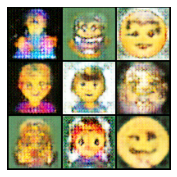

220:15
Epoch #481 / 2000, Generator Loss: 1.7155970335006714, Discriminator Loss: -27.895517349243164
Epoch #482 / 2000, Generator Loss: 3.3710687160491943, Discriminator Loss: -24.46282386779785
Epoch #483 / 2000, Generator Loss: 2.208411455154419, Discriminator Loss: -21.918514251708984
Epoch #484 / 2000, Generator Loss: 4.24895715713501, Discriminator Loss: -24.225919723510742
Generated images for Epoch #484:


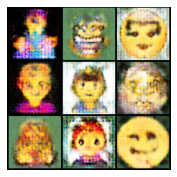

222:04
Epoch #485 / 2000, Generator Loss: 2.282336711883545, Discriminator Loss: -20.3983154296875
Epoch #486 / 2000, Generator Loss: 2.279356002807617, Discriminator Loss: -25.069072723388672
Epoch #487 / 2000, Generator Loss: 2.5349576473236084, Discriminator Loss: -21.184123992919922
Epoch #488 / 2000, Generator Loss: 1.3487085103988647, Discriminator Loss: -21.59041404724121
Generated images for Epoch #488:


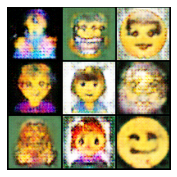

223:54
Epoch #489 / 2000, Generator Loss: 1.3736183643341064, Discriminator Loss: -23.421878814697266
Epoch #490 / 2000, Generator Loss: 2.8827996253967285, Discriminator Loss: -25.740297317504883
Epoch #491 / 2000, Generator Loss: 1.2128467559814453, Discriminator Loss: -17.34716033935547
Epoch #492 / 2000, Generator Loss: 2.299168586730957, Discriminator Loss: -22.313894271850586
Generated images for Epoch #492:


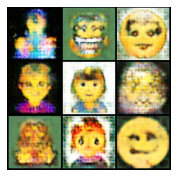

225:43
Epoch #493 / 2000, Generator Loss: 5.568701267242432, Discriminator Loss: -25.19364356994629
Epoch #494 / 2000, Generator Loss: 2.7649364471435547, Discriminator Loss: -25.91499137878418
Epoch #495 / 2000, Generator Loss: 1.3980058431625366, Discriminator Loss: -22.875682830810547
Epoch #496 / 2000, Generator Loss: 3.4138076305389404, Discriminator Loss: -29.56545066833496
Generated images for Epoch #496:


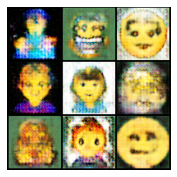

227:33
Epoch #497 / 2000, Generator Loss: 1.8844339847564697, Discriminator Loss: -24.579397201538086
Epoch #498 / 2000, Generator Loss: 3.8149333000183105, Discriminator Loss: -29.37919807434082
Epoch #499 / 2000, Generator Loss: 3.2121968269348145, Discriminator Loss: -25.8543758392334
Epoch #500 / 2000, Generator Loss: 3.164130210876465, Discriminator Loss: -25.335338592529297
Generated images for Epoch #500:


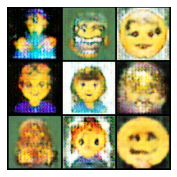

229:22
Epoch #501 / 2000, Generator Loss: 4.763726711273193, Discriminator Loss: -27.960895538330078
Epoch #502 / 2000, Generator Loss: 3.8885984420776367, Discriminator Loss: -20.453330993652344
Epoch #503 / 2000, Generator Loss: 4.946038246154785, Discriminator Loss: -25.553747177124023
Epoch #504 / 2000, Generator Loss: 4.552845478057861, Discriminator Loss: -24.918495178222656
Generated images for Epoch #504:


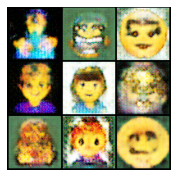

231:12
Epoch #505 / 2000, Generator Loss: 6.575711250305176, Discriminator Loss: -23.680086135864258
Epoch #506 / 2000, Generator Loss: 7.308967590332031, Discriminator Loss: -21.81361961364746
Epoch #507 / 2000, Generator Loss: 4.807024955749512, Discriminator Loss: -19.220565795898438
Epoch #508 / 2000, Generator Loss: 5.6898674964904785, Discriminator Loss: -19.061813354492188
Generated images for Epoch #508:


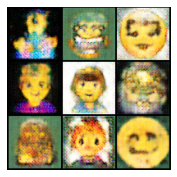

233:02
Epoch #509 / 2000, Generator Loss: 3.1937789916992188, Discriminator Loss: -21.100421905517578
Epoch #510 / 2000, Generator Loss: 2.577549934387207, Discriminator Loss: -18.83618927001953
Epoch #511 / 2000, Generator Loss: 5.670212268829346, Discriminator Loss: -21.47504425048828
Epoch #512 / 2000, Generator Loss: 4.537029266357422, Discriminator Loss: -22.892671585083008
Generated images for Epoch #512:


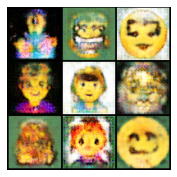

234:52
Epoch #513 / 2000, Generator Loss: 5.724107265472412, Discriminator Loss: -23.95058822631836
Epoch #514 / 2000, Generator Loss: 3.873406171798706, Discriminator Loss: -25.578086853027344
Epoch #515 / 2000, Generator Loss: 4.9914960861206055, Discriminator Loss: -25.830503463745117
Epoch #516 / 2000, Generator Loss: 3.919304370880127, Discriminator Loss: -20.2571964263916
Generated images for Epoch #516:


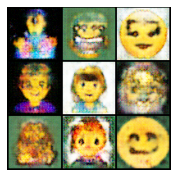

236:42
Epoch #517 / 2000, Generator Loss: 4.634099960327148, Discriminator Loss: -24.689184188842773
Epoch #518 / 2000, Generator Loss: 4.537955284118652, Discriminator Loss: -24.66189956665039
Epoch #519 / 2000, Generator Loss: 5.278887748718262, Discriminator Loss: -21.04407501220703
Epoch #520 / 2000, Generator Loss: 2.7682814598083496, Discriminator Loss: -24.523155212402344
Generated images for Epoch #520:


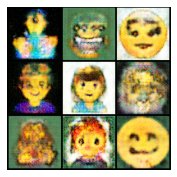

238:31
Epoch #521 / 2000, Generator Loss: 3.6967146396636963, Discriminator Loss: -27.69816780090332
Epoch #522 / 2000, Generator Loss: 5.919706344604492, Discriminator Loss: -23.424957275390625
Epoch #523 / 2000, Generator Loss: 3.316361665725708, Discriminator Loss: -25.746200561523438
Epoch #524 / 2000, Generator Loss: 4.721051216125488, Discriminator Loss: -22.08647346496582
Generated images for Epoch #524:


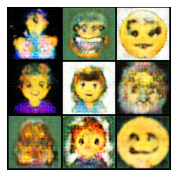

240:21
Epoch #525 / 2000, Generator Loss: 5.517591953277588, Discriminator Loss: -20.04088592529297
Epoch #526 / 2000, Generator Loss: 6.489652633666992, Discriminator Loss: -24.12389373779297
Epoch #527 / 2000, Generator Loss: 5.526240348815918, Discriminator Loss: -22.149944305419922
Epoch #528 / 2000, Generator Loss: 3.4231038093566895, Discriminator Loss: -21.670501708984375
Generated images for Epoch #528:


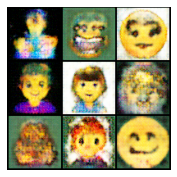

242:11
Epoch #529 / 2000, Generator Loss: 5.074764251708984, Discriminator Loss: -23.680234909057617
Epoch #530 / 2000, Generator Loss: 3.7066619396209717, Discriminator Loss: -26.83850860595703
Epoch #531 / 2000, Generator Loss: 7.399991512298584, Discriminator Loss: -21.8599853515625
Epoch #532 / 2000, Generator Loss: 4.940378189086914, Discriminator Loss: -25.841171264648438
Generated images for Epoch #532:


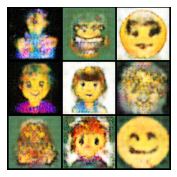

244:01
Epoch #533 / 2000, Generator Loss: 5.277038097381592, Discriminator Loss: -20.247081756591797
Epoch #534 / 2000, Generator Loss: 2.8162455558776855, Discriminator Loss: -27.371070861816406
Epoch #535 / 2000, Generator Loss: 4.728035926818848, Discriminator Loss: -24.17888832092285
Epoch #536 / 2000, Generator Loss: 3.784432888031006, Discriminator Loss: -20.735403060913086
Generated images for Epoch #536:


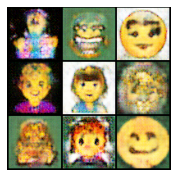

245:51
Epoch #537 / 2000, Generator Loss: 6.32781982421875, Discriminator Loss: -21.61507797241211
Epoch #538 / 2000, Generator Loss: 3.8840296268463135, Discriminator Loss: -27.797340393066406
Epoch #539 / 2000, Generator Loss: 4.557336807250977, Discriminator Loss: -27.87224578857422
Epoch #540 / 2000, Generator Loss: 3.8672146797180176, Discriminator Loss: -23.601816177368164
Generated images for Epoch #540:


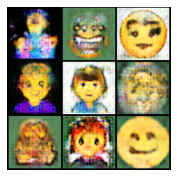

247:41
Epoch #541 / 2000, Generator Loss: 4.343804836273193, Discriminator Loss: -20.28105926513672
Epoch #542 / 2000, Generator Loss: 5.2060322761535645, Discriminator Loss: -24.45191764831543
Epoch #543 / 2000, Generator Loss: 3.58487606048584, Discriminator Loss: -27.302452087402344
Epoch #544 / 2000, Generator Loss: 5.310282230377197, Discriminator Loss: -19.57931137084961
Generated images for Epoch #544:


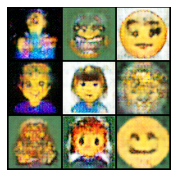

249:31
Epoch #545 / 2000, Generator Loss: 2.43806529045105, Discriminator Loss: -23.804019927978516
Epoch #546 / 2000, Generator Loss: 5.89445686340332, Discriminator Loss: -21.00644302368164
Epoch #547 / 2000, Generator Loss: 3.9885141849517822, Discriminator Loss: -20.68836212158203
Epoch #548 / 2000, Generator Loss: 5.974555492401123, Discriminator Loss: -23.43621063232422
Generated images for Epoch #548:


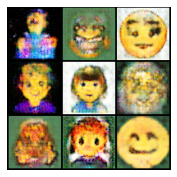

251:21
Epoch #549 / 2000, Generator Loss: 5.053812503814697, Discriminator Loss: -25.01667594909668
Epoch #550 / 2000, Generator Loss: 4.981598377227783, Discriminator Loss: -24.406679153442383
Epoch #551 / 2000, Generator Loss: 3.9029831886291504, Discriminator Loss: -20.509859085083008
Epoch #552 / 2000, Generator Loss: 6.124593734741211, Discriminator Loss: -23.718952178955078
Generated images for Epoch #552:


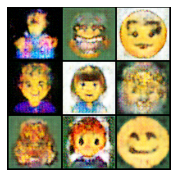

253:11
Epoch #553 / 2000, Generator Loss: 5.275906085968018, Discriminator Loss: -21.097238540649414
Epoch #554 / 2000, Generator Loss: 4.884062767028809, Discriminator Loss: -23.841854095458984
Epoch #555 / 2000, Generator Loss: 4.885812759399414, Discriminator Loss: -23.1589298248291
Epoch #556 / 2000, Generator Loss: 5.973854064941406, Discriminator Loss: -25.022483825683594
Generated images for Epoch #556:


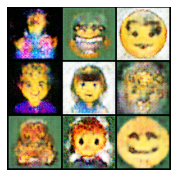

255:01
Epoch #557 / 2000, Generator Loss: 3.4219393730163574, Discriminator Loss: -26.222728729248047
Epoch #558 / 2000, Generator Loss: 6.654135704040527, Discriminator Loss: -20.414188385009766
Epoch #559 / 2000, Generator Loss: 4.006946086883545, Discriminator Loss: -21.412792205810547
Epoch #560 / 2000, Generator Loss: 6.475541114807129, Discriminator Loss: -18.035303115844727
Generated images for Epoch #560:


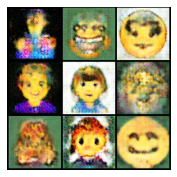

256:51
Epoch #561 / 2000, Generator Loss: 5.362017631530762, Discriminator Loss: -23.9343318939209
Epoch #562 / 2000, Generator Loss: 5.688741683959961, Discriminator Loss: -23.9366455078125
Epoch #563 / 2000, Generator Loss: 5.877374649047852, Discriminator Loss: -20.51015853881836
Epoch #564 / 2000, Generator Loss: 5.371457099914551, Discriminator Loss: -20.07278823852539
Generated images for Epoch #564:


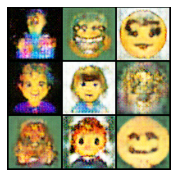

258:40
Epoch #565 / 2000, Generator Loss: 4.134449005126953, Discriminator Loss: -22.285526275634766
Epoch #566 / 2000, Generator Loss: 6.031495094299316, Discriminator Loss: -22.38399314880371
Epoch #567 / 2000, Generator Loss: 4.746495246887207, Discriminator Loss: -23.833751678466797
Epoch #568 / 2000, Generator Loss: 6.9263386726379395, Discriminator Loss: -25.20033836364746
Generated images for Epoch #568:


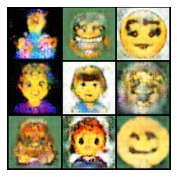

260:30
Epoch #569 / 2000, Generator Loss: 4.763401031494141, Discriminator Loss: -26.29637908935547
Epoch #570 / 2000, Generator Loss: 6.472497940063477, Discriminator Loss: -19.34195327758789
Epoch #571 / 2000, Generator Loss: 7.644972801208496, Discriminator Loss: -20.525808334350586
Epoch #572 / 2000, Generator Loss: 6.4501543045043945, Discriminator Loss: -22.675701141357422
Generated images for Epoch #572:


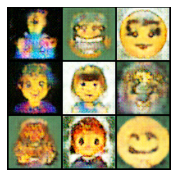

262:20
Epoch #573 / 2000, Generator Loss: 6.8349609375, Discriminator Loss: -23.024253845214844
Epoch #574 / 2000, Generator Loss: 3.872175931930542, Discriminator Loss: -27.72464942932129
Epoch #575 / 2000, Generator Loss: 5.981642723083496, Discriminator Loss: -21.95818519592285
Epoch #576 / 2000, Generator Loss: 5.014144420623779, Discriminator Loss: -25.65449333190918
Generated images for Epoch #576:


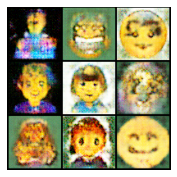

264:10
Epoch #577 / 2000, Generator Loss: 5.900437831878662, Discriminator Loss: -27.491485595703125
Epoch #578 / 2000, Generator Loss: 6.391232967376709, Discriminator Loss: -30.04974365234375
Epoch #579 / 2000, Generator Loss: 6.851765155792236, Discriminator Loss: -27.32358169555664
Epoch #580 / 2000, Generator Loss: 4.162956237792969, Discriminator Loss: -27.305953979492188
Generated images for Epoch #580:


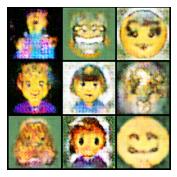

266:00
Epoch #581 / 2000, Generator Loss: 5.981611251831055, Discriminator Loss: -23.193214416503906
Epoch #582 / 2000, Generator Loss: 6.6757683753967285, Discriminator Loss: -23.16594123840332
Epoch #583 / 2000, Generator Loss: 4.5525312423706055, Discriminator Loss: -20.62119483947754
Epoch #584 / 2000, Generator Loss: 5.037937164306641, Discriminator Loss: -24.65553092956543
Generated images for Epoch #584:


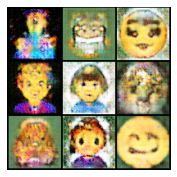

267:49
Epoch #585 / 2000, Generator Loss: 3.963275909423828, Discriminator Loss: -24.026657104492188
Epoch #586 / 2000, Generator Loss: 5.988793849945068, Discriminator Loss: -24.92325210571289
Epoch #587 / 2000, Generator Loss: 4.271306037902832, Discriminator Loss: -24.011760711669922
Epoch #588 / 2000, Generator Loss: 7.6967597007751465, Discriminator Loss: -22.993724822998047
Generated images for Epoch #588:


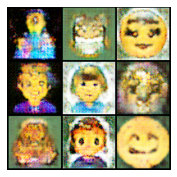

269:39
Epoch #589 / 2000, Generator Loss: 5.936148643493652, Discriminator Loss: -23.06447410583496
Epoch #590 / 2000, Generator Loss: 6.762238025665283, Discriminator Loss: -25.196537017822266
Epoch #591 / 2000, Generator Loss: 7.249233245849609, Discriminator Loss: -25.15456771850586
Epoch #592 / 2000, Generator Loss: 5.4591383934021, Discriminator Loss: -26.38096809387207
Generated images for Epoch #592:


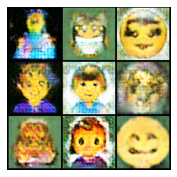

271:28
Epoch #593 / 2000, Generator Loss: 4.856330871582031, Discriminator Loss: -22.965030670166016
Epoch #594 / 2000, Generator Loss: 5.872974395751953, Discriminator Loss: -21.899433135986328
Epoch #595 / 2000, Generator Loss: 6.48095703125, Discriminator Loss: -26.436767578125
Epoch #596 / 2000, Generator Loss: 3.333131790161133, Discriminator Loss: -24.134361267089844
Generated images for Epoch #596:


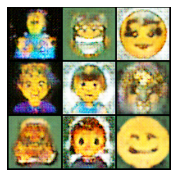

273:17
Epoch #597 / 2000, Generator Loss: 7.162849426269531, Discriminator Loss: -23.392850875854492
Epoch #598 / 2000, Generator Loss: 6.352221488952637, Discriminator Loss: -22.025676727294922
Epoch #599 / 2000, Generator Loss: 8.742252349853516, Discriminator Loss: -27.578044891357422
Epoch #600 / 2000, Generator Loss: 6.994789123535156, Discriminator Loss: -25.723583221435547
Generated images for Epoch #600:


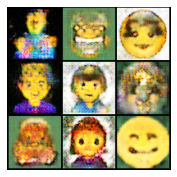

275:07
Epoch #601 / 2000, Generator Loss: 7.496166229248047, Discriminator Loss: -25.761363983154297
Epoch #602 / 2000, Generator Loss: 7.966061592102051, Discriminator Loss: -24.331439971923828
Epoch #603 / 2000, Generator Loss: 6.984081268310547, Discriminator Loss: -25.14034652709961
Epoch #604 / 2000, Generator Loss: 6.003654479980469, Discriminator Loss: -25.218914031982422
Generated images for Epoch #604:


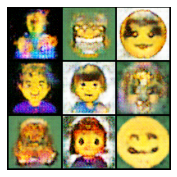

276:56
Epoch #605 / 2000, Generator Loss: 8.117802619934082, Discriminator Loss: -23.511585235595703
Epoch #606 / 2000, Generator Loss: 8.692590713500977, Discriminator Loss: -23.383560180664062
Epoch #607 / 2000, Generator Loss: 7.7900519371032715, Discriminator Loss: -25.93829345703125
Epoch #608 / 2000, Generator Loss: 7.472919940948486, Discriminator Loss: -22.22587013244629
Generated images for Epoch #608:


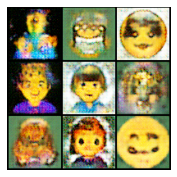

278:46
Epoch #609 / 2000, Generator Loss: 7.48284387588501, Discriminator Loss: -24.568239212036133
Epoch #610 / 2000, Generator Loss: 9.530200004577637, Discriminator Loss: -24.605470657348633
Epoch #611 / 2000, Generator Loss: 8.891029357910156, Discriminator Loss: -22.816715240478516
Epoch #612 / 2000, Generator Loss: 8.54405403137207, Discriminator Loss: -24.077730178833008
Generated images for Epoch #612:


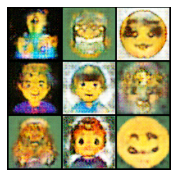

280:35
Epoch #613 / 2000, Generator Loss: 6.552003860473633, Discriminator Loss: -23.49350357055664
Epoch #614 / 2000, Generator Loss: 6.576887130737305, Discriminator Loss: -23.850942611694336
Epoch #615 / 2000, Generator Loss: 8.370746612548828, Discriminator Loss: -26.570545196533203
Epoch #616 / 2000, Generator Loss: 9.013139724731445, Discriminator Loss: -23.09357452392578
Generated images for Epoch #616:


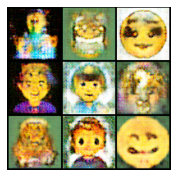

282:25
Epoch #617 / 2000, Generator Loss: 9.124588966369629, Discriminator Loss: -21.489273071289062
Epoch #618 / 2000, Generator Loss: 9.884062767028809, Discriminator Loss: -20.41886329650879
Epoch #619 / 2000, Generator Loss: 8.595420837402344, Discriminator Loss: -23.90521812438965
Epoch #620 / 2000, Generator Loss: 10.6465425491333, Discriminator Loss: -25.977542877197266
Generated images for Epoch #620:


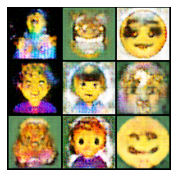

284:14
Epoch #621 / 2000, Generator Loss: 9.776185989379883, Discriminator Loss: -22.242212295532227
Epoch #622 / 2000, Generator Loss: 9.834205627441406, Discriminator Loss: -23.501161575317383
Epoch #623 / 2000, Generator Loss: 10.705469131469727, Discriminator Loss: -24.50086212158203
Epoch #624 / 2000, Generator Loss: 9.935834884643555, Discriminator Loss: -20.658052444458008
Generated images for Epoch #624:


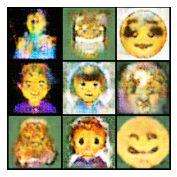

286:04
Epoch #625 / 2000, Generator Loss: 9.343875885009766, Discriminator Loss: -22.636592864990234
Epoch #626 / 2000, Generator Loss: 11.699450492858887, Discriminator Loss: -23.366092681884766
Epoch #627 / 2000, Generator Loss: 10.668846130371094, Discriminator Loss: -25.81595230102539
Epoch #628 / 2000, Generator Loss: 9.944967269897461, Discriminator Loss: -26.39852523803711
Generated images for Epoch #628:


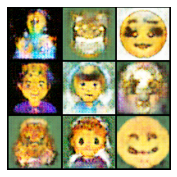

287:53
Epoch #629 / 2000, Generator Loss: 10.517383575439453, Discriminator Loss: -22.291316986083984
Epoch #630 / 2000, Generator Loss: 11.070189476013184, Discriminator Loss: -23.94210433959961
Epoch #631 / 2000, Generator Loss: 11.271357536315918, Discriminator Loss: -26.55841827392578
Epoch #632 / 2000, Generator Loss: 10.810678482055664, Discriminator Loss: -25.252275466918945
Generated images for Epoch #632:


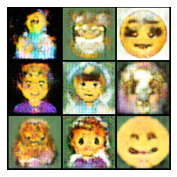

289:43
Epoch #633 / 2000, Generator Loss: 10.472260475158691, Discriminator Loss: -24.05986976623535
Epoch #634 / 2000, Generator Loss: 11.777083396911621, Discriminator Loss: -22.917091369628906
Epoch #635 / 2000, Generator Loss: 9.811420440673828, Discriminator Loss: -22.217195510864258
Epoch #636 / 2000, Generator Loss: 15.093870162963867, Discriminator Loss: -29.468992233276367
Generated images for Epoch #636:


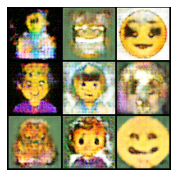

291:33
Epoch #637 / 2000, Generator Loss: 12.27968978881836, Discriminator Loss: -27.355758666992188
Epoch #638 / 2000, Generator Loss: 15.32563304901123, Discriminator Loss: -22.832489013671875
Epoch #639 / 2000, Generator Loss: 14.065110206604004, Discriminator Loss: -21.687936782836914
Epoch #640 / 2000, Generator Loss: 15.273012161254883, Discriminator Loss: -17.903480529785156
Generated images for Epoch #640:


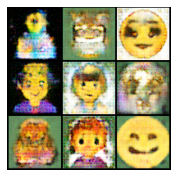

293:22
Epoch #641 / 2000, Generator Loss: 10.44910717010498, Discriminator Loss: -22.835189819335938
Epoch #642 / 2000, Generator Loss: 12.18657112121582, Discriminator Loss: -22.19733238220215
Epoch #643 / 2000, Generator Loss: 14.201105117797852, Discriminator Loss: -26.159862518310547
Epoch #644 / 2000, Generator Loss: 14.299812316894531, Discriminator Loss: -24.590476989746094
Generated images for Epoch #644:


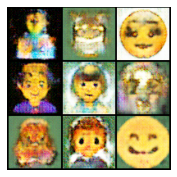

295:12
Epoch #645 / 2000, Generator Loss: 12.723918914794922, Discriminator Loss: -25.779991149902344
Epoch #646 / 2000, Generator Loss: 12.618852615356445, Discriminator Loss: -26.000829696655273
Epoch #647 / 2000, Generator Loss: 13.32555103302002, Discriminator Loss: -20.467880249023438
Epoch #648 / 2000, Generator Loss: 13.030118942260742, Discriminator Loss: -19.182720184326172
Generated images for Epoch #648:


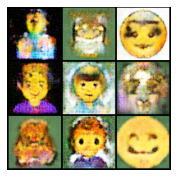

297:02
Epoch #649 / 2000, Generator Loss: 11.783025741577148, Discriminator Loss: -20.919612884521484
Epoch #650 / 2000, Generator Loss: 12.443595886230469, Discriminator Loss: -20.613628387451172
Epoch #651 / 2000, Generator Loss: 14.45793342590332, Discriminator Loss: -23.313461303710938
Epoch #652 / 2000, Generator Loss: 13.259148597717285, Discriminator Loss: -24.34577178955078
Generated images for Epoch #652:


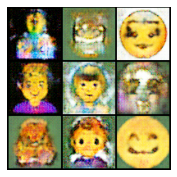

298:51
Epoch #653 / 2000, Generator Loss: 11.08298110961914, Discriminator Loss: -21.366832733154297
Epoch #654 / 2000, Generator Loss: 14.579974174499512, Discriminator Loss: -22.99215316772461
Epoch #655 / 2000, Generator Loss: 13.54421615600586, Discriminator Loss: -22.56509780883789
Epoch #656 / 2000, Generator Loss: 13.101016998291016, Discriminator Loss: -27.819896697998047
Generated images for Epoch #656:


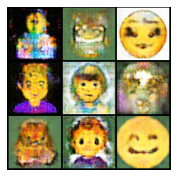

300:41
Epoch #657 / 2000, Generator Loss: 13.978606224060059, Discriminator Loss: -27.421058654785156
Epoch #658 / 2000, Generator Loss: 14.978744506835938, Discriminator Loss: -20.542110443115234
Epoch #659 / 2000, Generator Loss: 15.001208305358887, Discriminator Loss: -25.041685104370117
Epoch #660 / 2000, Generator Loss: 15.36509895324707, Discriminator Loss: -29.687999725341797
Generated images for Epoch #660:


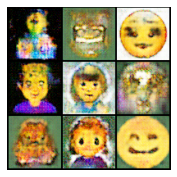

302:31
Epoch #661 / 2000, Generator Loss: 13.651975631713867, Discriminator Loss: -21.60745620727539
Epoch #662 / 2000, Generator Loss: 12.963606834411621, Discriminator Loss: -26.076107025146484
Epoch #663 / 2000, Generator Loss: 13.130321502685547, Discriminator Loss: -25.698951721191406
Epoch #664 / 2000, Generator Loss: 13.124534606933594, Discriminator Loss: -24.68062973022461
Generated images for Epoch #664:


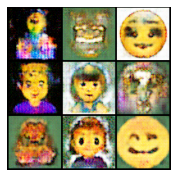

304:20
Epoch #665 / 2000, Generator Loss: 13.63425350189209, Discriminator Loss: -23.508865356445312
Epoch #666 / 2000, Generator Loss: 14.716165542602539, Discriminator Loss: -28.44084930419922
Epoch #667 / 2000, Generator Loss: 15.671073913574219, Discriminator Loss: -26.46513557434082
Epoch #668 / 2000, Generator Loss: 12.8026123046875, Discriminator Loss: -27.28925895690918
Generated images for Epoch #668:


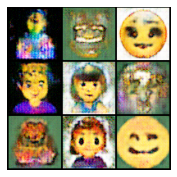

306:10
Epoch #669 / 2000, Generator Loss: 12.532285690307617, Discriminator Loss: -25.996959686279297
Epoch #670 / 2000, Generator Loss: 12.891130447387695, Discriminator Loss: -22.961193084716797
Epoch #671 / 2000, Generator Loss: 16.241199493408203, Discriminator Loss: -22.23591423034668
Epoch #672 / 2000, Generator Loss: 14.148700714111328, Discriminator Loss: -24.4450740814209
Generated images for Epoch #672:


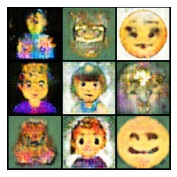

308:00
Epoch #673 / 2000, Generator Loss: 12.674032211303711, Discriminator Loss: -24.632890701293945
Epoch #674 / 2000, Generator Loss: 13.612174034118652, Discriminator Loss: -24.22730255126953
Epoch #675 / 2000, Generator Loss: 15.158219337463379, Discriminator Loss: -23.82073211669922
Epoch #676 / 2000, Generator Loss: 13.253355026245117, Discriminator Loss: -23.261760711669922
Generated images for Epoch #676:


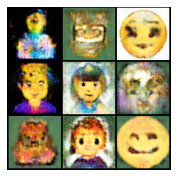

309:50
Epoch #677 / 2000, Generator Loss: 14.31408405303955, Discriminator Loss: -25.340436935424805
Epoch #678 / 2000, Generator Loss: 14.792610168457031, Discriminator Loss: -19.045169830322266
Epoch #679 / 2000, Generator Loss: 13.303112030029297, Discriminator Loss: -23.95355987548828
Epoch #680 / 2000, Generator Loss: 13.924778938293457, Discriminator Loss: -23.207178115844727
Generated images for Epoch #680:


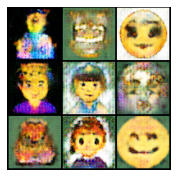

311:40
Epoch #681 / 2000, Generator Loss: 14.448636054992676, Discriminator Loss: -23.07164192199707
Epoch #682 / 2000, Generator Loss: 12.531192779541016, Discriminator Loss: -21.43665313720703
Epoch #683 / 2000, Generator Loss: 13.494211196899414, Discriminator Loss: -22.8228759765625
Epoch #684 / 2000, Generator Loss: 11.843679428100586, Discriminator Loss: -23.273784637451172
Generated images for Epoch #684:


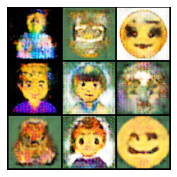

313:29
Epoch #685 / 2000, Generator Loss: 14.008401870727539, Discriminator Loss: -30.590837478637695
Epoch #686 / 2000, Generator Loss: 11.59302806854248, Discriminator Loss: -25.65044403076172
Epoch #687 / 2000, Generator Loss: 16.05930519104004, Discriminator Loss: -23.142822265625
Epoch #688 / 2000, Generator Loss: 13.823043823242188, Discriminator Loss: -20.919166564941406
Generated images for Epoch #688:


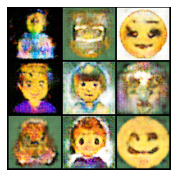

315:20
Epoch #689 / 2000, Generator Loss: 13.225130081176758, Discriminator Loss: -21.094310760498047
Epoch #690 / 2000, Generator Loss: 15.451826095581055, Discriminator Loss: -25.378387451171875
Epoch #691 / 2000, Generator Loss: 14.457132339477539, Discriminator Loss: -26.396862030029297
Epoch #692 / 2000, Generator Loss: 13.542159080505371, Discriminator Loss: -23.576946258544922
Generated images for Epoch #692:


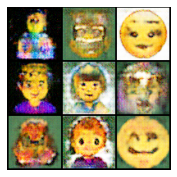

317:09
Epoch #693 / 2000, Generator Loss: 13.811580657958984, Discriminator Loss: -21.32012939453125
Epoch #694 / 2000, Generator Loss: 16.12235450744629, Discriminator Loss: -22.806312561035156
Epoch #695 / 2000, Generator Loss: 15.867536544799805, Discriminator Loss: -24.42566680908203
Epoch #696 / 2000, Generator Loss: 15.211065292358398, Discriminator Loss: -25.042011260986328
Generated images for Epoch #696:


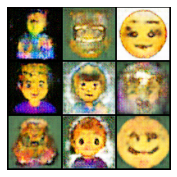

318:59
Epoch #697 / 2000, Generator Loss: 13.638525009155273, Discriminator Loss: -29.062437057495117
Epoch #698 / 2000, Generator Loss: 15.945384979248047, Discriminator Loss: -28.59093475341797
Epoch #699 / 2000, Generator Loss: 17.081024169921875, Discriminator Loss: -23.984386444091797
Epoch #700 / 2000, Generator Loss: 15.616338729858398, Discriminator Loss: -25.889440536499023
Generated images for Epoch #700:


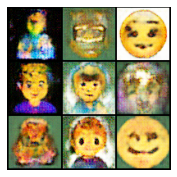

320:49
Epoch #701 / 2000, Generator Loss: 15.054963111877441, Discriminator Loss: -26.42482566833496
Epoch #702 / 2000, Generator Loss: 17.481060028076172, Discriminator Loss: -24.149059295654297
Epoch #703 / 2000, Generator Loss: 15.424302101135254, Discriminator Loss: -19.980743408203125
Epoch #704 / 2000, Generator Loss: 16.437774658203125, Discriminator Loss: -24.460681915283203
Generated images for Epoch #704:


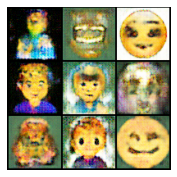

322:39
Epoch #705 / 2000, Generator Loss: 16.595806121826172, Discriminator Loss: -23.35043716430664
Epoch #706 / 2000, Generator Loss: 16.610517501831055, Discriminator Loss: -24.100360870361328
Epoch #707 / 2000, Generator Loss: 17.511810302734375, Discriminator Loss: -24.91619110107422
Epoch #708 / 2000, Generator Loss: 16.625667572021484, Discriminator Loss: -24.64371109008789
Generated images for Epoch #708:


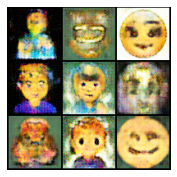

324:28
Epoch #709 / 2000, Generator Loss: 20.308677673339844, Discriminator Loss: -23.157596588134766
Epoch #710 / 2000, Generator Loss: 15.462018966674805, Discriminator Loss: -28.313020706176758
Epoch #711 / 2000, Generator Loss: 15.84988784790039, Discriminator Loss: -23.449771881103516
Epoch #712 / 2000, Generator Loss: 14.568092346191406, Discriminator Loss: -22.48820686340332
Generated images for Epoch #712:


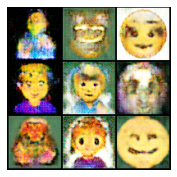

326:18
Epoch #713 / 2000, Generator Loss: 16.1529483795166, Discriminator Loss: -27.39635467529297
Epoch #714 / 2000, Generator Loss: 17.95089340209961, Discriminator Loss: -21.42289161682129
Epoch #715 / 2000, Generator Loss: 13.714583396911621, Discriminator Loss: -25.81861114501953
Epoch #716 / 2000, Generator Loss: 16.182634353637695, Discriminator Loss: -22.275360107421875
Generated images for Epoch #716:


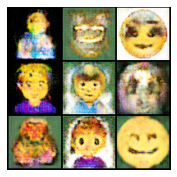

328:09
Epoch #717 / 2000, Generator Loss: 14.974992752075195, Discriminator Loss: -20.57372283935547
Epoch #718 / 2000, Generator Loss: 15.44709587097168, Discriminator Loss: -21.977252960205078
Epoch #719 / 2000, Generator Loss: 14.113855361938477, Discriminator Loss: -23.480817794799805
Epoch #720 / 2000, Generator Loss: 17.856739044189453, Discriminator Loss: -20.656835556030273
Generated images for Epoch #720:


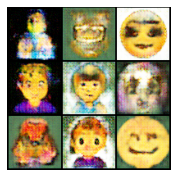

329:58
Epoch #721 / 2000, Generator Loss: 15.286627769470215, Discriminator Loss: -22.83205795288086
Epoch #722 / 2000, Generator Loss: 15.824930191040039, Discriminator Loss: -26.013813018798828
Epoch #723 / 2000, Generator Loss: 13.042936325073242, Discriminator Loss: -18.692232131958008
Epoch #724 / 2000, Generator Loss: 16.86279296875, Discriminator Loss: -24.061901092529297
Generated images for Epoch #724:


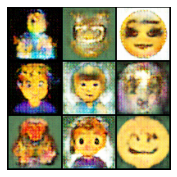

331:48
Epoch #725 / 2000, Generator Loss: 16.530967712402344, Discriminator Loss: -20.137229919433594
Epoch #726 / 2000, Generator Loss: 15.35490894317627, Discriminator Loss: -24.862058639526367
Epoch #727 / 2000, Generator Loss: 14.59824275970459, Discriminator Loss: -26.751972198486328
Epoch #728 / 2000, Generator Loss: 16.485383987426758, Discriminator Loss: -21.5300235748291
Generated images for Epoch #728:


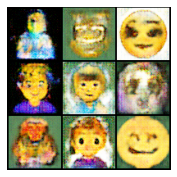

333:38
Epoch #729 / 2000, Generator Loss: 16.54444694519043, Discriminator Loss: -21.825578689575195
Epoch #730 / 2000, Generator Loss: 15.449634552001953, Discriminator Loss: -25.104812622070312
Epoch #731 / 2000, Generator Loss: 15.56410026550293, Discriminator Loss: -23.547311782836914
Epoch #732 / 2000, Generator Loss: 19.764209747314453, Discriminator Loss: -25.797765731811523
Generated images for Epoch #732:


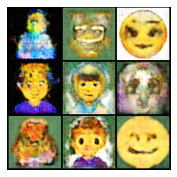

335:27
Epoch #733 / 2000, Generator Loss: 17.674633026123047, Discriminator Loss: -22.884056091308594
Epoch #734 / 2000, Generator Loss: 18.140151977539062, Discriminator Loss: -24.754596710205078
Epoch #735 / 2000, Generator Loss: 18.577421188354492, Discriminator Loss: -24.858854293823242
Epoch #736 / 2000, Generator Loss: 16.56610870361328, Discriminator Loss: -20.59187889099121
Generated images for Epoch #736:


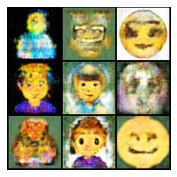

336:56
Epoch #737 / 2000, Generator Loss: 17.470483779907227, Discriminator Loss: -23.285938262939453
Epoch #738 / 2000, Generator Loss: 17.502716064453125, Discriminator Loss: -21.699634552001953
Epoch #739 / 2000, Generator Loss: 16.515745162963867, Discriminator Loss: -24.369850158691406
Epoch #740 / 2000, Generator Loss: 16.943477630615234, Discriminator Loss: -21.13811492919922
Generated images for Epoch #740:


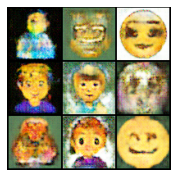

338:09
Epoch #741 / 2000, Generator Loss: 18.431121826171875, Discriminator Loss: -24.85712432861328
Epoch #742 / 2000, Generator Loss: 17.66284942626953, Discriminator Loss: -26.113750457763672
Epoch #743 / 2000, Generator Loss: 16.990737915039062, Discriminator Loss: -24.138412475585938
Epoch #744 / 2000, Generator Loss: 17.102956771850586, Discriminator Loss: -25.464496612548828
Generated images for Epoch #744:


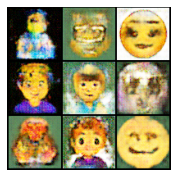

339:21
Epoch #745 / 2000, Generator Loss: 15.998819351196289, Discriminator Loss: -26.504270553588867
Epoch #746 / 2000, Generator Loss: 18.16604995727539, Discriminator Loss: -24.123838424682617
Epoch #747 / 2000, Generator Loss: 19.143953323364258, Discriminator Loss: -23.14461326599121
Epoch #748 / 2000, Generator Loss: 17.94317626953125, Discriminator Loss: -21.051589965820312
Generated images for Epoch #748:


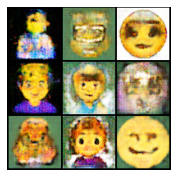

340:33
Epoch #749 / 2000, Generator Loss: 16.790821075439453, Discriminator Loss: -25.646072387695312
Epoch #750 / 2000, Generator Loss: 19.032711029052734, Discriminator Loss: -22.866558074951172
Epoch #751 / 2000, Generator Loss: 18.45745277404785, Discriminator Loss: -25.28809928894043
Epoch #752 / 2000, Generator Loss: 19.075313568115234, Discriminator Loss: -22.264501571655273
Generated images for Epoch #752:


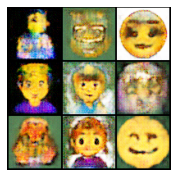

341:46
Epoch #753 / 2000, Generator Loss: 16.97344207763672, Discriminator Loss: -21.93143653869629
Epoch #754 / 2000, Generator Loss: 16.933090209960938, Discriminator Loss: -24.385028839111328
Epoch #755 / 2000, Generator Loss: 17.928272247314453, Discriminator Loss: -26.00634002685547
Epoch #756 / 2000, Generator Loss: 17.34491539001465, Discriminator Loss: -17.394014358520508
Generated images for Epoch #756:


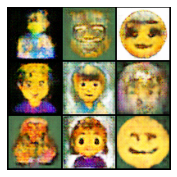

342:58
Epoch #757 / 2000, Generator Loss: 16.708648681640625, Discriminator Loss: -22.268890380859375
Epoch #758 / 2000, Generator Loss: 17.008764266967773, Discriminator Loss: -25.942201614379883
Epoch #759 / 2000, Generator Loss: 17.10226821899414, Discriminator Loss: -21.228260040283203
Epoch #760 / 2000, Generator Loss: 17.052562713623047, Discriminator Loss: -25.938129425048828
Generated images for Epoch #760:


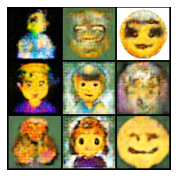

344:11
Epoch #761 / 2000, Generator Loss: 16.79555892944336, Discriminator Loss: -23.866500854492188
Epoch #762 / 2000, Generator Loss: 16.93575668334961, Discriminator Loss: -21.487430572509766
Epoch #763 / 2000, Generator Loss: 15.846315383911133, Discriminator Loss: -25.404497146606445
Epoch #764 / 2000, Generator Loss: 18.838024139404297, Discriminator Loss: -22.54731559753418
Generated images for Epoch #764:


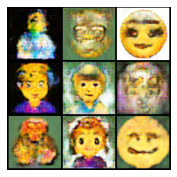

345:23
Epoch #765 / 2000, Generator Loss: 18.98355484008789, Discriminator Loss: -27.46223258972168
Epoch #766 / 2000, Generator Loss: 16.071582794189453, Discriminator Loss: -24.627315521240234
Epoch #767 / 2000, Generator Loss: 17.94015121459961, Discriminator Loss: -22.852153778076172
Epoch #768 / 2000, Generator Loss: 18.376365661621094, Discriminator Loss: -24.312484741210938
Generated images for Epoch #768:


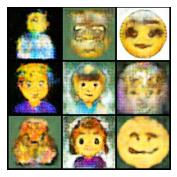

346:36
Epoch #769 / 2000, Generator Loss: 19.28436279296875, Discriminator Loss: -21.846729278564453
Epoch #770 / 2000, Generator Loss: 18.937864303588867, Discriminator Loss: -21.135135650634766
Epoch #771 / 2000, Generator Loss: 17.783205032348633, Discriminator Loss: -23.558345794677734
Epoch #772 / 2000, Generator Loss: 18.829143524169922, Discriminator Loss: -24.387834548950195
Generated images for Epoch #772:


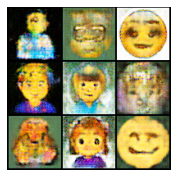

347:53
Epoch #773 / 2000, Generator Loss: 18.46074676513672, Discriminator Loss: -20.534151077270508
Epoch #774 / 2000, Generator Loss: 17.695486068725586, Discriminator Loss: -21.79120445251465
Epoch #775 / 2000, Generator Loss: 18.305957794189453, Discriminator Loss: -22.56338882446289
Epoch #776 / 2000, Generator Loss: 16.02206039428711, Discriminator Loss: -27.246959686279297
Generated images for Epoch #776:


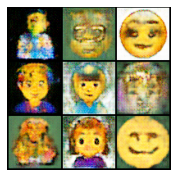

349:15
Epoch #777 / 2000, Generator Loss: 18.585325241088867, Discriminator Loss: -25.654281616210938
Epoch #778 / 2000, Generator Loss: 15.58564567565918, Discriminator Loss: -23.628406524658203
Epoch #779 / 2000, Generator Loss: 17.915573120117188, Discriminator Loss: -24.74066925048828
Epoch #780 / 2000, Generator Loss: 17.003376007080078, Discriminator Loss: -26.549571990966797
Generated images for Epoch #780:


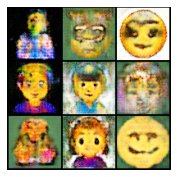

350:36
Epoch #781 / 2000, Generator Loss: 18.484521865844727, Discriminator Loss: -26.703292846679688
Epoch #782 / 2000, Generator Loss: 16.681489944458008, Discriminator Loss: -24.005130767822266
Epoch #783 / 2000, Generator Loss: 19.19902801513672, Discriminator Loss: -24.091392517089844
Epoch #784 / 2000, Generator Loss: 18.733848571777344, Discriminator Loss: -21.88962173461914
Generated images for Epoch #784:


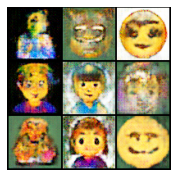

351:58
Epoch #785 / 2000, Generator Loss: 18.056161880493164, Discriminator Loss: -23.82916259765625
Epoch #786 / 2000, Generator Loss: 18.710872650146484, Discriminator Loss: -22.244548797607422
Epoch #787 / 2000, Generator Loss: 20.057710647583008, Discriminator Loss: -23.836437225341797
Epoch #788 / 2000, Generator Loss: 19.03795623779297, Discriminator Loss: -25.413177490234375
Generated images for Epoch #788:


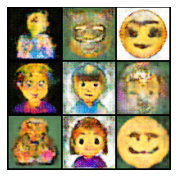

353:19
Epoch #789 / 2000, Generator Loss: 20.004981994628906, Discriminator Loss: -26.303791046142578
Epoch #790 / 2000, Generator Loss: 18.373611450195312, Discriminator Loss: -22.344749450683594
Epoch #791 / 2000, Generator Loss: 20.865188598632812, Discriminator Loss: -26.024160385131836
Epoch #792 / 2000, Generator Loss: 19.30072784423828, Discriminator Loss: -19.519760131835938
Generated images for Epoch #792:


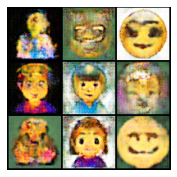

354:41
Epoch #793 / 2000, Generator Loss: 18.657001495361328, Discriminator Loss: -25.643712997436523
Epoch #794 / 2000, Generator Loss: 20.85516357421875, Discriminator Loss: -22.388694763183594
Epoch #795 / 2000, Generator Loss: 18.66962432861328, Discriminator Loss: -25.423059463500977
Epoch #796 / 2000, Generator Loss: 18.93213653564453, Discriminator Loss: -24.404878616333008
Generated images for Epoch #796:


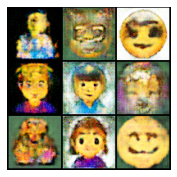

356:02
Epoch #797 / 2000, Generator Loss: 19.096946716308594, Discriminator Loss: -20.863792419433594
Epoch #798 / 2000, Generator Loss: 20.714021682739258, Discriminator Loss: -23.88030242919922
Epoch #799 / 2000, Generator Loss: 18.890419006347656, Discriminator Loss: -26.738056182861328
Epoch #800 / 2000, Generator Loss: 18.849990844726562, Discriminator Loss: -22.936065673828125
Generated images for Epoch #800:


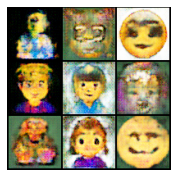

357:23
Epoch #801 / 2000, Generator Loss: 20.01987648010254, Discriminator Loss: -26.32331085205078
Epoch #802 / 2000, Generator Loss: 19.1364803314209, Discriminator Loss: -21.390592575073242
Epoch #803 / 2000, Generator Loss: 18.830455780029297, Discriminator Loss: -24.183717727661133
Epoch #804 / 2000, Generator Loss: 19.77085304260254, Discriminator Loss: -21.570995330810547
Generated images for Epoch #804:


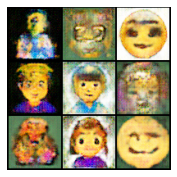

358:40
Epoch #805 / 2000, Generator Loss: 20.83658218383789, Discriminator Loss: -22.67177391052246
Epoch #806 / 2000, Generator Loss: 20.514379501342773, Discriminator Loss: -22.255407333374023
Epoch #807 / 2000, Generator Loss: 19.833337783813477, Discriminator Loss: -24.654226303100586
Epoch #808 / 2000, Generator Loss: 20.00157928466797, Discriminator Loss: -28.438640594482422
Generated images for Epoch #808:


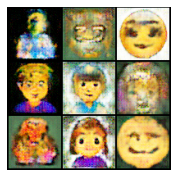

359:55
Epoch #809 / 2000, Generator Loss: 20.422576904296875, Discriminator Loss: -24.366561889648438
Epoch #810 / 2000, Generator Loss: 21.977062225341797, Discriminator Loss: -21.3287410736084
Epoch #811 / 2000, Generator Loss: 20.316959381103516, Discriminator Loss: -25.60593605041504
Epoch #812 / 2000, Generator Loss: 21.616758346557617, Discriminator Loss: -25.32278060913086
Generated images for Epoch #812:


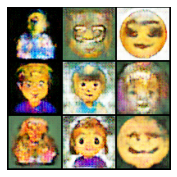

361:11
Epoch #813 / 2000, Generator Loss: 20.830711364746094, Discriminator Loss: -23.454967498779297
Epoch #814 / 2000, Generator Loss: 20.316354751586914, Discriminator Loss: -27.851600646972656
Epoch #815 / 2000, Generator Loss: 20.045978546142578, Discriminator Loss: -23.90155029296875
Epoch #816 / 2000, Generator Loss: 19.020835876464844, Discriminator Loss: -22.124011993408203
Generated images for Epoch #816:


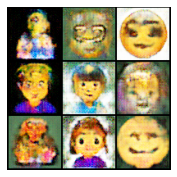

362:27
Epoch #817 / 2000, Generator Loss: 20.213895797729492, Discriminator Loss: -23.095943450927734
Epoch #818 / 2000, Generator Loss: 23.753572463989258, Discriminator Loss: -26.984285354614258
Epoch #819 / 2000, Generator Loss: 20.012664794921875, Discriminator Loss: -24.68414878845215
Epoch #820 / 2000, Generator Loss: 21.01327133178711, Discriminator Loss: -19.683805465698242
Generated images for Epoch #820:


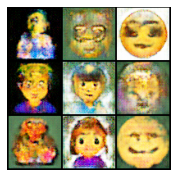

363:47
Epoch #821 / 2000, Generator Loss: 21.063507080078125, Discriminator Loss: -23.696125030517578
Epoch #822 / 2000, Generator Loss: 21.278133392333984, Discriminator Loss: -26.119346618652344
Epoch #823 / 2000, Generator Loss: 21.71483039855957, Discriminator Loss: -20.881216049194336
Epoch #824 / 2000, Generator Loss: 20.379798889160156, Discriminator Loss: -23.962955474853516
Generated images for Epoch #824:


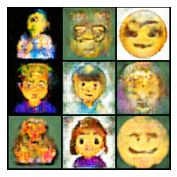

365:10
Epoch #825 / 2000, Generator Loss: 21.18762969970703, Discriminator Loss: -20.02979278564453
Epoch #826 / 2000, Generator Loss: 21.226720809936523, Discriminator Loss: -19.91088104248047
Epoch #827 / 2000, Generator Loss: 19.025035858154297, Discriminator Loss: -21.621036529541016
Epoch #828 / 2000, Generator Loss: 20.802352905273438, Discriminator Loss: -25.35149383544922
Generated images for Epoch #828:


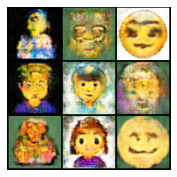

366:36
Epoch #829 / 2000, Generator Loss: 21.248355865478516, Discriminator Loss: -22.139516830444336
Epoch #830 / 2000, Generator Loss: 19.549030303955078, Discriminator Loss: -25.555408477783203
Epoch #831 / 2000, Generator Loss: 19.179031372070312, Discriminator Loss: -24.58041000366211
Epoch #832 / 2000, Generator Loss: 21.497390747070312, Discriminator Loss: -24.149490356445312
Generated images for Epoch #832:


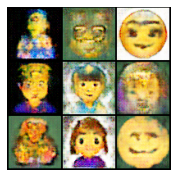

368:03
Epoch #833 / 2000, Generator Loss: 20.512081146240234, Discriminator Loss: -19.701900482177734
Epoch #834 / 2000, Generator Loss: 18.541223526000977, Discriminator Loss: -22.679847717285156
Epoch #835 / 2000, Generator Loss: 19.036834716796875, Discriminator Loss: -26.16347885131836
Epoch #836 / 2000, Generator Loss: 17.901214599609375, Discriminator Loss: -23.016921997070312
Generated images for Epoch #836:


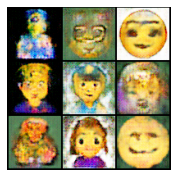

369:31
Epoch #837 / 2000, Generator Loss: 19.579469680786133, Discriminator Loss: -25.84366226196289
Epoch #838 / 2000, Generator Loss: 21.264842987060547, Discriminator Loss: -22.271692276000977
Epoch #839 / 2000, Generator Loss: 19.091693878173828, Discriminator Loss: -23.464969635009766
Epoch #840 / 2000, Generator Loss: 18.441646575927734, Discriminator Loss: -20.939437866210938
Generated images for Epoch #840:


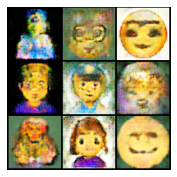

371:02
Epoch #841 / 2000, Generator Loss: 19.044553756713867, Discriminator Loss: -27.3200626373291
Epoch #842 / 2000, Generator Loss: 19.495689392089844, Discriminator Loss: -23.37211799621582
Epoch #843 / 2000, Generator Loss: 21.240955352783203, Discriminator Loss: -26.38564682006836
Epoch #844 / 2000, Generator Loss: 19.64402198791504, Discriminator Loss: -26.282024383544922
Generated images for Epoch #844:


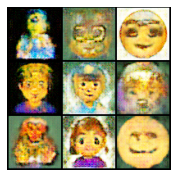

372:32
Epoch #845 / 2000, Generator Loss: 20.079349517822266, Discriminator Loss: -21.318878173828125
Epoch #846 / 2000, Generator Loss: 21.223196029663086, Discriminator Loss: -25.902997970581055
Epoch #847 / 2000, Generator Loss: 20.069259643554688, Discriminator Loss: -31.38711929321289
Epoch #848 / 2000, Generator Loss: 18.987335205078125, Discriminator Loss: -24.031780242919922
Generated images for Epoch #848:


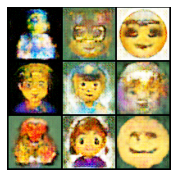

374:04
Epoch #849 / 2000, Generator Loss: 20.69161605834961, Discriminator Loss: -25.242048263549805
Epoch #850 / 2000, Generator Loss: 23.018587112426758, Discriminator Loss: -18.979145050048828
Epoch #851 / 2000, Generator Loss: 21.61240005493164, Discriminator Loss: -22.286949157714844
Epoch #852 / 2000, Generator Loss: 20.79108428955078, Discriminator Loss: -21.89457130432129
Generated images for Epoch #852:


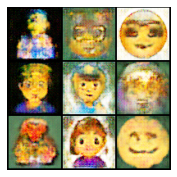

375:36
Epoch #853 / 2000, Generator Loss: 20.99644660949707, Discriminator Loss: -29.868749618530273
Epoch #854 / 2000, Generator Loss: 23.036903381347656, Discriminator Loss: -22.522228240966797
Epoch #855 / 2000, Generator Loss: 20.17437744140625, Discriminator Loss: -23.234264373779297
Epoch #856 / 2000, Generator Loss: 20.243619918823242, Discriminator Loss: -26.455127716064453
Generated images for Epoch #856:


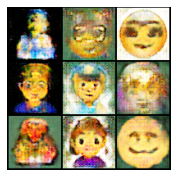

377:08
Epoch #857 / 2000, Generator Loss: 19.93012809753418, Discriminator Loss: -23.81610679626465
Epoch #858 / 2000, Generator Loss: 20.41029167175293, Discriminator Loss: -25.605709075927734
Epoch #859 / 2000, Generator Loss: 20.148738861083984, Discriminator Loss: -21.70966339111328
Epoch #860 / 2000, Generator Loss: 21.674633026123047, Discriminator Loss: -23.467994689941406
Generated images for Epoch #860:


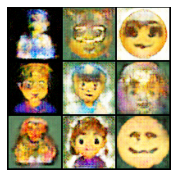

378:41
Epoch #861 / 2000, Generator Loss: 21.14553451538086, Discriminator Loss: -24.09332275390625
Epoch #862 / 2000, Generator Loss: 21.28561782836914, Discriminator Loss: -24.846328735351562
Epoch #863 / 2000, Generator Loss: 21.096115112304688, Discriminator Loss: -20.834871292114258
Epoch #864 / 2000, Generator Loss: 22.8184814453125, Discriminator Loss: -23.26937484741211
Generated images for Epoch #864:


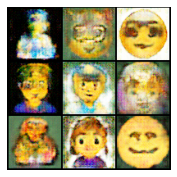

380:15
Epoch #865 / 2000, Generator Loss: 20.278278350830078, Discriminator Loss: -26.441726684570312
Epoch #866 / 2000, Generator Loss: 22.111392974853516, Discriminator Loss: -26.952836990356445
Epoch #867 / 2000, Generator Loss: 19.52182388305664, Discriminator Loss: -29.120378494262695
Epoch #868 / 2000, Generator Loss: 22.269752502441406, Discriminator Loss: -22.807880401611328
Generated images for Epoch #868:


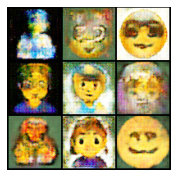

381:47
Epoch #869 / 2000, Generator Loss: 20.98035430908203, Discriminator Loss: -24.833709716796875
Epoch #870 / 2000, Generator Loss: 21.32754135131836, Discriminator Loss: -28.723751068115234
Epoch #871 / 2000, Generator Loss: 24.347267150878906, Discriminator Loss: -23.08342742919922
Epoch #872 / 2000, Generator Loss: 24.23628044128418, Discriminator Loss: -24.090984344482422
Generated images for Epoch #872:


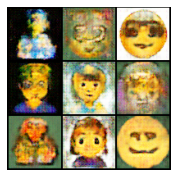

383:20
Epoch #873 / 2000, Generator Loss: 24.66617202758789, Discriminator Loss: -28.651897430419922
Epoch #874 / 2000, Generator Loss: 22.757354736328125, Discriminator Loss: -22.790653228759766
Epoch #875 / 2000, Generator Loss: 23.851886749267578, Discriminator Loss: -23.089651107788086
Epoch #876 / 2000, Generator Loss: 24.43752670288086, Discriminator Loss: -24.662500381469727
Generated images for Epoch #876:


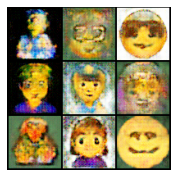

384:54
Epoch #877 / 2000, Generator Loss: 22.324460983276367, Discriminator Loss: -24.301807403564453
Epoch #878 / 2000, Generator Loss: 22.98568344116211, Discriminator Loss: -27.42362403869629
Epoch #879 / 2000, Generator Loss: 22.265554428100586, Discriminator Loss: -25.78180694580078
Epoch #880 / 2000, Generator Loss: 22.10953140258789, Discriminator Loss: -24.416481018066406
Generated images for Epoch #880:


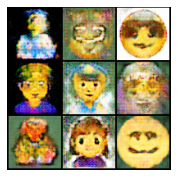

386:29
Epoch #881 / 2000, Generator Loss: 25.055988311767578, Discriminator Loss: -22.45344352722168
Epoch #882 / 2000, Generator Loss: 23.42816162109375, Discriminator Loss: -22.708240509033203
Epoch #883 / 2000, Generator Loss: 23.002975463867188, Discriminator Loss: -26.55181884765625
Epoch #884 / 2000, Generator Loss: 22.974252700805664, Discriminator Loss: -20.546669006347656
Generated images for Epoch #884:


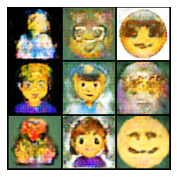

388:04
Epoch #885 / 2000, Generator Loss: 22.435749053955078, Discriminator Loss: -22.730445861816406
Epoch #886 / 2000, Generator Loss: 23.207115173339844, Discriminator Loss: -25.786672592163086
Epoch #887 / 2000, Generator Loss: 25.532787322998047, Discriminator Loss: -26.231746673583984
Epoch #888 / 2000, Generator Loss: 22.97389793395996, Discriminator Loss: -26.07431983947754
Generated images for Epoch #888:


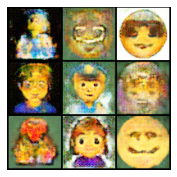

389:41
Epoch #889 / 2000, Generator Loss: 25.23904800415039, Discriminator Loss: -22.777185440063477
Epoch #890 / 2000, Generator Loss: 25.178096771240234, Discriminator Loss: -23.528911590576172
Epoch #891 / 2000, Generator Loss: 25.640953063964844, Discriminator Loss: -24.51089096069336
Epoch #892 / 2000, Generator Loss: 24.175106048583984, Discriminator Loss: -21.361248016357422
Generated images for Epoch #892:


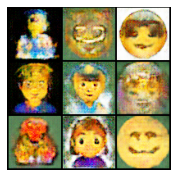

391:17
Epoch #893 / 2000, Generator Loss: 25.110891342163086, Discriminator Loss: -25.238327026367188
Epoch #894 / 2000, Generator Loss: 24.66574478149414, Discriminator Loss: -26.84947967529297
Epoch #895 / 2000, Generator Loss: 26.745281219482422, Discriminator Loss: -25.80013656616211
Epoch #896 / 2000, Generator Loss: 25.887765884399414, Discriminator Loss: -22.90256118774414
Generated images for Epoch #896:


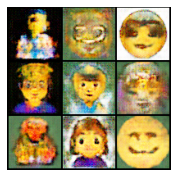

392:54
Epoch #897 / 2000, Generator Loss: 25.026817321777344, Discriminator Loss: -25.78598403930664
Epoch #898 / 2000, Generator Loss: 25.04940414428711, Discriminator Loss: -23.617658615112305
Epoch #899 / 2000, Generator Loss: 23.82433319091797, Discriminator Loss: -20.060070037841797
Epoch #900 / 2000, Generator Loss: 26.02703094482422, Discriminator Loss: -24.807186126708984
Generated images for Epoch #900:


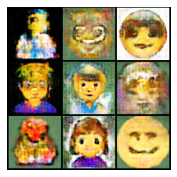

394:31
Epoch #901 / 2000, Generator Loss: 25.576364517211914, Discriminator Loss: -27.993785858154297
Epoch #902 / 2000, Generator Loss: 25.099071502685547, Discriminator Loss: -25.848041534423828
Epoch #903 / 2000, Generator Loss: 28.77440643310547, Discriminator Loss: -24.77560806274414
Epoch #904 / 2000, Generator Loss: 26.106382369995117, Discriminator Loss: -25.20570182800293
Generated images for Epoch #904:


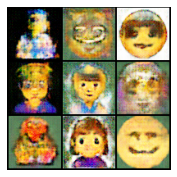

396:11
Epoch #905 / 2000, Generator Loss: 24.545114517211914, Discriminator Loss: -21.116209030151367
Epoch #906 / 2000, Generator Loss: 25.37385368347168, Discriminator Loss: -22.40557861328125
Epoch #907 / 2000, Generator Loss: 24.34023666381836, Discriminator Loss: -21.70975112915039
Epoch #908 / 2000, Generator Loss: 25.357593536376953, Discriminator Loss: -22.92734718322754
Generated images for Epoch #908:


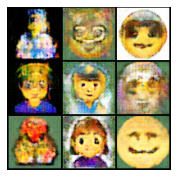

405:52
Epoch #909 / 2000, Generator Loss: 25.817045211791992, Discriminator Loss: -24.184288024902344
Epoch #910 / 2000, Generator Loss: 24.773265838623047, Discriminator Loss: -24.33734130859375
Epoch #911 / 2000, Generator Loss: 26.01932716369629, Discriminator Loss: -19.39725112915039
Epoch #912 / 2000, Generator Loss: 25.373443603515625, Discriminator Loss: -25.682506561279297
Generated images for Epoch #912:


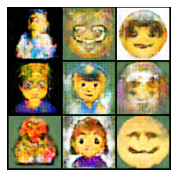

407:07
Epoch #913 / 2000, Generator Loss: 27.927574157714844, Discriminator Loss: -20.679973602294922
Epoch #914 / 2000, Generator Loss: 24.441165924072266, Discriminator Loss: -25.786224365234375
Epoch #915 / 2000, Generator Loss: 27.04852294921875, Discriminator Loss: -21.94281005859375
Epoch #916 / 2000, Generator Loss: 25.264041900634766, Discriminator Loss: -20.396377563476562
Generated images for Epoch #916:


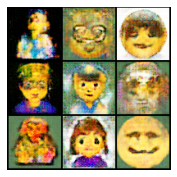

408:23
Epoch #917 / 2000, Generator Loss: 26.875568389892578, Discriminator Loss: -19.013778686523438
Epoch #918 / 2000, Generator Loss: 27.184900283813477, Discriminator Loss: -24.145368576049805
Epoch #919 / 2000, Generator Loss: 25.362781524658203, Discriminator Loss: -19.021343231201172
Epoch #920 / 2000, Generator Loss: 27.84496307373047, Discriminator Loss: -22.978456497192383
Generated images for Epoch #920:


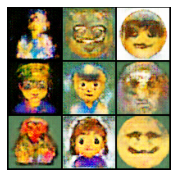

409:43
Epoch #921 / 2000, Generator Loss: 24.95098876953125, Discriminator Loss: -26.02370834350586
Epoch #922 / 2000, Generator Loss: 25.889921188354492, Discriminator Loss: -22.54755973815918
Epoch #923 / 2000, Generator Loss: 26.57663345336914, Discriminator Loss: -24.00701904296875
Epoch #924 / 2000, Generator Loss: 25.509733200073242, Discriminator Loss: -22.061552047729492
Generated images for Epoch #924:


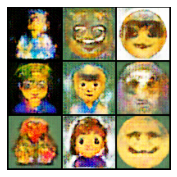

411:09
Epoch #925 / 2000, Generator Loss: 25.323802947998047, Discriminator Loss: -27.733606338500977
Epoch #926 / 2000, Generator Loss: 27.01697540283203, Discriminator Loss: -24.029701232910156
Epoch #927 / 2000, Generator Loss: 28.236345291137695, Discriminator Loss: -26.15045738220215
Epoch #928 / 2000, Generator Loss: 27.798124313354492, Discriminator Loss: -25.0463924407959
Generated images for Epoch #928:


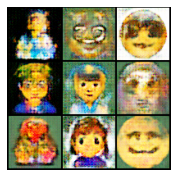

412:41
Epoch #929 / 2000, Generator Loss: 25.852643966674805, Discriminator Loss: -24.012908935546875
Epoch #930 / 2000, Generator Loss: 27.845882415771484, Discriminator Loss: -28.28266143798828
Epoch #931 / 2000, Generator Loss: 28.562358856201172, Discriminator Loss: -21.344776153564453
Epoch #932 / 2000, Generator Loss: 28.230207443237305, Discriminator Loss: -20.943058013916016
Generated images for Epoch #932:


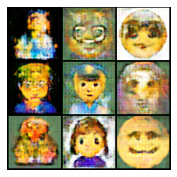

414:14
Epoch #933 / 2000, Generator Loss: 26.405261993408203, Discriminator Loss: -24.21587562561035
Epoch #934 / 2000, Generator Loss: 28.616716384887695, Discriminator Loss: -28.217830657958984
Epoch #935 / 2000, Generator Loss: 28.586811065673828, Discriminator Loss: -19.774145126342773
Epoch #936 / 2000, Generator Loss: 30.69497299194336, Discriminator Loss: -23.612499237060547
Generated images for Epoch #936:


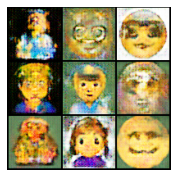

415:51
Epoch #937 / 2000, Generator Loss: 28.3072509765625, Discriminator Loss: -26.63625717163086
Epoch #938 / 2000, Generator Loss: 27.493637084960938, Discriminator Loss: -24.949874877929688
Epoch #939 / 2000, Generator Loss: 27.32642364501953, Discriminator Loss: -20.577594757080078
Epoch #940 / 2000, Generator Loss: 29.036630630493164, Discriminator Loss: -24.403167724609375
Generated images for Epoch #940:


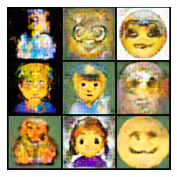

422:40
Epoch #941 / 2000, Generator Loss: 28.083335876464844, Discriminator Loss: -26.132699966430664
Epoch #942 / 2000, Generator Loss: 27.936397552490234, Discriminator Loss: -24.573122024536133
Epoch #943 / 2000, Generator Loss: 29.329784393310547, Discriminator Loss: -26.011478424072266
Epoch #944 / 2000, Generator Loss: 29.060134887695312, Discriminator Loss: -21.97917938232422
Generated images for Epoch #944:


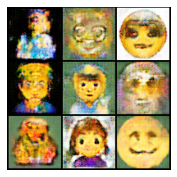

423:56
Epoch #945 / 2000, Generator Loss: 28.237808227539062, Discriminator Loss: -21.208328247070312
Epoch #946 / 2000, Generator Loss: 29.5786190032959, Discriminator Loss: -27.77838134765625
Epoch #947 / 2000, Generator Loss: 28.387052536010742, Discriminator Loss: -23.24602508544922
Epoch #948 / 2000, Generator Loss: 29.386173248291016, Discriminator Loss: -21.375835418701172
Generated images for Epoch #948:


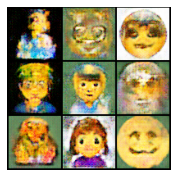

425:15
Epoch #949 / 2000, Generator Loss: 28.199302673339844, Discriminator Loss: -28.225177764892578
Epoch #950 / 2000, Generator Loss: 29.152244567871094, Discriminator Loss: -15.863052368164062
Epoch #951 / 2000, Generator Loss: 28.609176635742188, Discriminator Loss: -24.914289474487305
Epoch #952 / 2000, Generator Loss: 30.668991088867188, Discriminator Loss: -18.034381866455078
Generated images for Epoch #952:


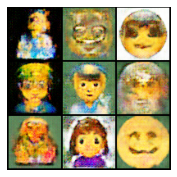

426:39
Epoch #953 / 2000, Generator Loss: 26.97705841064453, Discriminator Loss: -26.30219268798828
Epoch #954 / 2000, Generator Loss: 28.892459869384766, Discriminator Loss: -26.931596755981445
Epoch #955 / 2000, Generator Loss: 29.449230194091797, Discriminator Loss: -23.099151611328125
Epoch #956 / 2000, Generator Loss: 30.524471282958984, Discriminator Loss: -19.433425903320312
Generated images for Epoch #956:


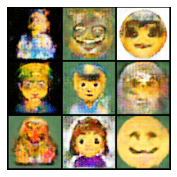

428:07
Epoch #957 / 2000, Generator Loss: 31.19001007080078, Discriminator Loss: -24.56898307800293
Epoch #958 / 2000, Generator Loss: 28.18427276611328, Discriminator Loss: -24.866729736328125
Epoch #959 / 2000, Generator Loss: 30.739490509033203, Discriminator Loss: -23.024810791015625
Epoch #960 / 2000, Generator Loss: 30.62258529663086, Discriminator Loss: -25.51832389831543
Generated images for Epoch #960:


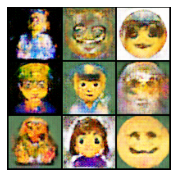

429:34
Epoch #961 / 2000, Generator Loss: 30.31431007385254, Discriminator Loss: -31.426816940307617
Epoch #962 / 2000, Generator Loss: 29.844337463378906, Discriminator Loss: -27.244104385375977
Epoch #963 / 2000, Generator Loss: 29.404666900634766, Discriminator Loss: -24.518348693847656
Epoch #964 / 2000, Generator Loss: 30.695880889892578, Discriminator Loss: -22.710529327392578
Generated images for Epoch #964:


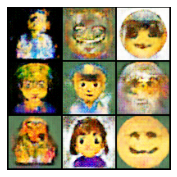

431:03
Epoch #965 / 2000, Generator Loss: 28.664295196533203, Discriminator Loss: -21.486698150634766
Epoch #966 / 2000, Generator Loss: 29.193824768066406, Discriminator Loss: -24.4953670501709
Epoch #967 / 2000, Generator Loss: 30.055805206298828, Discriminator Loss: -22.96900177001953
Epoch #968 / 2000, Generator Loss: 30.71796989440918, Discriminator Loss: -20.785940170288086
Generated images for Epoch #968:


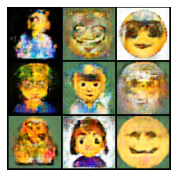

432:36
Epoch #969 / 2000, Generator Loss: 29.686180114746094, Discriminator Loss: -19.793350219726562
Epoch #970 / 2000, Generator Loss: 30.539833068847656, Discriminator Loss: -25.182527542114258
Epoch #971 / 2000, Generator Loss: 29.760143280029297, Discriminator Loss: -26.994365692138672
Epoch #972 / 2000, Generator Loss: 31.24443244934082, Discriminator Loss: -21.91367530822754
Generated images for Epoch #972:


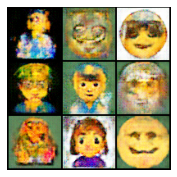

434:08
Epoch #973 / 2000, Generator Loss: 31.112613677978516, Discriminator Loss: -24.286197662353516
Epoch #974 / 2000, Generator Loss: 28.205204010009766, Discriminator Loss: -21.749332427978516
Epoch #975 / 2000, Generator Loss: 30.291236877441406, Discriminator Loss: -20.694747924804688
Epoch #976 / 2000, Generator Loss: 30.600526809692383, Discriminator Loss: -25.978919982910156
Generated images for Epoch #976:


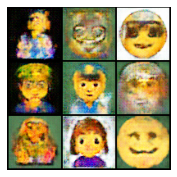

435:42
Epoch #977 / 2000, Generator Loss: 31.758949279785156, Discriminator Loss: -17.69359588623047
Epoch #978 / 2000, Generator Loss: 30.548864364624023, Discriminator Loss: -24.70555877685547
Epoch #979 / 2000, Generator Loss: 29.026657104492188, Discriminator Loss: -24.537155151367188
Epoch #980 / 2000, Generator Loss: 28.42938804626465, Discriminator Loss: -20.38292121887207
Generated images for Epoch #980:


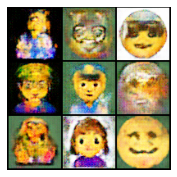

437:16
Epoch #981 / 2000, Generator Loss: 30.374116897583008, Discriminator Loss: -21.349828720092773
Epoch #982 / 2000, Generator Loss: 29.221464157104492, Discriminator Loss: -27.174427032470703
Epoch #983 / 2000, Generator Loss: 28.827613830566406, Discriminator Loss: -26.91619300842285
Epoch #984 / 2000, Generator Loss: 29.665828704833984, Discriminator Loss: -24.622459411621094
Generated images for Epoch #984:


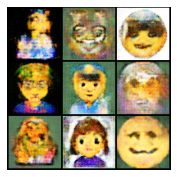

438:50
Epoch #985 / 2000, Generator Loss: 31.153600692749023, Discriminator Loss: -23.595212936401367
Epoch #986 / 2000, Generator Loss: 30.814653396606445, Discriminator Loss: -28.06997299194336
Epoch #987 / 2000, Generator Loss: 29.66124725341797, Discriminator Loss: -22.43112564086914
Epoch #988 / 2000, Generator Loss: 30.063457489013672, Discriminator Loss: -24.201906204223633
Generated images for Epoch #988:


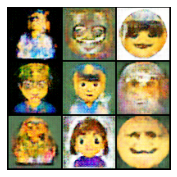

440:25
Epoch #989 / 2000, Generator Loss: 31.68162727355957, Discriminator Loss: -25.989471435546875
Epoch #990 / 2000, Generator Loss: 30.59800148010254, Discriminator Loss: -27.19936752319336
Epoch #991 / 2000, Generator Loss: 29.509185791015625, Discriminator Loss: -26.260679244995117
Epoch #992 / 2000, Generator Loss: 31.863784790039062, Discriminator Loss: -24.558446884155273
Generated images for Epoch #992:


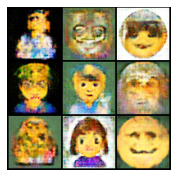

442:01
Epoch #993 / 2000, Generator Loss: 30.055980682373047, Discriminator Loss: -24.75149917602539
Epoch #994 / 2000, Generator Loss: 31.569217681884766, Discriminator Loss: -24.430564880371094
Epoch #995 / 2000, Generator Loss: 33.783958435058594, Discriminator Loss: -29.91411781311035
Epoch #996 / 2000, Generator Loss: 30.2353572845459, Discriminator Loss: -21.59115219116211
Generated images for Epoch #996:


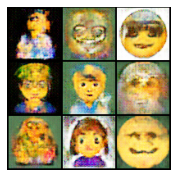

443:37
Epoch #997 / 2000, Generator Loss: 30.930503845214844, Discriminator Loss: -27.282203674316406
Epoch #998 / 2000, Generator Loss: 28.6656494140625, Discriminator Loss: -22.078962326049805
Epoch #999 / 2000, Generator Loss: 31.07884979248047, Discriminator Loss: -21.72738265991211
Epoch #1000 / 2000, Generator Loss: 31.256351470947266, Discriminator Loss: -22.779212951660156
Generated images for Epoch #1000:


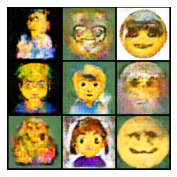

445:13
Epoch #1001 / 2000, Generator Loss: 31.512481689453125, Discriminator Loss: -24.94188690185547
Epoch #1002 / 2000, Generator Loss: 31.01483726501465, Discriminator Loss: -23.245826721191406
Epoch #1003 / 2000, Generator Loss: 32.374481201171875, Discriminator Loss: -18.786666870117188
Epoch #1004 / 2000, Generator Loss: 30.116962432861328, Discriminator Loss: -23.914609909057617
Generated images for Epoch #1004:


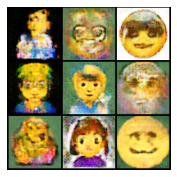

446:47
Epoch #1005 / 2000, Generator Loss: 31.118928909301758, Discriminator Loss: -23.787471771240234
Epoch #1006 / 2000, Generator Loss: 30.754823684692383, Discriminator Loss: -26.72119140625
Epoch #1007 / 2000, Generator Loss: 32.311622619628906, Discriminator Loss: -21.780054092407227
Epoch #1008 / 2000, Generator Loss: 31.142274856567383, Discriminator Loss: -22.35088539123535
Generated images for Epoch #1008:


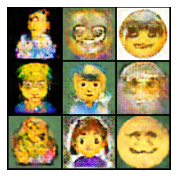

448:21
Epoch #1009 / 2000, Generator Loss: 31.110313415527344, Discriminator Loss: -19.71217918395996
Epoch #1010 / 2000, Generator Loss: 29.290512084960938, Discriminator Loss: -27.679214477539062
Epoch #1011 / 2000, Generator Loss: 32.557334899902344, Discriminator Loss: -26.040361404418945
Epoch #1012 / 2000, Generator Loss: 31.215635299682617, Discriminator Loss: -21.619251251220703
Generated images for Epoch #1012:


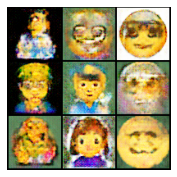

449:56
Epoch #1013 / 2000, Generator Loss: 29.73747444152832, Discriminator Loss: -17.391584396362305
Epoch #1014 / 2000, Generator Loss: 32.180442810058594, Discriminator Loss: -24.130281448364258
Epoch #1015 / 2000, Generator Loss: 34.5113639831543, Discriminator Loss: -23.683374404907227
Epoch #1016 / 2000, Generator Loss: 31.47321319580078, Discriminator Loss: -25.762577056884766
Generated images for Epoch #1016:


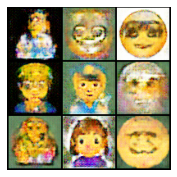

451:30
Epoch #1017 / 2000, Generator Loss: 30.46723175048828, Discriminator Loss: -23.453460693359375
Epoch #1018 / 2000, Generator Loss: 31.545089721679688, Discriminator Loss: -24.015596389770508
Epoch #1019 / 2000, Generator Loss: 32.25702667236328, Discriminator Loss: -24.541622161865234
Epoch #1020 / 2000, Generator Loss: 31.337682723999023, Discriminator Loss: -26.50620460510254
Generated images for Epoch #1020:


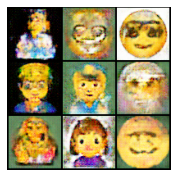

453:06
Epoch #1021 / 2000, Generator Loss: 30.97981071472168, Discriminator Loss: -23.71297836303711
Epoch #1022 / 2000, Generator Loss: 32.34191131591797, Discriminator Loss: -24.25845718383789
Epoch #1023 / 2000, Generator Loss: 31.86991310119629, Discriminator Loss: -21.43011474609375
Epoch #1024 / 2000, Generator Loss: 32.80536651611328, Discriminator Loss: -18.34693145751953
Generated images for Epoch #1024:


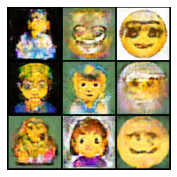

480:45
Epoch #1025 / 2000, Generator Loss: 32.301334381103516, Discriminator Loss: -19.27454376220703
Epoch #1026 / 2000, Generator Loss: 31.11360740661621, Discriminator Loss: -24.297746658325195
Epoch #1027 / 2000, Generator Loss: 32.14397430419922, Discriminator Loss: -21.068803787231445
Epoch #1028 / 2000, Generator Loss: 34.59345245361328, Discriminator Loss: -27.01718521118164
Generated images for Epoch #1028:


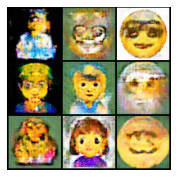

481:59
Epoch #1029 / 2000, Generator Loss: 30.78006362915039, Discriminator Loss: -25.661663055419922
Epoch #1030 / 2000, Generator Loss: 28.833053588867188, Discriminator Loss: -25.43792152404785
Epoch #1031 / 2000, Generator Loss: 31.66405487060547, Discriminator Loss: -21.75933074951172
Epoch #1032 / 2000, Generator Loss: 31.776596069335938, Discriminator Loss: -25.575942993164062
Generated images for Epoch #1032:


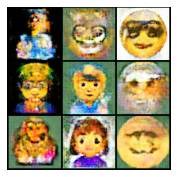

483:13
Epoch #1033 / 2000, Generator Loss: 33.10017395019531, Discriminator Loss: -19.759958267211914
Epoch #1034 / 2000, Generator Loss: 31.622957229614258, Discriminator Loss: -20.858476638793945
Epoch #1035 / 2000, Generator Loss: 30.23102569580078, Discriminator Loss: -20.281082153320312
Epoch #1036 / 2000, Generator Loss: 31.164661407470703, Discriminator Loss: -22.46031951904297
Generated images for Epoch #1036:


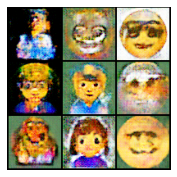

484:28
Epoch #1037 / 2000, Generator Loss: 30.753803253173828, Discriminator Loss: -27.030120849609375
Epoch #1038 / 2000, Generator Loss: 32.92676544189453, Discriminator Loss: -24.60256004333496
Epoch #1039 / 2000, Generator Loss: 34.48837661743164, Discriminator Loss: -28.86395263671875
Epoch #1040 / 2000, Generator Loss: 30.264951705932617, Discriminator Loss: -25.382965087890625
Generated images for Epoch #1040:


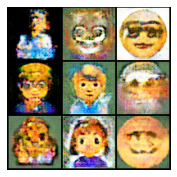

485:48
Epoch #1041 / 2000, Generator Loss: 32.443626403808594, Discriminator Loss: -22.785030364990234
Epoch #1042 / 2000, Generator Loss: 33.26420593261719, Discriminator Loss: -26.08986473083496
Epoch #1043 / 2000, Generator Loss: 32.29468536376953, Discriminator Loss: -20.912246704101562
Epoch #1044 / 2000, Generator Loss: 30.80654525756836, Discriminator Loss: -28.49904441833496
Generated images for Epoch #1044:


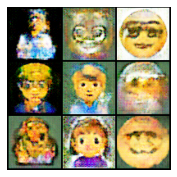

487:15
Epoch #1045 / 2000, Generator Loss: 33.20386505126953, Discriminator Loss: -25.099044799804688
Epoch #1046 / 2000, Generator Loss: 32.199588775634766, Discriminator Loss: -20.276891708374023
Epoch #1047 / 2000, Generator Loss: 32.31402587890625, Discriminator Loss: -28.107301712036133
Epoch #1048 / 2000, Generator Loss: 31.82792091369629, Discriminator Loss: -18.719770431518555
Generated images for Epoch #1048:


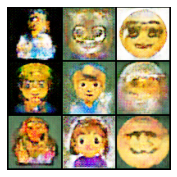

488:45
Epoch #1049 / 2000, Generator Loss: 31.400636672973633, Discriminator Loss: -24.831323623657227
Epoch #1050 / 2000, Generator Loss: 29.480838775634766, Discriminator Loss: -21.461027145385742
Epoch #1051 / 2000, Generator Loss: 31.579538345336914, Discriminator Loss: -23.699800491333008
Epoch #1052 / 2000, Generator Loss: 32.81466293334961, Discriminator Loss: -28.946998596191406
Generated images for Epoch #1052:


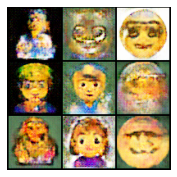

490:19
Epoch #1053 / 2000, Generator Loss: 30.771259307861328, Discriminator Loss: -27.740203857421875
Epoch #1054 / 2000, Generator Loss: 31.36513900756836, Discriminator Loss: -23.77948760986328
Epoch #1055 / 2000, Generator Loss: 33.53059005737305, Discriminator Loss: -23.914445877075195
Epoch #1056 / 2000, Generator Loss: 31.09934425354004, Discriminator Loss: -26.32343292236328
Generated images for Epoch #1056:


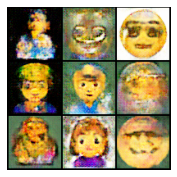

491:53
Epoch #1057 / 2000, Generator Loss: 31.90203094482422, Discriminator Loss: -26.859140396118164
Epoch #1058 / 2000, Generator Loss: 30.800437927246094, Discriminator Loss: -28.228239059448242
Epoch #1059 / 2000, Generator Loss: 29.403589248657227, Discriminator Loss: -29.427576065063477
Epoch #1060 / 2000, Generator Loss: 33.32046890258789, Discriminator Loss: -24.539966583251953
Generated images for Epoch #1060:


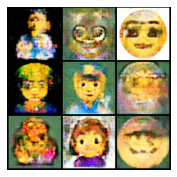

493:28
Epoch #1061 / 2000, Generator Loss: 32.166038513183594, Discriminator Loss: -25.080047607421875
Epoch #1062 / 2000, Generator Loss: 33.21467971801758, Discriminator Loss: -22.26309585571289
Epoch #1063 / 2000, Generator Loss: 30.500286102294922, Discriminator Loss: -23.756061553955078
Epoch #1064 / 2000, Generator Loss: 32.67094421386719, Discriminator Loss: -22.518878936767578
Generated images for Epoch #1064:


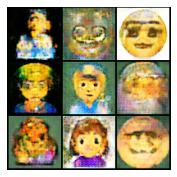

495:05
Epoch #1065 / 2000, Generator Loss: 31.4006290435791, Discriminator Loss: -24.558589935302734
Epoch #1066 / 2000, Generator Loss: 31.23963165283203, Discriminator Loss: -24.331729888916016
Epoch #1067 / 2000, Generator Loss: 30.767330169677734, Discriminator Loss: -23.498340606689453
Epoch #1068 / 2000, Generator Loss: 30.775054931640625, Discriminator Loss: -22.68834686279297
Generated images for Epoch #1068:


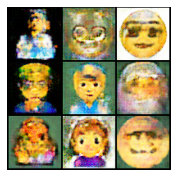

496:42
Epoch #1069 / 2000, Generator Loss: 32.11267852783203, Discriminator Loss: -21.447494506835938
Epoch #1070 / 2000, Generator Loss: 33.1973876953125, Discriminator Loss: -21.768383026123047
Epoch #1071 / 2000, Generator Loss: 31.176467895507812, Discriminator Loss: -23.75080680847168
Epoch #1072 / 2000, Generator Loss: 32.98146438598633, Discriminator Loss: -23.285335540771484
Generated images for Epoch #1072:


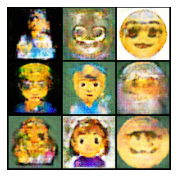

498:20
Epoch #1073 / 2000, Generator Loss: 31.985780715942383, Discriminator Loss: -22.155193328857422
Epoch #1074 / 2000, Generator Loss: 31.950286865234375, Discriminator Loss: -28.776443481445312
Epoch #1075 / 2000, Generator Loss: 29.741607666015625, Discriminator Loss: -24.420001983642578
Epoch #1076 / 2000, Generator Loss: 32.54316711425781, Discriminator Loss: -25.419971466064453
Generated images for Epoch #1076:


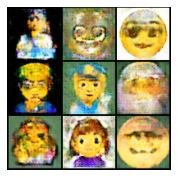

499:59
Epoch #1077 / 2000, Generator Loss: 31.209630966186523, Discriminator Loss: -26.757709503173828
Epoch #1078 / 2000, Generator Loss: 32.64424133300781, Discriminator Loss: -19.30980682373047
Epoch #1079 / 2000, Generator Loss: 33.74153137207031, Discriminator Loss: -23.791526794433594
Epoch #1080 / 2000, Generator Loss: 32.103153228759766, Discriminator Loss: -30.58629608154297
Generated images for Epoch #1080:


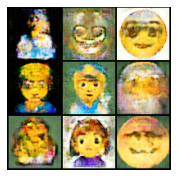

501:38
Epoch #1081 / 2000, Generator Loss: 32.61909866333008, Discriminator Loss: -23.977787017822266
Epoch #1082 / 2000, Generator Loss: 32.867958068847656, Discriminator Loss: -21.180662155151367
Epoch #1083 / 2000, Generator Loss: 31.75517463684082, Discriminator Loss: -27.46332359313965
Epoch #1084 / 2000, Generator Loss: 32.43143844604492, Discriminator Loss: -22.408586502075195
Generated images for Epoch #1084:


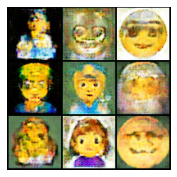

503:19
Epoch #1085 / 2000, Generator Loss: 31.636035919189453, Discriminator Loss: -25.51392364501953
Epoch #1086 / 2000, Generator Loss: 32.256465911865234, Discriminator Loss: -21.42551040649414
Epoch #1087 / 2000, Generator Loss: 31.117042541503906, Discriminator Loss: -24.21963119506836
Epoch #1088 / 2000, Generator Loss: 33.022918701171875, Discriminator Loss: -21.833782196044922
Generated images for Epoch #1088:


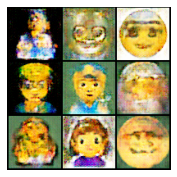

505:00
Epoch #1089 / 2000, Generator Loss: 33.05015563964844, Discriminator Loss: -24.520008087158203
Epoch #1090 / 2000, Generator Loss: 31.576168060302734, Discriminator Loss: -22.68239974975586
Epoch #1091 / 2000, Generator Loss: 31.520509719848633, Discriminator Loss: -23.51814842224121
Epoch #1092 / 2000, Generator Loss: 31.329273223876953, Discriminator Loss: -25.26508903503418
Generated images for Epoch #1092:


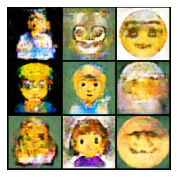

506:43
Epoch #1093 / 2000, Generator Loss: 32.91160202026367, Discriminator Loss: -19.342666625976562
Epoch #1094 / 2000, Generator Loss: 32.97954559326172, Discriminator Loss: -22.045984268188477
Epoch #1095 / 2000, Generator Loss: 32.96031951904297, Discriminator Loss: -19.534713745117188
Epoch #1096 / 2000, Generator Loss: 33.56653594970703, Discriminator Loss: -22.042484283447266
Generated images for Epoch #1096:


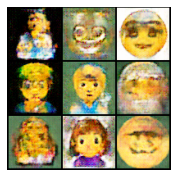

508:24
Epoch #1097 / 2000, Generator Loss: 31.722204208374023, Discriminator Loss: -27.634532928466797
Epoch #1098 / 2000, Generator Loss: 32.093467712402344, Discriminator Loss: -16.666000366210938
Epoch #1099 / 2000, Generator Loss: 32.375267028808594, Discriminator Loss: -25.70096206665039
Epoch #1100 / 2000, Generator Loss: 33.31787872314453, Discriminator Loss: -23.660484313964844
Generated images for Epoch #1100:


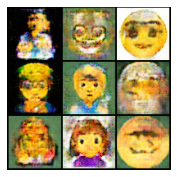

510:06
Epoch #1101 / 2000, Generator Loss: 33.12603759765625, Discriminator Loss: -25.63101577758789
Epoch #1102 / 2000, Generator Loss: 32.564395904541016, Discriminator Loss: -24.847881317138672
Epoch #1103 / 2000, Generator Loss: 31.66922378540039, Discriminator Loss: -29.702085494995117
Epoch #1104 / 2000, Generator Loss: 33.20790100097656, Discriminator Loss: -23.85771369934082
Generated images for Epoch #1104:


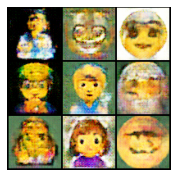

511:50
Epoch #1105 / 2000, Generator Loss: 32.67487335205078, Discriminator Loss: -22.281986236572266
Epoch #1106 / 2000, Generator Loss: 30.522865295410156, Discriminator Loss: -22.887752532958984
Epoch #1107 / 2000, Generator Loss: 33.51249694824219, Discriminator Loss: -20.81293487548828
Epoch #1108 / 2000, Generator Loss: 33.92449951171875, Discriminator Loss: -23.139602661132812
Generated images for Epoch #1108:


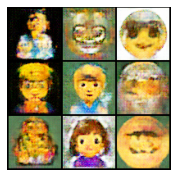

513:33
Epoch #1109 / 2000, Generator Loss: 34.70832061767578, Discriminator Loss: -24.684282302856445
Epoch #1110 / 2000, Generator Loss: 35.31962585449219, Discriminator Loss: -29.128793716430664
Epoch #1111 / 2000, Generator Loss: 32.859283447265625, Discriminator Loss: -26.028972625732422
Epoch #1112 / 2000, Generator Loss: 33.023895263671875, Discriminator Loss: -23.67814826965332
Generated images for Epoch #1112:


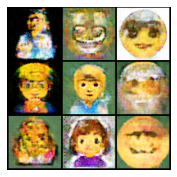

515:16
Epoch #1113 / 2000, Generator Loss: 32.81169891357422, Discriminator Loss: -24.084413528442383
Epoch #1114 / 2000, Generator Loss: 34.250396728515625, Discriminator Loss: -22.090362548828125
Epoch #1115 / 2000, Generator Loss: 32.87285232543945, Discriminator Loss: -23.175251007080078
Epoch #1116 / 2000, Generator Loss: 35.023109436035156, Discriminator Loss: -15.510756492614746
Generated images for Epoch #1116:


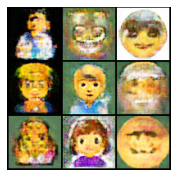

516:58
Epoch #1117 / 2000, Generator Loss: 31.028209686279297, Discriminator Loss: -20.377685546875
Epoch #1118 / 2000, Generator Loss: 34.37608337402344, Discriminator Loss: -19.150510787963867
Epoch #1119 / 2000, Generator Loss: 33.03123474121094, Discriminator Loss: -28.02932357788086
Epoch #1120 / 2000, Generator Loss: 32.926414489746094, Discriminator Loss: -25.080732345581055
Generated images for Epoch #1120:


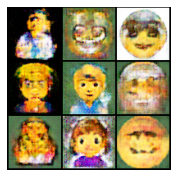

518:42
Epoch #1121 / 2000, Generator Loss: 35.154022216796875, Discriminator Loss: -25.456275939941406
Epoch #1122 / 2000, Generator Loss: 32.635963439941406, Discriminator Loss: -24.91646385192871
Epoch #1123 / 2000, Generator Loss: 33.27264404296875, Discriminator Loss: -21.849319458007812
Epoch #1124 / 2000, Generator Loss: 31.780860900878906, Discriminator Loss: -26.68425750732422
Generated images for Epoch #1124:


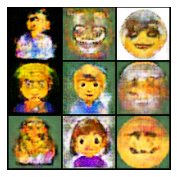

520:23
Epoch #1125 / 2000, Generator Loss: 33.58909606933594, Discriminator Loss: -22.936851501464844
Epoch #1126 / 2000, Generator Loss: 34.018272399902344, Discriminator Loss: -18.89888572692871
Epoch #1127 / 2000, Generator Loss: 32.42274475097656, Discriminator Loss: -25.895618438720703
Epoch #1128 / 2000, Generator Loss: 33.18619918823242, Discriminator Loss: -25.374496459960938
Generated images for Epoch #1128:


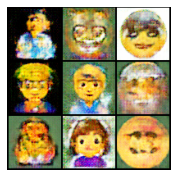

522:05
Epoch #1129 / 2000, Generator Loss: 34.11779022216797, Discriminator Loss: -22.30431365966797
Epoch #1130 / 2000, Generator Loss: 33.71784210205078, Discriminator Loss: -26.537368774414062
Epoch #1131 / 2000, Generator Loss: 34.15544891357422, Discriminator Loss: -26.300729751586914
Epoch #1132 / 2000, Generator Loss: 34.45572280883789, Discriminator Loss: -25.19157600402832
Generated images for Epoch #1132:


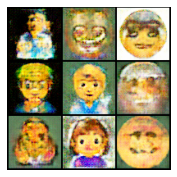

523:48
Epoch #1133 / 2000, Generator Loss: 32.51725769042969, Discriminator Loss: -25.695419311523438
Epoch #1134 / 2000, Generator Loss: 33.119361877441406, Discriminator Loss: -24.74590301513672
Epoch #1135 / 2000, Generator Loss: 32.81765365600586, Discriminator Loss: -24.977642059326172
Epoch #1136 / 2000, Generator Loss: 35.88978576660156, Discriminator Loss: -22.672672271728516
Generated images for Epoch #1136:


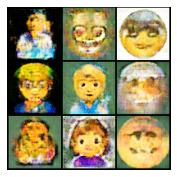

525:28
Epoch #1137 / 2000, Generator Loss: 32.98509216308594, Discriminator Loss: -21.049171447753906
Epoch #1138 / 2000, Generator Loss: 33.588714599609375, Discriminator Loss: -24.07765007019043
Epoch #1139 / 2000, Generator Loss: 33.825592041015625, Discriminator Loss: -24.870092391967773
Epoch #1140 / 2000, Generator Loss: 34.17078399658203, Discriminator Loss: -23.837825775146484
Generated images for Epoch #1140:


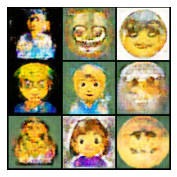

527:10
Epoch #1141 / 2000, Generator Loss: 34.082706451416016, Discriminator Loss: -22.0602970123291
Epoch #1142 / 2000, Generator Loss: 32.08615493774414, Discriminator Loss: -22.518156051635742
Epoch #1143 / 2000, Generator Loss: 33.153717041015625, Discriminator Loss: -27.086471557617188
Epoch #1144 / 2000, Generator Loss: 37.09495544433594, Discriminator Loss: -22.61149787902832
Generated images for Epoch #1144:


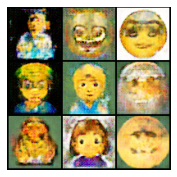

528:52
Epoch #1145 / 2000, Generator Loss: 34.490257263183594, Discriminator Loss: -24.019729614257812
Epoch #1146 / 2000, Generator Loss: 33.2215461730957, Discriminator Loss: -20.834701538085938
Epoch #1147 / 2000, Generator Loss: 34.769012451171875, Discriminator Loss: -24.592666625976562
Epoch #1148 / 2000, Generator Loss: 36.405059814453125, Discriminator Loss: -24.401874542236328
Generated images for Epoch #1148:


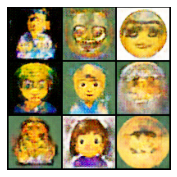

530:36
Epoch #1149 / 2000, Generator Loss: 36.6655158996582, Discriminator Loss: -23.773876190185547
Epoch #1150 / 2000, Generator Loss: 33.500606536865234, Discriminator Loss: -28.4752140045166
Epoch #1151 / 2000, Generator Loss: 35.364418029785156, Discriminator Loss: -30.35683250427246
Epoch #1152 / 2000, Generator Loss: 34.92382049560547, Discriminator Loss: -24.66543197631836
Generated images for Epoch #1152:


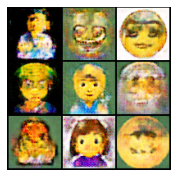

532:22
Epoch #1153 / 2000, Generator Loss: 35.06111145019531, Discriminator Loss: -22.562501907348633
Epoch #1154 / 2000, Generator Loss: 37.142372131347656, Discriminator Loss: -21.030372619628906
Epoch #1155 / 2000, Generator Loss: 33.761077880859375, Discriminator Loss: -22.791545867919922
Epoch #1156 / 2000, Generator Loss: 34.94129943847656, Discriminator Loss: -27.749122619628906
Generated images for Epoch #1156:


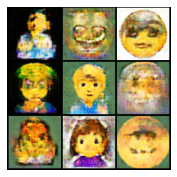

534:07
Epoch #1157 / 2000, Generator Loss: 34.31010818481445, Discriminator Loss: -26.61612319946289
Epoch #1158 / 2000, Generator Loss: 35.5661735534668, Discriminator Loss: -22.344554901123047
Epoch #1159 / 2000, Generator Loss: 34.678245544433594, Discriminator Loss: -22.35839080810547
Epoch #1160 / 2000, Generator Loss: 33.902740478515625, Discriminator Loss: -28.18144416809082
Generated images for Epoch #1160:


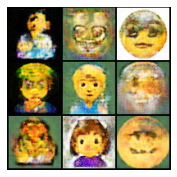

535:52
Epoch #1161 / 2000, Generator Loss: 36.526214599609375, Discriminator Loss: -20.206829071044922
Epoch #1162 / 2000, Generator Loss: 36.73817443847656, Discriminator Loss: -24.291372299194336
Epoch #1163 / 2000, Generator Loss: 35.4451904296875, Discriminator Loss: -20.698322296142578
Epoch #1164 / 2000, Generator Loss: 35.22760009765625, Discriminator Loss: -23.824901580810547
Generated images for Epoch #1164:


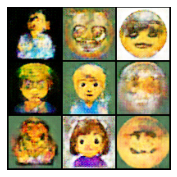

537:38
Epoch #1165 / 2000, Generator Loss: 36.354793548583984, Discriminator Loss: -20.663625717163086
Epoch #1166 / 2000, Generator Loss: 33.44303894042969, Discriminator Loss: -26.413009643554688
Epoch #1167 / 2000, Generator Loss: 36.730072021484375, Discriminator Loss: -21.789592742919922
Epoch #1168 / 2000, Generator Loss: 34.59669494628906, Discriminator Loss: -18.91983413696289
Generated images for Epoch #1168:


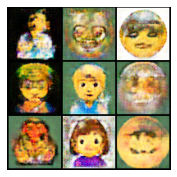

539:24
Epoch #1169 / 2000, Generator Loss: 34.867469787597656, Discriminator Loss: -18.711732864379883
Epoch #1170 / 2000, Generator Loss: 35.564186096191406, Discriminator Loss: -22.987552642822266
Epoch #1171 / 2000, Generator Loss: 34.2853889465332, Discriminator Loss: -22.80560302734375
Epoch #1172 / 2000, Generator Loss: 35.324073791503906, Discriminator Loss: -26.34966278076172
Generated images for Epoch #1172:


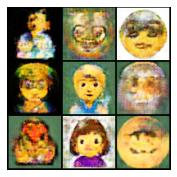

541:09
Epoch #1173 / 2000, Generator Loss: 36.55426025390625, Discriminator Loss: -22.254024505615234
Epoch #1174 / 2000, Generator Loss: 34.03315353393555, Discriminator Loss: -26.27698516845703
Epoch #1175 / 2000, Generator Loss: 34.33260726928711, Discriminator Loss: -24.95616912841797
Epoch #1176 / 2000, Generator Loss: 35.77471923828125, Discriminator Loss: -28.034854888916016
Generated images for Epoch #1176:


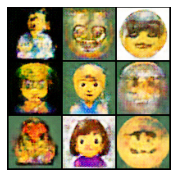

542:54
Epoch #1177 / 2000, Generator Loss: 34.728668212890625, Discriminator Loss: -24.12303924560547
Epoch #1178 / 2000, Generator Loss: 33.17559051513672, Discriminator Loss: -24.032501220703125
Epoch #1179 / 2000, Generator Loss: 35.07273483276367, Discriminator Loss: -28.941482543945312
Epoch #1180 / 2000, Generator Loss: 37.0777587890625, Discriminator Loss: -26.25929832458496
Generated images for Epoch #1180:


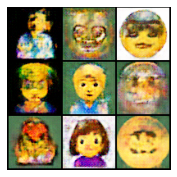

544:40
Epoch #1181 / 2000, Generator Loss: 35.20527267456055, Discriminator Loss: -19.297142028808594
Epoch #1182 / 2000, Generator Loss: 36.87600326538086, Discriminator Loss: -23.31000328063965
Epoch #1183 / 2000, Generator Loss: 36.311767578125, Discriminator Loss: -28.21335220336914
Epoch #1184 / 2000, Generator Loss: 37.17866516113281, Discriminator Loss: -24.57659149169922
Generated images for Epoch #1184:


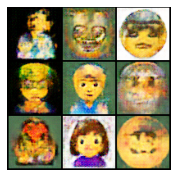

546:25
Epoch #1185 / 2000, Generator Loss: 34.8664665222168, Discriminator Loss: -21.326412200927734
Epoch #1186 / 2000, Generator Loss: 36.65471649169922, Discriminator Loss: -24.22214126586914
Epoch #1187 / 2000, Generator Loss: 37.96797180175781, Discriminator Loss: -22.384368896484375
Epoch #1188 / 2000, Generator Loss: 35.286659240722656, Discriminator Loss: -21.95633316040039
Generated images for Epoch #1188:


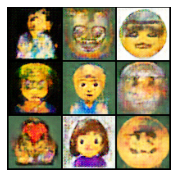

548:11
Epoch #1189 / 2000, Generator Loss: 35.59375, Discriminator Loss: -26.665172576904297
Epoch #1190 / 2000, Generator Loss: 36.788333892822266, Discriminator Loss: -23.66080093383789
Epoch #1191 / 2000, Generator Loss: 36.15556716918945, Discriminator Loss: -22.651077270507812
Epoch #1192 / 2000, Generator Loss: 35.65513229370117, Discriminator Loss: -23.5196475982666
Generated images for Epoch #1192:


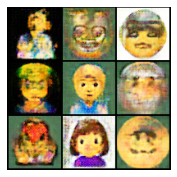

549:57
Epoch #1193 / 2000, Generator Loss: 35.153160095214844, Discriminator Loss: -21.15799331665039
Epoch #1194 / 2000, Generator Loss: 37.691734313964844, Discriminator Loss: -22.669530868530273
Epoch #1195 / 2000, Generator Loss: 37.449337005615234, Discriminator Loss: -25.299299240112305
Epoch #1196 / 2000, Generator Loss: 35.4613151550293, Discriminator Loss: -26.639774322509766
Generated images for Epoch #1196:


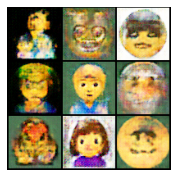

552:00
Epoch #1197 / 2000, Generator Loss: 37.65362548828125, Discriminator Loss: -23.283138275146484
Epoch #1198 / 2000, Generator Loss: 38.23479080200195, Discriminator Loss: -21.51471710205078
Epoch #1199 / 2000, Generator Loss: 37.547203063964844, Discriminator Loss: -22.330615997314453
Epoch #1200 / 2000, Generator Loss: 36.48041534423828, Discriminator Loss: -24.056734085083008
Generated images for Epoch #1200:


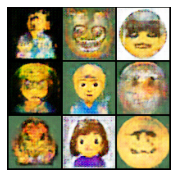

553:45
Epoch #1201 / 2000, Generator Loss: 37.595680236816406, Discriminator Loss: -23.488262176513672
Epoch #1202 / 2000, Generator Loss: 36.926551818847656, Discriminator Loss: -27.58468246459961
Epoch #1203 / 2000, Generator Loss: 36.627960205078125, Discriminator Loss: -26.710617065429688
Epoch #1204 / 2000, Generator Loss: 33.85941696166992, Discriminator Loss: -22.504501342773438
Generated images for Epoch #1204:


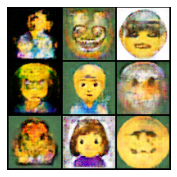

555:30
Epoch #1205 / 2000, Generator Loss: 36.04802703857422, Discriminator Loss: -26.605010986328125
Epoch #1206 / 2000, Generator Loss: 36.7786750793457, Discriminator Loss: -26.077266693115234
Epoch #1207 / 2000, Generator Loss: 35.70439910888672, Discriminator Loss: -28.243539810180664
Epoch #1208 / 2000, Generator Loss: 38.675743103027344, Discriminator Loss: -22.670700073242188
Generated images for Epoch #1208:


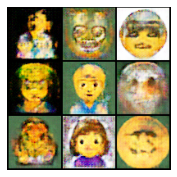

557:16
Epoch #1209 / 2000, Generator Loss: 37.96183776855469, Discriminator Loss: -22.106908798217773
Epoch #1210 / 2000, Generator Loss: 37.04568862915039, Discriminator Loss: -21.484621047973633
Epoch #1211 / 2000, Generator Loss: 35.96338653564453, Discriminator Loss: -26.09457778930664
Epoch #1212 / 2000, Generator Loss: 36.9472541809082, Discriminator Loss: -27.60239028930664
Generated images for Epoch #1212:


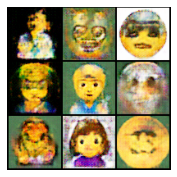

558:59
Epoch #1213 / 2000, Generator Loss: 37.87861633300781, Discriminator Loss: -24.91162109375
Epoch #1214 / 2000, Generator Loss: 37.31521987915039, Discriminator Loss: -20.452463150024414
Epoch #1215 / 2000, Generator Loss: 36.6665153503418, Discriminator Loss: -24.638160705566406
Epoch #1216 / 2000, Generator Loss: 38.00543975830078, Discriminator Loss: -24.514785766601562
Generated images for Epoch #1216:


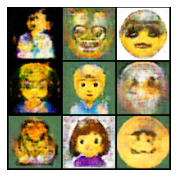

560:16
Epoch #1217 / 2000, Generator Loss: 37.3052978515625, Discriminator Loss: -25.009979248046875
Epoch #1218 / 2000, Generator Loss: 36.340423583984375, Discriminator Loss: -22.327621459960938
Epoch #1219 / 2000, Generator Loss: 37.4317626953125, Discriminator Loss: -22.216495513916016
Epoch #1220 / 2000, Generator Loss: 37.82453536987305, Discriminator Loss: -24.198936462402344
Generated images for Epoch #1220:


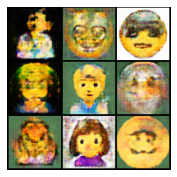

561:33
Epoch #1221 / 2000, Generator Loss: 37.92452621459961, Discriminator Loss: -25.37310218811035
Epoch #1222 / 2000, Generator Loss: 38.90734100341797, Discriminator Loss: -24.46719741821289
Epoch #1223 / 2000, Generator Loss: 37.55506134033203, Discriminator Loss: -23.400535583496094
Epoch #1224 / 2000, Generator Loss: 37.546878814697266, Discriminator Loss: -22.05126190185547
Generated images for Epoch #1224:


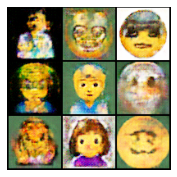

562:50
Epoch #1225 / 2000, Generator Loss: 35.51409912109375, Discriminator Loss: -24.74747085571289
Epoch #1226 / 2000, Generator Loss: 40.61317825317383, Discriminator Loss: -22.58138656616211
Epoch #1227 / 2000, Generator Loss: 37.016510009765625, Discriminator Loss: -23.445087432861328
Epoch #1228 / 2000, Generator Loss: 36.60056686401367, Discriminator Loss: -25.53213882446289
Generated images for Epoch #1228:


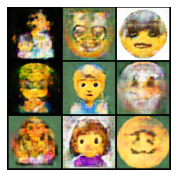

564:07
Epoch #1229 / 2000, Generator Loss: 37.60088348388672, Discriminator Loss: -24.843795776367188
Epoch #1230 / 2000, Generator Loss: 39.00812911987305, Discriminator Loss: -26.503623962402344
Epoch #1231 / 2000, Generator Loss: 35.64406967163086, Discriminator Loss: -23.056015014648438
Epoch #1232 / 2000, Generator Loss: 40.95363998413086, Discriminator Loss: -20.748641967773438
Generated images for Epoch #1232:


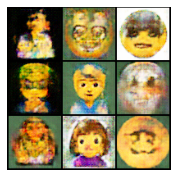

565:23
Epoch #1233 / 2000, Generator Loss: 38.27233123779297, Discriminator Loss: -25.24726104736328
Epoch #1234 / 2000, Generator Loss: 38.860382080078125, Discriminator Loss: -21.42276382446289
Epoch #1235 / 2000, Generator Loss: 38.34978485107422, Discriminator Loss: -21.23375129699707
Epoch #1236 / 2000, Generator Loss: 37.534584045410156, Discriminator Loss: -24.772356033325195
Generated images for Epoch #1236:


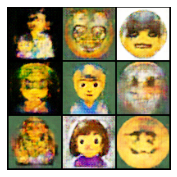

566:40
Epoch #1237 / 2000, Generator Loss: 40.00720977783203, Discriminator Loss: -22.981966018676758
Epoch #1238 / 2000, Generator Loss: 37.550689697265625, Discriminator Loss: -26.005695343017578
Epoch #1239 / 2000, Generator Loss: 39.072715759277344, Discriminator Loss: -22.351266860961914
Epoch #1240 / 2000, Generator Loss: 38.6082878112793, Discriminator Loss: -22.91976547241211
Generated images for Epoch #1240:


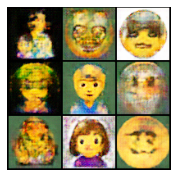

567:57
Epoch #1241 / 2000, Generator Loss: 39.70451354980469, Discriminator Loss: -25.33319091796875
Epoch #1242 / 2000, Generator Loss: 37.074913024902344, Discriminator Loss: -29.184185028076172
Epoch #1243 / 2000, Generator Loss: 37.51718521118164, Discriminator Loss: -21.681182861328125
Epoch #1244 / 2000, Generator Loss: 37.62342071533203, Discriminator Loss: -22.934078216552734
Generated images for Epoch #1244:


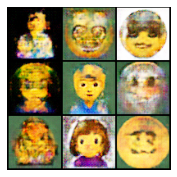

569:15
Epoch #1245 / 2000, Generator Loss: 38.417362213134766, Discriminator Loss: -24.791900634765625
Epoch #1246 / 2000, Generator Loss: 39.82868957519531, Discriminator Loss: -23.581329345703125
Epoch #1247 / 2000, Generator Loss: 37.93808364868164, Discriminator Loss: -20.10208511352539
Epoch #1248 / 2000, Generator Loss: 38.82225036621094, Discriminator Loss: -22.47244644165039
Generated images for Epoch #1248:


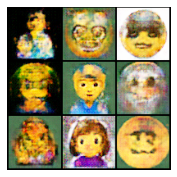

570:33
Epoch #1249 / 2000, Generator Loss: 38.418556213378906, Discriminator Loss: -22.902355194091797
Epoch #1250 / 2000, Generator Loss: 36.96409606933594, Discriminator Loss: -23.105716705322266
Epoch #1251 / 2000, Generator Loss: 40.162254333496094, Discriminator Loss: -21.48050880432129
Epoch #1252 / 2000, Generator Loss: 37.723968505859375, Discriminator Loss: -27.408193588256836
Generated images for Epoch #1252:


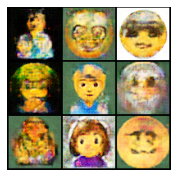

571:50
Epoch #1253 / 2000, Generator Loss: 39.231666564941406, Discriminator Loss: -23.270736694335938
Epoch #1254 / 2000, Generator Loss: 38.76350784301758, Discriminator Loss: -20.375003814697266
Epoch #1255 / 2000, Generator Loss: 39.67140197753906, Discriminator Loss: -21.553728103637695
Epoch #1256 / 2000, Generator Loss: 38.96562194824219, Discriminator Loss: -21.490530014038086
Generated images for Epoch #1256:


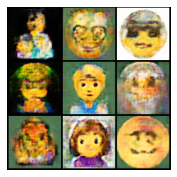

573:07
Epoch #1257 / 2000, Generator Loss: 36.34954071044922, Discriminator Loss: -24.727771759033203
Epoch #1258 / 2000, Generator Loss: 39.964927673339844, Discriminator Loss: -22.894580841064453
Epoch #1259 / 2000, Generator Loss: 37.537078857421875, Discriminator Loss: -23.225582122802734
Epoch #1260 / 2000, Generator Loss: 38.042724609375, Discriminator Loss: -20.67835235595703
Generated images for Epoch #1260:


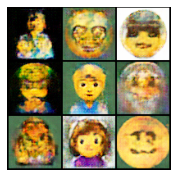

574:24
Epoch #1261 / 2000, Generator Loss: 38.31376647949219, Discriminator Loss: -22.574338912963867
Epoch #1262 / 2000, Generator Loss: 39.55043029785156, Discriminator Loss: -18.621337890625
Epoch #1263 / 2000, Generator Loss: 38.78349304199219, Discriminator Loss: -19.350683212280273
Epoch #1264 / 2000, Generator Loss: 39.689857482910156, Discriminator Loss: -23.187227249145508
Generated images for Epoch #1264:


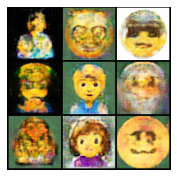

575:42
Epoch #1265 / 2000, Generator Loss: 38.683013916015625, Discriminator Loss: -19.350093841552734
Epoch #1266 / 2000, Generator Loss: 38.24467849731445, Discriminator Loss: -19.175569534301758
Epoch #1267 / 2000, Generator Loss: 39.53162384033203, Discriminator Loss: -25.806007385253906
Epoch #1268 / 2000, Generator Loss: 38.33005905151367, Discriminator Loss: -24.03352928161621
Generated images for Epoch #1268:


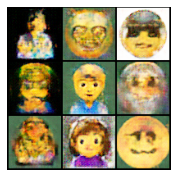

576:59
Epoch #1269 / 2000, Generator Loss: 38.65898132324219, Discriminator Loss: -25.662147521972656
Epoch #1270 / 2000, Generator Loss: 38.85270690917969, Discriminator Loss: -24.714080810546875
Epoch #1271 / 2000, Generator Loss: 37.298492431640625, Discriminator Loss: -27.419496536254883
Epoch #1272 / 2000, Generator Loss: 38.09727478027344, Discriminator Loss: -23.022281646728516
Generated images for Epoch #1272:


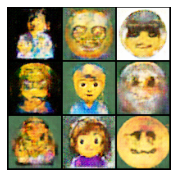

578:16
Epoch #1273 / 2000, Generator Loss: 37.56258010864258, Discriminator Loss: -26.06572723388672
Epoch #1274 / 2000, Generator Loss: 39.16761779785156, Discriminator Loss: -24.863161087036133
Epoch #1275 / 2000, Generator Loss: 37.432762145996094, Discriminator Loss: -27.90670394897461
Epoch #1276 / 2000, Generator Loss: 39.45262145996094, Discriminator Loss: -20.396038055419922
Generated images for Epoch #1276:


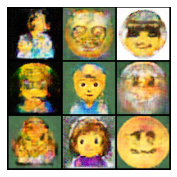

579:34
Epoch #1277 / 2000, Generator Loss: 40.286685943603516, Discriminator Loss: -24.370634078979492
Epoch #1278 / 2000, Generator Loss: 38.60326385498047, Discriminator Loss: -18.988937377929688
Epoch #1279 / 2000, Generator Loss: 38.16347885131836, Discriminator Loss: -28.011825561523438
Epoch #1280 / 2000, Generator Loss: 40.26901626586914, Discriminator Loss: -26.407106399536133
Generated images for Epoch #1280:


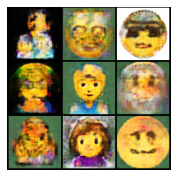

581:19
Epoch #1281 / 2000, Generator Loss: 38.46643829345703, Discriminator Loss: -25.15180778503418
Epoch #1282 / 2000, Generator Loss: 41.22657775878906, Discriminator Loss: -22.166433334350586
Epoch #1283 / 2000, Generator Loss: 39.524200439453125, Discriminator Loss: -25.116653442382812
Epoch #1284 / 2000, Generator Loss: 42.05622100830078, Discriminator Loss: -22.341487884521484
Generated images for Epoch #1284:


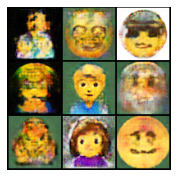

582:36
Epoch #1285 / 2000, Generator Loss: 38.92811584472656, Discriminator Loss: -27.823505401611328
Epoch #1286 / 2000, Generator Loss: 39.92170715332031, Discriminator Loss: -23.031160354614258
Epoch #1287 / 2000, Generator Loss: 42.11777114868164, Discriminator Loss: -21.41006851196289
Epoch #1288 / 2000, Generator Loss: 40.513710021972656, Discriminator Loss: -27.329458236694336
Generated images for Epoch #1288:


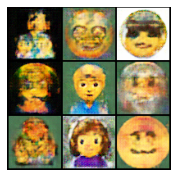

583:53
Epoch #1289 / 2000, Generator Loss: 40.31528854370117, Discriminator Loss: -25.728313446044922
Epoch #1290 / 2000, Generator Loss: 41.27857971191406, Discriminator Loss: -23.087310791015625
Epoch #1291 / 2000, Generator Loss: 41.041717529296875, Discriminator Loss: -23.14969253540039
Epoch #1292 / 2000, Generator Loss: 40.453521728515625, Discriminator Loss: -19.513105392456055
Generated images for Epoch #1292:


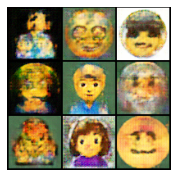

585:10
Epoch #1293 / 2000, Generator Loss: 40.180328369140625, Discriminator Loss: -27.294559478759766
Epoch #1294 / 2000, Generator Loss: 40.182891845703125, Discriminator Loss: -25.668731689453125
Epoch #1295 / 2000, Generator Loss: 40.12492752075195, Discriminator Loss: -26.12358283996582
Epoch #1296 / 2000, Generator Loss: 40.797725677490234, Discriminator Loss: -22.49338150024414
Generated images for Epoch #1296:


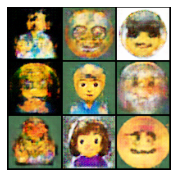

586:27
Epoch #1297 / 2000, Generator Loss: 41.899658203125, Discriminator Loss: -26.634464263916016
Epoch #1298 / 2000, Generator Loss: 42.35271453857422, Discriminator Loss: -21.49374008178711
Epoch #1299 / 2000, Generator Loss: 40.5565185546875, Discriminator Loss: -27.021398544311523
Epoch #1300 / 2000, Generator Loss: 40.81330871582031, Discriminator Loss: -24.715866088867188
Generated images for Epoch #1300:


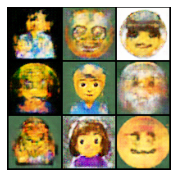

587:44
Epoch #1301 / 2000, Generator Loss: 40.946449279785156, Discriminator Loss: -26.2348690032959
Epoch #1302 / 2000, Generator Loss: 43.62335205078125, Discriminator Loss: -23.798019409179688
Epoch #1303 / 2000, Generator Loss: 41.66935729980469, Discriminator Loss: -21.927526473999023
Epoch #1304 / 2000, Generator Loss: 39.85748291015625, Discriminator Loss: -28.942771911621094
Generated images for Epoch #1304:


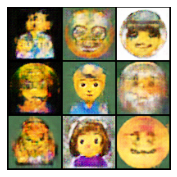

589:02
Epoch #1305 / 2000, Generator Loss: 41.49968338012695, Discriminator Loss: -20.045764923095703
Epoch #1306 / 2000, Generator Loss: 40.27179718017578, Discriminator Loss: -24.582530975341797
Epoch #1307 / 2000, Generator Loss: 40.20218276977539, Discriminator Loss: -24.18509292602539
Epoch #1308 / 2000, Generator Loss: 40.380287170410156, Discriminator Loss: -18.91994857788086
Generated images for Epoch #1308:


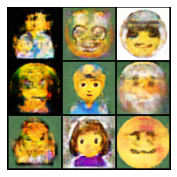

590:20
Epoch #1309 / 2000, Generator Loss: 42.03031539916992, Discriminator Loss: -22.328569412231445
Epoch #1310 / 2000, Generator Loss: 41.616966247558594, Discriminator Loss: -20.31651496887207
Epoch #1311 / 2000, Generator Loss: 43.08076095581055, Discriminator Loss: -22.306175231933594
Epoch #1312 / 2000, Generator Loss: 41.04120635986328, Discriminator Loss: -24.34557342529297
Generated images for Epoch #1312:


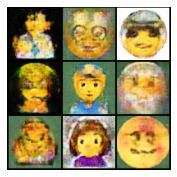

591:39
Epoch #1313 / 2000, Generator Loss: 42.30381774902344, Discriminator Loss: -20.23464584350586
Epoch #1314 / 2000, Generator Loss: 41.20964813232422, Discriminator Loss: -25.685184478759766
Epoch #1315 / 2000, Generator Loss: 39.85246276855469, Discriminator Loss: -26.241504669189453
Epoch #1316 / 2000, Generator Loss: 42.93572235107422, Discriminator Loss: -22.449602127075195
Generated images for Epoch #1316:


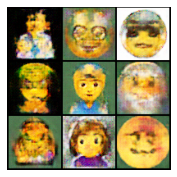

592:57
Epoch #1317 / 2000, Generator Loss: 41.661354064941406, Discriminator Loss: -25.770132064819336
Epoch #1318 / 2000, Generator Loss: 42.45012664794922, Discriminator Loss: -21.213727951049805
Epoch #1319 / 2000, Generator Loss: 40.606956481933594, Discriminator Loss: -23.703649520874023
Epoch #1320 / 2000, Generator Loss: 40.488059997558594, Discriminator Loss: -22.41094970703125
Generated images for Epoch #1320:


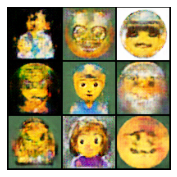

594:16
Epoch #1321 / 2000, Generator Loss: 41.803749084472656, Discriminator Loss: -25.862260818481445
Epoch #1322 / 2000, Generator Loss: 42.14308166503906, Discriminator Loss: -25.784481048583984
Epoch #1323 / 2000, Generator Loss: 41.872276306152344, Discriminator Loss: -25.20857048034668
Epoch #1324 / 2000, Generator Loss: 40.799522399902344, Discriminator Loss: -25.832439422607422
Generated images for Epoch #1324:


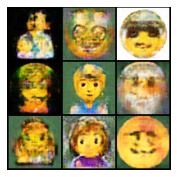

595:33
Epoch #1325 / 2000, Generator Loss: 43.401058197021484, Discriminator Loss: -22.436233520507812
Epoch #1326 / 2000, Generator Loss: 41.34235763549805, Discriminator Loss: -21.108856201171875
Epoch #1327 / 2000, Generator Loss: 43.17523193359375, Discriminator Loss: -24.573179244995117
Epoch #1328 / 2000, Generator Loss: 40.51324462890625, Discriminator Loss: -21.638092041015625
Generated images for Epoch #1328:


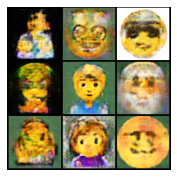

596:51
Epoch #1329 / 2000, Generator Loss: 41.50199508666992, Discriminator Loss: -26.962627410888672
Epoch #1330 / 2000, Generator Loss: 41.25630187988281, Discriminator Loss: -23.581317901611328
Epoch #1331 / 2000, Generator Loss: 40.80828857421875, Discriminator Loss: -26.228899002075195
Epoch #1332 / 2000, Generator Loss: 40.863868713378906, Discriminator Loss: -24.907690048217773
Generated images for Epoch #1332:


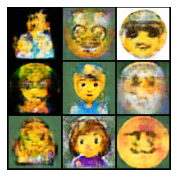

598:09
Epoch #1333 / 2000, Generator Loss: 41.246421813964844, Discriminator Loss: -26.165874481201172
Epoch #1334 / 2000, Generator Loss: 41.662864685058594, Discriminator Loss: -23.490478515625
Epoch #1335 / 2000, Generator Loss: 41.36630630493164, Discriminator Loss: -22.304628372192383
Epoch #1336 / 2000, Generator Loss: 40.01666259765625, Discriminator Loss: -26.543106079101562
Generated images for Epoch #1336:


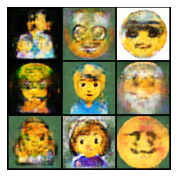

599:27
Epoch #1337 / 2000, Generator Loss: 39.71442413330078, Discriminator Loss: -24.75107192993164
Epoch #1338 / 2000, Generator Loss: 42.69688415527344, Discriminator Loss: -21.667236328125
Epoch #1339 / 2000, Generator Loss: 41.80909729003906, Discriminator Loss: -22.774051666259766
Epoch #1340 / 2000, Generator Loss: 41.00505065917969, Discriminator Loss: -23.354339599609375
Generated images for Epoch #1340:


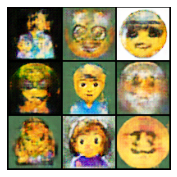

600:45
Epoch #1341 / 2000, Generator Loss: 39.24515914916992, Discriminator Loss: -25.942218780517578
Epoch #1342 / 2000, Generator Loss: 40.93219757080078, Discriminator Loss: -26.28973388671875
Epoch #1343 / 2000, Generator Loss: 41.588592529296875, Discriminator Loss: -24.896509170532227
Epoch #1344 / 2000, Generator Loss: 41.944854736328125, Discriminator Loss: -20.101806640625
Generated images for Epoch #1344:


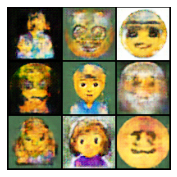

602:02
Epoch #1345 / 2000, Generator Loss: 42.26293182373047, Discriminator Loss: -21.52590560913086
Epoch #1346 / 2000, Generator Loss: 41.82735824584961, Discriminator Loss: -24.058120727539062
Epoch #1347 / 2000, Generator Loss: 40.412418365478516, Discriminator Loss: -26.745559692382812
Epoch #1348 / 2000, Generator Loss: 41.68370819091797, Discriminator Loss: -18.420381546020508
Generated images for Epoch #1348:


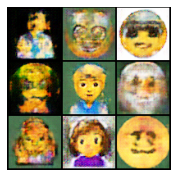

603:19
Epoch #1349 / 2000, Generator Loss: 40.87489318847656, Discriminator Loss: -20.612199783325195
Epoch #1350 / 2000, Generator Loss: 41.30998611450195, Discriminator Loss: -24.62856674194336
Epoch #1351 / 2000, Generator Loss: 42.366966247558594, Discriminator Loss: -22.37319564819336
Epoch #1352 / 2000, Generator Loss: 41.50440979003906, Discriminator Loss: -27.623918533325195
Generated images for Epoch #1352:


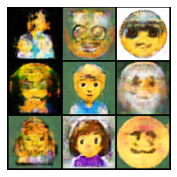

604:37
Epoch #1353 / 2000, Generator Loss: 40.09949493408203, Discriminator Loss: -19.271570205688477
Epoch #1354 / 2000, Generator Loss: 40.62164306640625, Discriminator Loss: -25.779769897460938
Epoch #1355 / 2000, Generator Loss: 41.904911041259766, Discriminator Loss: -25.635927200317383
Epoch #1356 / 2000, Generator Loss: 41.423805236816406, Discriminator Loss: -24.25619125366211
Generated images for Epoch #1356:


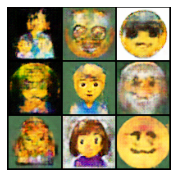

605:55
Epoch #1357 / 2000, Generator Loss: 42.280311584472656, Discriminator Loss: -24.587675094604492
Epoch #1358 / 2000, Generator Loss: 40.43312454223633, Discriminator Loss: -25.871871948242188
Epoch #1359 / 2000, Generator Loss: 40.25225830078125, Discriminator Loss: -23.748027801513672
Epoch #1360 / 2000, Generator Loss: 41.54908752441406, Discriminator Loss: -22.244783401489258
Generated images for Epoch #1360:


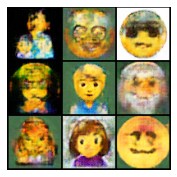

607:13
Epoch #1361 / 2000, Generator Loss: 44.187828063964844, Discriminator Loss: -20.689701080322266
Epoch #1362 / 2000, Generator Loss: 40.174774169921875, Discriminator Loss: -23.321142196655273
Epoch #1363 / 2000, Generator Loss: 41.82990264892578, Discriminator Loss: -22.57192039489746
Epoch #1364 / 2000, Generator Loss: 42.16023254394531, Discriminator Loss: -26.46183967590332
Generated images for Epoch #1364:


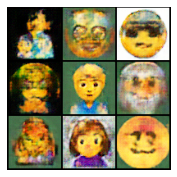

608:31
Epoch #1365 / 2000, Generator Loss: 40.283390045166016, Discriminator Loss: -19.70773696899414
Epoch #1366 / 2000, Generator Loss: 42.900028228759766, Discriminator Loss: -27.216081619262695
Epoch #1367 / 2000, Generator Loss: 40.883506774902344, Discriminator Loss: -23.429927825927734
Epoch #1368 / 2000, Generator Loss: 43.43467712402344, Discriminator Loss: -23.61011505126953
Generated images for Epoch #1368:


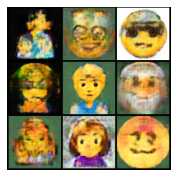

609:49
Epoch #1369 / 2000, Generator Loss: 43.00060272216797, Discriminator Loss: -27.122243881225586
Epoch #1370 / 2000, Generator Loss: 41.87428283691406, Discriminator Loss: -22.212509155273438
Epoch #1371 / 2000, Generator Loss: 42.48153305053711, Discriminator Loss: -26.41579818725586
Epoch #1372 / 2000, Generator Loss: 42.16191101074219, Discriminator Loss: -23.853565216064453
Generated images for Epoch #1372:


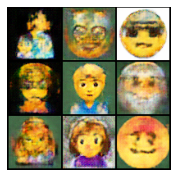

611:07
Epoch #1373 / 2000, Generator Loss: 41.97659683227539, Discriminator Loss: -28.658666610717773
Epoch #1374 / 2000, Generator Loss: 43.425987243652344, Discriminator Loss: -22.774471282958984
Epoch #1375 / 2000, Generator Loss: 42.532066345214844, Discriminator Loss: -21.34621810913086
Epoch #1376 / 2000, Generator Loss: 42.01764678955078, Discriminator Loss: -25.073665618896484
Generated images for Epoch #1376:


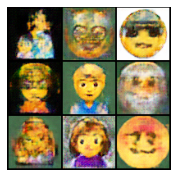

612:26
Epoch #1377 / 2000, Generator Loss: 44.02314758300781, Discriminator Loss: -23.059890747070312
Epoch #1378 / 2000, Generator Loss: 42.829010009765625, Discriminator Loss: -28.74463653564453
Epoch #1379 / 2000, Generator Loss: 42.140174865722656, Discriminator Loss: -24.387348175048828
Epoch #1380 / 2000, Generator Loss: 42.54241943359375, Discriminator Loss: -23.04650115966797
Generated images for Epoch #1380:


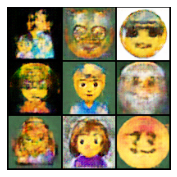

613:44
Epoch #1381 / 2000, Generator Loss: 43.61819076538086, Discriminator Loss: -22.295513153076172
Epoch #1382 / 2000, Generator Loss: 40.987815856933594, Discriminator Loss: -26.0960693359375
Epoch #1383 / 2000, Generator Loss: 42.5031623840332, Discriminator Loss: -23.527420043945312
Epoch #1384 / 2000, Generator Loss: 41.632205963134766, Discriminator Loss: -26.39234161376953
Generated images for Epoch #1384:


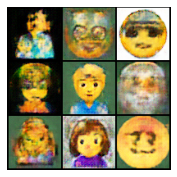

615:02
Epoch #1385 / 2000, Generator Loss: 41.234947204589844, Discriminator Loss: -26.235734939575195
Epoch #1386 / 2000, Generator Loss: 41.3419189453125, Discriminator Loss: -27.63641929626465
Epoch #1387 / 2000, Generator Loss: 40.774444580078125, Discriminator Loss: -23.27780532836914
Epoch #1388 / 2000, Generator Loss: 40.502593994140625, Discriminator Loss: -20.13810920715332
Generated images for Epoch #1388:


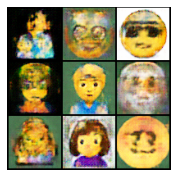

616:20
Epoch #1389 / 2000, Generator Loss: 42.22163009643555, Discriminator Loss: -24.641002655029297
Epoch #1390 / 2000, Generator Loss: 42.61555480957031, Discriminator Loss: -23.10334014892578
Epoch #1391 / 2000, Generator Loss: 41.986778259277344, Discriminator Loss: -23.699853897094727
Epoch #1392 / 2000, Generator Loss: 41.2303466796875, Discriminator Loss: -23.55938148498535
Generated images for Epoch #1392:


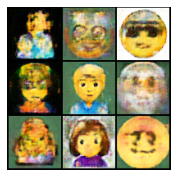

617:38
Epoch #1393 / 2000, Generator Loss: 42.94723129272461, Discriminator Loss: -27.331008911132812
Epoch #1394 / 2000, Generator Loss: 43.70494079589844, Discriminator Loss: -28.04791259765625
Epoch #1395 / 2000, Generator Loss: 41.391300201416016, Discriminator Loss: -21.30405044555664
Epoch #1396 / 2000, Generator Loss: 41.503509521484375, Discriminator Loss: -25.99822235107422
Generated images for Epoch #1396:


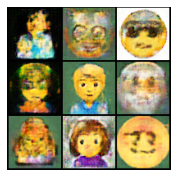

618:56
Epoch #1397 / 2000, Generator Loss: 41.22031784057617, Discriminator Loss: -23.738544464111328
Epoch #1398 / 2000, Generator Loss: 41.23997497558594, Discriminator Loss: -27.380014419555664
Epoch #1399 / 2000, Generator Loss: 43.3935546875, Discriminator Loss: -23.1984920501709
Epoch #1400 / 2000, Generator Loss: 42.05297088623047, Discriminator Loss: -23.142807006835938
Generated images for Epoch #1400:


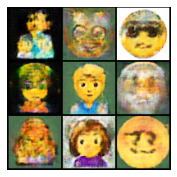

620:14
Epoch #1401 / 2000, Generator Loss: 43.130741119384766, Discriminator Loss: -20.16443634033203
Epoch #1402 / 2000, Generator Loss: 42.01518630981445, Discriminator Loss: -23.76485824584961
Epoch #1403 / 2000, Generator Loss: 43.4073600769043, Discriminator Loss: -28.977920532226562
Epoch #1404 / 2000, Generator Loss: 41.359352111816406, Discriminator Loss: -20.20711898803711
Generated images for Epoch #1404:


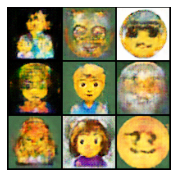

621:31
Epoch #1405 / 2000, Generator Loss: 42.02095031738281, Discriminator Loss: -22.707698822021484
Epoch #1406 / 2000, Generator Loss: 43.19429016113281, Discriminator Loss: -24.68705177307129
Epoch #1407 / 2000, Generator Loss: 41.843406677246094, Discriminator Loss: -25.558063507080078
Epoch #1408 / 2000, Generator Loss: 44.29230880737305, Discriminator Loss: -22.262859344482422
Generated images for Epoch #1408:


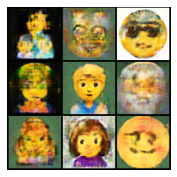

622:49
Epoch #1409 / 2000, Generator Loss: 41.38364791870117, Discriminator Loss: -21.551101684570312
Epoch #1410 / 2000, Generator Loss: 41.439125061035156, Discriminator Loss: -22.49325180053711
Epoch #1411 / 2000, Generator Loss: 42.52332305908203, Discriminator Loss: -29.48428726196289
Epoch #1412 / 2000, Generator Loss: 42.113834381103516, Discriminator Loss: -24.356081008911133
Generated images for Epoch #1412:


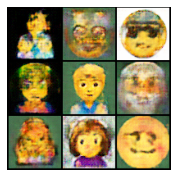

624:06
Epoch #1413 / 2000, Generator Loss: 43.25233459472656, Discriminator Loss: -19.185550689697266
Epoch #1414 / 2000, Generator Loss: 43.707176208496094, Discriminator Loss: -24.671035766601562
Epoch #1415 / 2000, Generator Loss: 42.627037048339844, Discriminator Loss: -26.483219146728516
Epoch #1416 / 2000, Generator Loss: 42.70451354980469, Discriminator Loss: -23.83148765563965
Generated images for Epoch #1416:


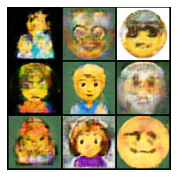

625:24
Epoch #1417 / 2000, Generator Loss: 43.67744064331055, Discriminator Loss: -28.180328369140625
Epoch #1418 / 2000, Generator Loss: 42.988800048828125, Discriminator Loss: -25.839309692382812
Epoch #1419 / 2000, Generator Loss: 42.40037536621094, Discriminator Loss: -23.048816680908203
Epoch #1420 / 2000, Generator Loss: 44.86112594604492, Discriminator Loss: -23.11188316345215
Generated images for Epoch #1420:


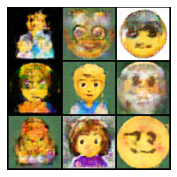

626:42
Epoch #1421 / 2000, Generator Loss: 43.72804260253906, Discriminator Loss: -22.945964813232422
Epoch #1422 / 2000, Generator Loss: 43.7040901184082, Discriminator Loss: -18.32445526123047
Epoch #1423 / 2000, Generator Loss: 41.616798400878906, Discriminator Loss: -24.555259704589844
Epoch #1424 / 2000, Generator Loss: 42.74017333984375, Discriminator Loss: -23.955852508544922
Generated images for Epoch #1424:


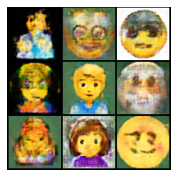

627:59
Epoch #1425 / 2000, Generator Loss: 42.341529846191406, Discriminator Loss: -23.57349395751953
Epoch #1426 / 2000, Generator Loss: 42.629154205322266, Discriminator Loss: -23.226194381713867
Epoch #1427 / 2000, Generator Loss: 43.69046401977539, Discriminator Loss: -23.997249603271484
Epoch #1428 / 2000, Generator Loss: 41.80956268310547, Discriminator Loss: -22.52159309387207
Generated images for Epoch #1428:


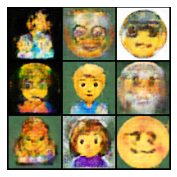

629:17
Epoch #1429 / 2000, Generator Loss: 43.509246826171875, Discriminator Loss: -24.88899040222168
Epoch #1430 / 2000, Generator Loss: 42.13587951660156, Discriminator Loss: -23.7817325592041
Epoch #1431 / 2000, Generator Loss: 44.40983963012695, Discriminator Loss: -24.260696411132812
Epoch #1432 / 2000, Generator Loss: 42.465087890625, Discriminator Loss: -21.183643341064453
Generated images for Epoch #1432:


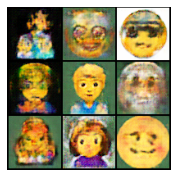

630:36
Epoch #1433 / 2000, Generator Loss: 45.1416015625, Discriminator Loss: -18.198652267456055
Epoch #1434 / 2000, Generator Loss: 44.10280227661133, Discriminator Loss: -27.239952087402344
Epoch #1435 / 2000, Generator Loss: 44.76123046875, Discriminator Loss: -24.615264892578125
Epoch #1436 / 2000, Generator Loss: 44.544677734375, Discriminator Loss: -24.07046127319336
Generated images for Epoch #1436:


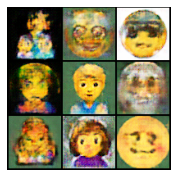

631:55
Epoch #1437 / 2000, Generator Loss: 43.9933967590332, Discriminator Loss: -19.728191375732422
Epoch #1438 / 2000, Generator Loss: 43.65236282348633, Discriminator Loss: -22.465084075927734
Epoch #1439 / 2000, Generator Loss: 40.735076904296875, Discriminator Loss: -23.370834350585938
Epoch #1440 / 2000, Generator Loss: 44.134639739990234, Discriminator Loss: -23.043743133544922
Generated images for Epoch #1440:


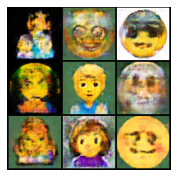

633:13
Epoch #1441 / 2000, Generator Loss: 43.176536560058594, Discriminator Loss: -26.530494689941406
Epoch #1442 / 2000, Generator Loss: 44.207183837890625, Discriminator Loss: -23.69316864013672
Epoch #1443 / 2000, Generator Loss: 43.354713439941406, Discriminator Loss: -22.420703887939453
Epoch #1444 / 2000, Generator Loss: 46.10264587402344, Discriminator Loss: -25.138885498046875
Generated images for Epoch #1444:


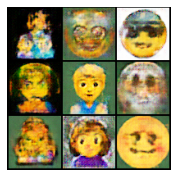

634:32
Epoch #1445 / 2000, Generator Loss: 42.52035903930664, Discriminator Loss: -26.265295028686523
Epoch #1446 / 2000, Generator Loss: 45.03478240966797, Discriminator Loss: -22.307979583740234
Epoch #1447 / 2000, Generator Loss: 46.547523498535156, Discriminator Loss: -25.662935256958008
Epoch #1448 / 2000, Generator Loss: 46.42993927001953, Discriminator Loss: -24.632511138916016
Generated images for Epoch #1448:


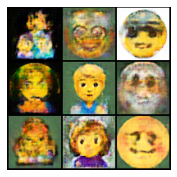

635:50
Epoch #1449 / 2000, Generator Loss: 44.65956497192383, Discriminator Loss: -26.27424430847168
Epoch #1450 / 2000, Generator Loss: 45.276771545410156, Discriminator Loss: -26.705625534057617
Epoch #1451 / 2000, Generator Loss: 45.633872985839844, Discriminator Loss: -24.603944778442383
Epoch #1452 / 2000, Generator Loss: 43.6931266784668, Discriminator Loss: -20.788997650146484
Generated images for Epoch #1452:


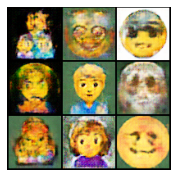

637:08
Epoch #1453 / 2000, Generator Loss: 44.98912811279297, Discriminator Loss: -24.760107040405273
Epoch #1454 / 2000, Generator Loss: 44.63950729370117, Discriminator Loss: -22.943910598754883
Epoch #1455 / 2000, Generator Loss: 44.02830123901367, Discriminator Loss: -23.676673889160156
Epoch #1456 / 2000, Generator Loss: 43.11713409423828, Discriminator Loss: -25.034711837768555
Generated images for Epoch #1456:


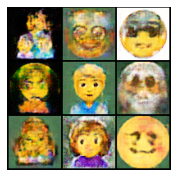

638:26
Epoch #1457 / 2000, Generator Loss: 46.03992462158203, Discriminator Loss: -23.653461456298828
Epoch #1458 / 2000, Generator Loss: 46.71491241455078, Discriminator Loss: -21.241859436035156
Epoch #1459 / 2000, Generator Loss: 44.91523742675781, Discriminator Loss: -21.94945526123047
Epoch #1460 / 2000, Generator Loss: 45.835296630859375, Discriminator Loss: -17.78207015991211
Generated images for Epoch #1460:


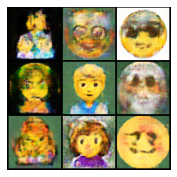

639:43
Epoch #1461 / 2000, Generator Loss: 44.921424865722656, Discriminator Loss: -23.914840698242188
Epoch #1462 / 2000, Generator Loss: 46.1046257019043, Discriminator Loss: -22.309795379638672
Epoch #1463 / 2000, Generator Loss: 45.30763244628906, Discriminator Loss: -22.023427963256836
Epoch #1464 / 2000, Generator Loss: 45.86766052246094, Discriminator Loss: -21.20395278930664
Generated images for Epoch #1464:


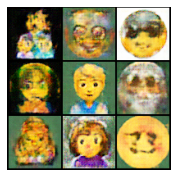

641:01
Epoch #1465 / 2000, Generator Loss: 45.88447189331055, Discriminator Loss: -20.669490814208984
Epoch #1466 / 2000, Generator Loss: 46.46797180175781, Discriminator Loss: -25.41831398010254
Epoch #1467 / 2000, Generator Loss: 44.65214538574219, Discriminator Loss: -22.561264038085938
Epoch #1468 / 2000, Generator Loss: 44.37008285522461, Discriminator Loss: -22.960771560668945
Generated images for Epoch #1468:


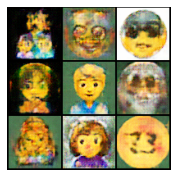

642:19
Epoch #1469 / 2000, Generator Loss: 46.948402404785156, Discriminator Loss: -21.289005279541016
Epoch #1470 / 2000, Generator Loss: 46.18136215209961, Discriminator Loss: -23.882762908935547
Epoch #1471 / 2000, Generator Loss: 43.37726593017578, Discriminator Loss: -25.702810287475586
Epoch #1472 / 2000, Generator Loss: 45.19545364379883, Discriminator Loss: -24.974454879760742
Generated images for Epoch #1472:


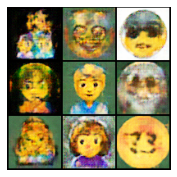

643:37
Epoch #1473 / 2000, Generator Loss: 44.269989013671875, Discriminator Loss: -21.825237274169922
Epoch #1474 / 2000, Generator Loss: 44.47748565673828, Discriminator Loss: -20.577180862426758
Epoch #1475 / 2000, Generator Loss: 45.87580871582031, Discriminator Loss: -20.303436279296875
Epoch #1476 / 2000, Generator Loss: 45.29609298706055, Discriminator Loss: -22.56555938720703
Generated images for Epoch #1476:


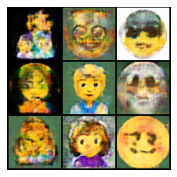

644:54
Epoch #1477 / 2000, Generator Loss: 43.87491226196289, Discriminator Loss: -23.12723159790039
Epoch #1478 / 2000, Generator Loss: 43.74346160888672, Discriminator Loss: -22.86127471923828
Epoch #1479 / 2000, Generator Loss: 45.521949768066406, Discriminator Loss: -20.492267608642578
Epoch #1480 / 2000, Generator Loss: 44.9406852722168, Discriminator Loss: -29.715280532836914
Generated images for Epoch #1480:


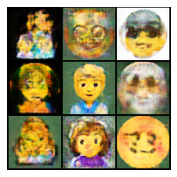

646:12
Epoch #1481 / 2000, Generator Loss: 47.2100715637207, Discriminator Loss: -28.704795837402344
Epoch #1482 / 2000, Generator Loss: 44.942710876464844, Discriminator Loss: -18.282133102416992
Epoch #1483 / 2000, Generator Loss: 45.174781799316406, Discriminator Loss: -22.267044067382812
Epoch #1484 / 2000, Generator Loss: 45.484344482421875, Discriminator Loss: -25.150861740112305
Generated images for Epoch #1484:


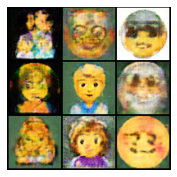

647:30
Epoch #1485 / 2000, Generator Loss: 44.51575469970703, Discriminator Loss: -21.550392150878906
Epoch #1486 / 2000, Generator Loss: 44.250877380371094, Discriminator Loss: -26.74038314819336
Epoch #1487 / 2000, Generator Loss: 46.20354461669922, Discriminator Loss: -25.511783599853516
Epoch #1488 / 2000, Generator Loss: 46.23524856567383, Discriminator Loss: -22.73535919189453
Generated images for Epoch #1488:


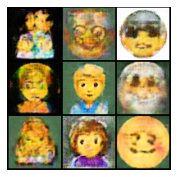

648:48
Epoch #1489 / 2000, Generator Loss: 44.857215881347656, Discriminator Loss: -21.008420944213867
Epoch #1490 / 2000, Generator Loss: 43.934017181396484, Discriminator Loss: -23.505094528198242
Epoch #1491 / 2000, Generator Loss: 45.26054763793945, Discriminator Loss: -28.159900665283203
Epoch #1492 / 2000, Generator Loss: 48.093082427978516, Discriminator Loss: -27.16881561279297
Generated images for Epoch #1492:


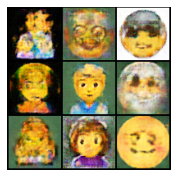

650:06
Epoch #1493 / 2000, Generator Loss: 44.725921630859375, Discriminator Loss: -22.854021072387695
Epoch #1494 / 2000, Generator Loss: 43.81116485595703, Discriminator Loss: -21.92776107788086
Epoch #1495 / 2000, Generator Loss: 46.10285186767578, Discriminator Loss: -22.12948226928711
Epoch #1496 / 2000, Generator Loss: 46.56865310668945, Discriminator Loss: -27.084503173828125
Generated images for Epoch #1496:


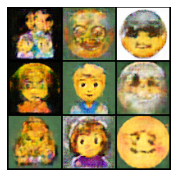

651:25
Epoch #1497 / 2000, Generator Loss: 43.273597717285156, Discriminator Loss: -26.829341888427734
Epoch #1498 / 2000, Generator Loss: 46.067527770996094, Discriminator Loss: -22.04320526123047
Epoch #1499 / 2000, Generator Loss: 46.13570022583008, Discriminator Loss: -23.180015563964844
Epoch #1500 / 2000, Generator Loss: 47.553985595703125, Discriminator Loss: -23.01347541809082
Generated images for Epoch #1500:


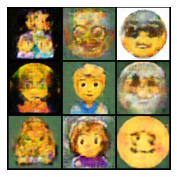

652:43
Epoch #1501 / 2000, Generator Loss: 45.26033401489258, Discriminator Loss: -21.66246223449707
Epoch #1502 / 2000, Generator Loss: 44.937931060791016, Discriminator Loss: -24.871192932128906
Epoch #1503 / 2000, Generator Loss: 46.817283630371094, Discriminator Loss: -21.417449951171875
Epoch #1504 / 2000, Generator Loss: 47.240745544433594, Discriminator Loss: -24.12917137145996
Generated images for Epoch #1504:


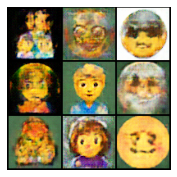

654:01
Epoch #1505 / 2000, Generator Loss: 46.65556335449219, Discriminator Loss: -25.28587532043457
Epoch #1506 / 2000, Generator Loss: 44.27582550048828, Discriminator Loss: -24.992595672607422
Epoch #1507 / 2000, Generator Loss: 45.81688690185547, Discriminator Loss: -22.728473663330078
Epoch #1508 / 2000, Generator Loss: 45.55881118774414, Discriminator Loss: -22.991024017333984
Generated images for Epoch #1508:


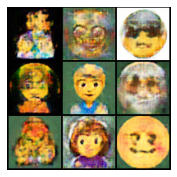

655:19
Epoch #1509 / 2000, Generator Loss: 47.115867614746094, Discriminator Loss: -21.11130714416504
Epoch #1510 / 2000, Generator Loss: 46.488067626953125, Discriminator Loss: -23.622028350830078
Epoch #1511 / 2000, Generator Loss: 47.46787643432617, Discriminator Loss: -23.540302276611328
Epoch #1512 / 2000, Generator Loss: 44.916812896728516, Discriminator Loss: -30.074451446533203
Generated images for Epoch #1512:


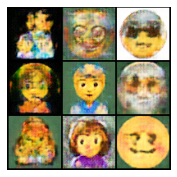

656:37
Epoch #1513 / 2000, Generator Loss: 47.51939392089844, Discriminator Loss: -22.49169158935547
Epoch #1514 / 2000, Generator Loss: 44.260616302490234, Discriminator Loss: -23.89309310913086
Epoch #1515 / 2000, Generator Loss: 46.19718933105469, Discriminator Loss: -22.62353515625
Epoch #1516 / 2000, Generator Loss: 47.0195198059082, Discriminator Loss: -26.918973922729492
Generated images for Epoch #1516:


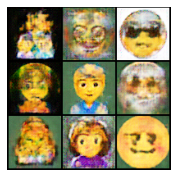

657:56
Epoch #1517 / 2000, Generator Loss: 46.6843147277832, Discriminator Loss: -20.053348541259766
Epoch #1518 / 2000, Generator Loss: 46.07838821411133, Discriminator Loss: -23.468841552734375
Epoch #1519 / 2000, Generator Loss: 47.60981750488281, Discriminator Loss: -21.688610076904297
Epoch #1520 / 2000, Generator Loss: 48.397274017333984, Discriminator Loss: -23.46483612060547
Generated images for Epoch #1520:


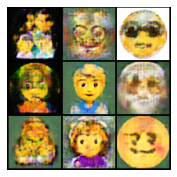

659:14
Epoch #1521 / 2000, Generator Loss: 45.563358306884766, Discriminator Loss: -22.791263580322266
Epoch #1522 / 2000, Generator Loss: 46.21567916870117, Discriminator Loss: -21.90715980529785
Epoch #1523 / 2000, Generator Loss: 48.484039306640625, Discriminator Loss: -27.74630355834961
Epoch #1524 / 2000, Generator Loss: 45.90852355957031, Discriminator Loss: -26.452754974365234
Generated images for Epoch #1524:


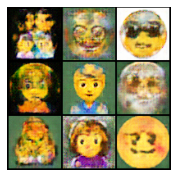

660:32
Epoch #1525 / 2000, Generator Loss: 47.563629150390625, Discriminator Loss: -26.34575653076172
Epoch #1526 / 2000, Generator Loss: 45.60712814331055, Discriminator Loss: -22.71890640258789
Epoch #1527 / 2000, Generator Loss: 46.52762985229492, Discriminator Loss: -20.432281494140625
Epoch #1528 / 2000, Generator Loss: 45.961299896240234, Discriminator Loss: -24.472225189208984
Generated images for Epoch #1528:


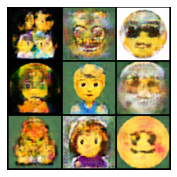

661:50
Epoch #1529 / 2000, Generator Loss: 46.7194709777832, Discriminator Loss: -23.848312377929688
Epoch #1530 / 2000, Generator Loss: 46.205604553222656, Discriminator Loss: -26.517070770263672
Epoch #1531 / 2000, Generator Loss: 46.356964111328125, Discriminator Loss: -27.890775680541992
Epoch #1532 / 2000, Generator Loss: 46.102787017822266, Discriminator Loss: -24.6068058013916
Generated images for Epoch #1532:


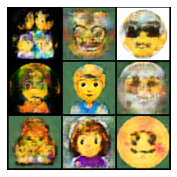

663:08
Epoch #1533 / 2000, Generator Loss: 46.331825256347656, Discriminator Loss: -25.72638702392578
Epoch #1534 / 2000, Generator Loss: 47.23291015625, Discriminator Loss: -26.515918731689453
Epoch #1535 / 2000, Generator Loss: 45.84389114379883, Discriminator Loss: -21.057205200195312
Epoch #1536 / 2000, Generator Loss: 47.949684143066406, Discriminator Loss: -16.859203338623047
Generated images for Epoch #1536:


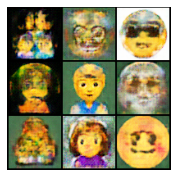

664:25
Epoch #1537 / 2000, Generator Loss: 47.02511215209961, Discriminator Loss: -27.419132232666016
Epoch #1538 / 2000, Generator Loss: 47.87177276611328, Discriminator Loss: -22.7591495513916
Epoch #1539 / 2000, Generator Loss: 48.61662292480469, Discriminator Loss: -23.208251953125
Epoch #1540 / 2000, Generator Loss: 47.16108703613281, Discriminator Loss: -20.898151397705078
Generated images for Epoch #1540:


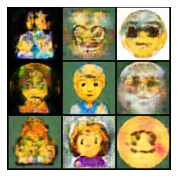

665:43
Epoch #1541 / 2000, Generator Loss: 46.665435791015625, Discriminator Loss: -20.477203369140625
Epoch #1542 / 2000, Generator Loss: 49.16140365600586, Discriminator Loss: -22.841697692871094
Epoch #1543 / 2000, Generator Loss: 48.03412628173828, Discriminator Loss: -25.153491973876953
Epoch #1544 / 2000, Generator Loss: 48.5046501159668, Discriminator Loss: -22.411396026611328
Generated images for Epoch #1544:


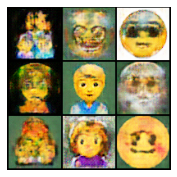

667:01
Epoch #1545 / 2000, Generator Loss: 46.30613708496094, Discriminator Loss: -28.32422637939453
Epoch #1546 / 2000, Generator Loss: 47.661468505859375, Discriminator Loss: -25.51976776123047
Epoch #1547 / 2000, Generator Loss: 45.30998992919922, Discriminator Loss: -19.599857330322266
Epoch #1548 / 2000, Generator Loss: 47.92459487915039, Discriminator Loss: -20.816650390625
Generated images for Epoch #1548:


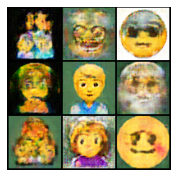

668:19
Epoch #1549 / 2000, Generator Loss: 46.221405029296875, Discriminator Loss: -16.70728874206543
Epoch #1550 / 2000, Generator Loss: 47.309024810791016, Discriminator Loss: -28.609237670898438
Epoch #1551 / 2000, Generator Loss: 47.372825622558594, Discriminator Loss: -25.40082359313965
Epoch #1552 / 2000, Generator Loss: 45.64128875732422, Discriminator Loss: -20.21292495727539
Generated images for Epoch #1552:


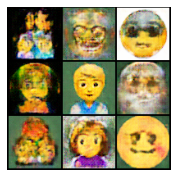

669:37
Epoch #1553 / 2000, Generator Loss: 46.532188415527344, Discriminator Loss: -20.783658981323242
Epoch #1554 / 2000, Generator Loss: 46.770843505859375, Discriminator Loss: -21.24538803100586
Epoch #1555 / 2000, Generator Loss: 46.52672576904297, Discriminator Loss: -23.802391052246094
Epoch #1556 / 2000, Generator Loss: 47.217262268066406, Discriminator Loss: -24.718364715576172
Generated images for Epoch #1556:


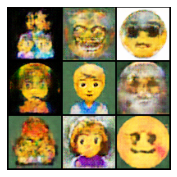

670:55
Epoch #1557 / 2000, Generator Loss: 46.46123123168945, Discriminator Loss: -21.899337768554688
Epoch #1558 / 2000, Generator Loss: 46.775508880615234, Discriminator Loss: -24.10950469970703
Epoch #1559 / 2000, Generator Loss: 46.60111618041992, Discriminator Loss: -21.36298942565918
Epoch #1560 / 2000, Generator Loss: 49.25912094116211, Discriminator Loss: -26.003738403320312
Generated images for Epoch #1560:


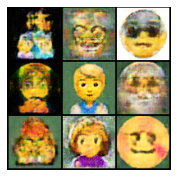

672:13
Epoch #1561 / 2000, Generator Loss: 46.44763946533203, Discriminator Loss: -25.16610336303711
Epoch #1562 / 2000, Generator Loss: 45.262393951416016, Discriminator Loss: -26.200361251831055
Epoch #1563 / 2000, Generator Loss: 47.777488708496094, Discriminator Loss: -25.13927459716797
Epoch #1564 / 2000, Generator Loss: 47.6064453125, Discriminator Loss: -25.534053802490234
Generated images for Epoch #1564:


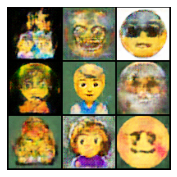

673:31
Epoch #1565 / 2000, Generator Loss: 47.96181869506836, Discriminator Loss: -22.982059478759766
Epoch #1566 / 2000, Generator Loss: 45.71234130859375, Discriminator Loss: -23.879352569580078
Epoch #1567 / 2000, Generator Loss: 45.98008728027344, Discriminator Loss: -27.434673309326172
Epoch #1568 / 2000, Generator Loss: 46.55360412597656, Discriminator Loss: -23.949743270874023
Generated images for Epoch #1568:


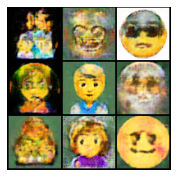

674:49
Epoch #1569 / 2000, Generator Loss: 47.469573974609375, Discriminator Loss: -22.33376693725586
Epoch #1570 / 2000, Generator Loss: 48.51610565185547, Discriminator Loss: -24.36276626586914
Epoch #1571 / 2000, Generator Loss: 47.521484375, Discriminator Loss: -22.966176986694336
Epoch #1572 / 2000, Generator Loss: 48.55143356323242, Discriminator Loss: -22.144317626953125
Generated images for Epoch #1572:


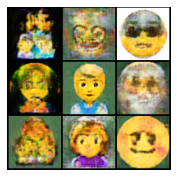

676:08
Epoch #1573 / 2000, Generator Loss: 46.77334213256836, Discriminator Loss: -19.981725692749023
Epoch #1574 / 2000, Generator Loss: 47.72050476074219, Discriminator Loss: -23.360246658325195
Epoch #1575 / 2000, Generator Loss: 48.59445571899414, Discriminator Loss: -26.018857955932617
Epoch #1576 / 2000, Generator Loss: 48.011253356933594, Discriminator Loss: -25.503795623779297
Generated images for Epoch #1576:


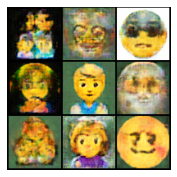

677:25
Epoch #1577 / 2000, Generator Loss: 47.68929672241211, Discriminator Loss: -22.936595916748047
Epoch #1578 / 2000, Generator Loss: 46.44255065917969, Discriminator Loss: -25.080373764038086
Epoch #1579 / 2000, Generator Loss: 46.883243560791016, Discriminator Loss: -23.73069190979004
Epoch #1580 / 2000, Generator Loss: 46.26188278198242, Discriminator Loss: -24.22928810119629
Generated images for Epoch #1580:


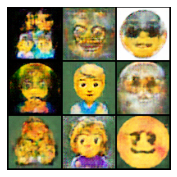

678:43
Epoch #1581 / 2000, Generator Loss: 47.03014373779297, Discriminator Loss: -21.390377044677734
Epoch #1582 / 2000, Generator Loss: 46.534400939941406, Discriminator Loss: -24.138046264648438
Epoch #1583 / 2000, Generator Loss: 46.588165283203125, Discriminator Loss: -26.018739700317383
Epoch #1584 / 2000, Generator Loss: 46.582481384277344, Discriminator Loss: -26.870601654052734
Generated images for Epoch #1584:


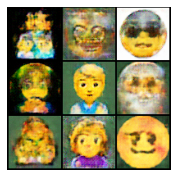

680:01
Epoch #1585 / 2000, Generator Loss: 47.13844299316406, Discriminator Loss: -27.75086212158203
Epoch #1586 / 2000, Generator Loss: 46.448699951171875, Discriminator Loss: -22.93133544921875
Epoch #1587 / 2000, Generator Loss: 45.769126892089844, Discriminator Loss: -24.000600814819336
Epoch #1588 / 2000, Generator Loss: 48.282066345214844, Discriminator Loss: -23.42522430419922
Generated images for Epoch #1588:


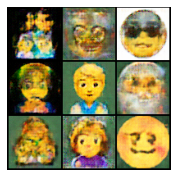

681:19
Epoch #1589 / 2000, Generator Loss: 46.13734817504883, Discriminator Loss: -21.341140747070312
Epoch #1590 / 2000, Generator Loss: 47.040435791015625, Discriminator Loss: -22.137056350708008
Epoch #1591 / 2000, Generator Loss: 49.50978088378906, Discriminator Loss: -18.949993133544922
Epoch #1592 / 2000, Generator Loss: 49.246463775634766, Discriminator Loss: -24.684818267822266
Generated images for Epoch #1592:


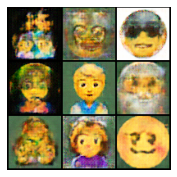

682:37
Epoch #1593 / 2000, Generator Loss: 47.90693664550781, Discriminator Loss: -29.279386520385742
Epoch #1594 / 2000, Generator Loss: 47.43522262573242, Discriminator Loss: -22.740835189819336
Epoch #1595 / 2000, Generator Loss: 50.058685302734375, Discriminator Loss: -22.88397216796875
Epoch #1596 / 2000, Generator Loss: 48.757442474365234, Discriminator Loss: -23.952072143554688
Generated images for Epoch #1596:


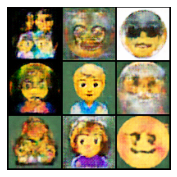

683:55
Epoch #1597 / 2000, Generator Loss: 48.84663391113281, Discriminator Loss: -23.144357681274414
Epoch #1598 / 2000, Generator Loss: 47.291404724121094, Discriminator Loss: -21.395919799804688
Epoch #1599 / 2000, Generator Loss: 49.981876373291016, Discriminator Loss: -22.071678161621094
Epoch #1600 / 2000, Generator Loss: 49.00162124633789, Discriminator Loss: -21.666425704956055
Generated images for Epoch #1600:


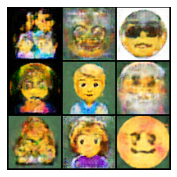

685:12
Epoch #1601 / 2000, Generator Loss: 49.96345138549805, Discriminator Loss: -20.989734649658203
Epoch #1602 / 2000, Generator Loss: 50.210548400878906, Discriminator Loss: -22.244152069091797
Epoch #1603 / 2000, Generator Loss: 51.240394592285156, Discriminator Loss: -20.721725463867188
Epoch #1604 / 2000, Generator Loss: 50.78685760498047, Discriminator Loss: -23.2008056640625
Generated images for Epoch #1604:


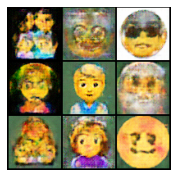

686:30
Epoch #1605 / 2000, Generator Loss: 48.17365646362305, Discriminator Loss: -25.800643920898438
Epoch #1606 / 2000, Generator Loss: 47.95238494873047, Discriminator Loss: -24.12456512451172
Epoch #1607 / 2000, Generator Loss: 49.331932067871094, Discriminator Loss: -19.602487564086914
Epoch #1608 / 2000, Generator Loss: 49.900978088378906, Discriminator Loss: -25.63248634338379
Generated images for Epoch #1608:


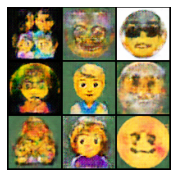

687:48
Epoch #1609 / 2000, Generator Loss: 48.80766296386719, Discriminator Loss: -24.48480224609375
Epoch #1610 / 2000, Generator Loss: 51.79356384277344, Discriminator Loss: -24.61480712890625
Epoch #1611 / 2000, Generator Loss: 49.674522399902344, Discriminator Loss: -26.23560333251953
Epoch #1612 / 2000, Generator Loss: 49.278724670410156, Discriminator Loss: -24.423450469970703
Generated images for Epoch #1612:


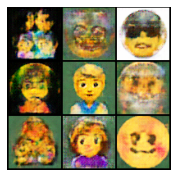

689:06
Epoch #1613 / 2000, Generator Loss: 46.990997314453125, Discriminator Loss: -21.102611541748047
Epoch #1614 / 2000, Generator Loss: 49.72595977783203, Discriminator Loss: -21.625768661499023
Epoch #1615 / 2000, Generator Loss: 50.53671646118164, Discriminator Loss: -25.47394561767578
Epoch #1616 / 2000, Generator Loss: 47.69319152832031, Discriminator Loss: -26.328216552734375
Generated images for Epoch #1616:


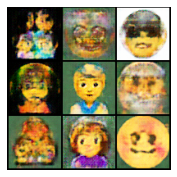

690:23
Epoch #1617 / 2000, Generator Loss: 47.477394104003906, Discriminator Loss: -20.362361907958984
Epoch #1618 / 2000, Generator Loss: 50.17372131347656, Discriminator Loss: -23.546634674072266
Epoch #1619 / 2000, Generator Loss: 49.12451171875, Discriminator Loss: -24.277095794677734
Epoch #1620 / 2000, Generator Loss: 48.225318908691406, Discriminator Loss: -22.275901794433594
Generated images for Epoch #1620:


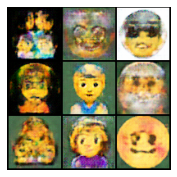

691:41
Epoch #1621 / 2000, Generator Loss: 51.24867248535156, Discriminator Loss: -28.192729949951172
Epoch #1622 / 2000, Generator Loss: 50.082275390625, Discriminator Loss: -24.345975875854492
Epoch #1623 / 2000, Generator Loss: 49.685455322265625, Discriminator Loss: -25.354887008666992
Epoch #1624 / 2000, Generator Loss: 48.49494171142578, Discriminator Loss: -23.730262756347656
Generated images for Epoch #1624:


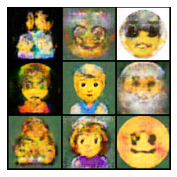

693:00
Epoch #1625 / 2000, Generator Loss: 49.4652099609375, Discriminator Loss: -27.113975524902344
Epoch #1626 / 2000, Generator Loss: 49.880680084228516, Discriminator Loss: -18.41065216064453
Epoch #1627 / 2000, Generator Loss: 49.27444839477539, Discriminator Loss: -21.51704216003418
Epoch #1628 / 2000, Generator Loss: 47.62892150878906, Discriminator Loss: -22.11487579345703
Generated images for Epoch #1628:


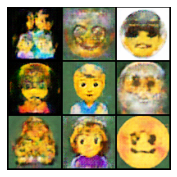

694:18
Epoch #1629 / 2000, Generator Loss: 48.643280029296875, Discriminator Loss: -22.809389114379883
Epoch #1630 / 2000, Generator Loss: 49.57408905029297, Discriminator Loss: -21.900625228881836
Epoch #1631 / 2000, Generator Loss: 49.09886932373047, Discriminator Loss: -24.982725143432617
Epoch #1632 / 2000, Generator Loss: 50.86725616455078, Discriminator Loss: -23.405824661254883
Generated images for Epoch #1632:


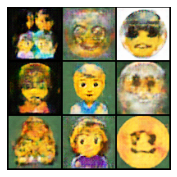

695:36
Epoch #1633 / 2000, Generator Loss: 47.60655975341797, Discriminator Loss: -23.554405212402344
Epoch #1634 / 2000, Generator Loss: 49.654937744140625, Discriminator Loss: -25.12368392944336
Epoch #1635 / 2000, Generator Loss: 49.22081756591797, Discriminator Loss: -20.093379974365234
Epoch #1636 / 2000, Generator Loss: 48.85711669921875, Discriminator Loss: -21.170635223388672
Generated images for Epoch #1636:


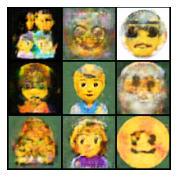

696:54
Epoch #1637 / 2000, Generator Loss: 47.55087661743164, Discriminator Loss: -21.72677230834961
Epoch #1638 / 2000, Generator Loss: 49.11994171142578, Discriminator Loss: -22.539592742919922
Epoch #1639 / 2000, Generator Loss: 51.36750793457031, Discriminator Loss: -21.393611907958984
Epoch #1640 / 2000, Generator Loss: 50.133522033691406, Discriminator Loss: -18.209535598754883
Generated images for Epoch #1640:


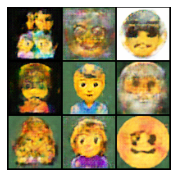

698:12
Epoch #1641 / 2000, Generator Loss: 48.92958450317383, Discriminator Loss: -25.299264907836914
Epoch #1642 / 2000, Generator Loss: 49.44131088256836, Discriminator Loss: -26.858016967773438
Epoch #1643 / 2000, Generator Loss: 49.70451736450195, Discriminator Loss: -20.69981575012207
Epoch #1644 / 2000, Generator Loss: 50.08756637573242, Discriminator Loss: -24.391223907470703
Generated images for Epoch #1644:


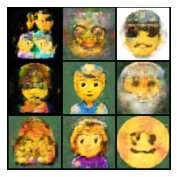

699:30
Epoch #1645 / 2000, Generator Loss: 51.690155029296875, Discriminator Loss: -28.39072036743164
Epoch #1646 / 2000, Generator Loss: 49.236061096191406, Discriminator Loss: -23.28899574279785
Epoch #1647 / 2000, Generator Loss: 47.81524658203125, Discriminator Loss: -25.816255569458008
Epoch #1648 / 2000, Generator Loss: 50.29962921142578, Discriminator Loss: -25.416162490844727
Generated images for Epoch #1648:


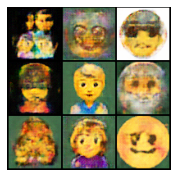

700:48
Epoch #1649 / 2000, Generator Loss: 50.38093185424805, Discriminator Loss: -19.142234802246094
Epoch #1650 / 2000, Generator Loss: 50.218162536621094, Discriminator Loss: -24.922019958496094
Epoch #1651 / 2000, Generator Loss: 48.714988708496094, Discriminator Loss: -24.626285552978516
Epoch #1652 / 2000, Generator Loss: 48.772682189941406, Discriminator Loss: -19.19955825805664
Generated images for Epoch #1652:


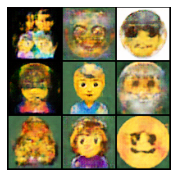

702:05
Epoch #1653 / 2000, Generator Loss: 50.846778869628906, Discriminator Loss: -23.136661529541016
Epoch #1654 / 2000, Generator Loss: 50.719032287597656, Discriminator Loss: -23.112106323242188
Epoch #1655 / 2000, Generator Loss: 50.12415313720703, Discriminator Loss: -23.273107528686523
Epoch #1656 / 2000, Generator Loss: 47.4281120300293, Discriminator Loss: -21.286022186279297
Generated images for Epoch #1656:


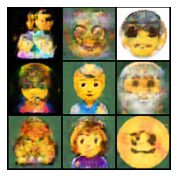

703:23
Epoch #1657 / 2000, Generator Loss: 49.38789367675781, Discriminator Loss: -23.400007247924805
Epoch #1658 / 2000, Generator Loss: 48.75980758666992, Discriminator Loss: -24.327869415283203
Epoch #1659 / 2000, Generator Loss: 50.307586669921875, Discriminator Loss: -23.970386505126953
Epoch #1660 / 2000, Generator Loss: 48.61298370361328, Discriminator Loss: -25.249683380126953
Generated images for Epoch #1660:


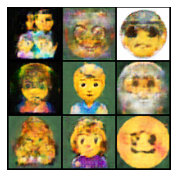

704:41
Epoch #1661 / 2000, Generator Loss: 50.30243682861328, Discriminator Loss: -27.791793823242188
Epoch #1662 / 2000, Generator Loss: 50.11518478393555, Discriminator Loss: -23.090261459350586
Epoch #1663 / 2000, Generator Loss: 49.089752197265625, Discriminator Loss: -27.00659942626953
Epoch #1664 / 2000, Generator Loss: 50.36288070678711, Discriminator Loss: -25.29690933227539
Generated images for Epoch #1664:


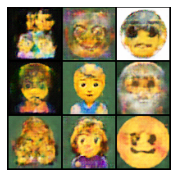

705:58
Epoch #1665 / 2000, Generator Loss: 49.55188751220703, Discriminator Loss: -23.171485900878906
Epoch #1666 / 2000, Generator Loss: 48.335575103759766, Discriminator Loss: -27.234272003173828
Epoch #1667 / 2000, Generator Loss: 49.719146728515625, Discriminator Loss: -18.888866424560547
Epoch #1668 / 2000, Generator Loss: 50.12681198120117, Discriminator Loss: -24.640914916992188
Generated images for Epoch #1668:


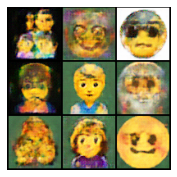

707:16
Epoch #1669 / 2000, Generator Loss: 48.43916702270508, Discriminator Loss: -24.618499755859375
Epoch #1670 / 2000, Generator Loss: 50.211585998535156, Discriminator Loss: -23.13534164428711
Epoch #1671 / 2000, Generator Loss: 49.90593719482422, Discriminator Loss: -21.595840454101562
Epoch #1672 / 2000, Generator Loss: 50.05028533935547, Discriminator Loss: -25.323062896728516
Generated images for Epoch #1672:


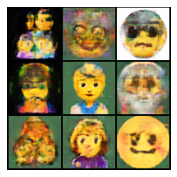

708:34
Epoch #1673 / 2000, Generator Loss: 51.65660858154297, Discriminator Loss: -23.45904541015625
Epoch #1674 / 2000, Generator Loss: 48.63416290283203, Discriminator Loss: -22.40218734741211
Epoch #1675 / 2000, Generator Loss: 51.89155578613281, Discriminator Loss: -18.881521224975586
Epoch #1676 / 2000, Generator Loss: 49.34175109863281, Discriminator Loss: -23.487295150756836
Generated images for Epoch #1676:


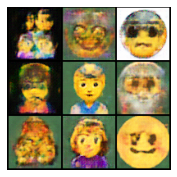

709:51
Epoch #1677 / 2000, Generator Loss: 47.63261795043945, Discriminator Loss: -23.578006744384766
Epoch #1678 / 2000, Generator Loss: 51.11400604248047, Discriminator Loss: -23.467872619628906
Epoch #1679 / 2000, Generator Loss: 50.881256103515625, Discriminator Loss: -27.224735260009766
Epoch #1680 / 2000, Generator Loss: 50.792076110839844, Discriminator Loss: -23.993331909179688
Generated images for Epoch #1680:


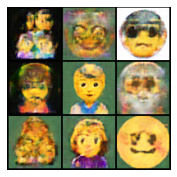

711:09
Epoch #1681 / 2000, Generator Loss: 50.55525588989258, Discriminator Loss: -23.849040985107422
Epoch #1682 / 2000, Generator Loss: 50.539005279541016, Discriminator Loss: -22.591415405273438
Epoch #1683 / 2000, Generator Loss: 51.953956604003906, Discriminator Loss: -24.556617736816406
Epoch #1684 / 2000, Generator Loss: 47.43082809448242, Discriminator Loss: -22.20026969909668
Generated images for Epoch #1684:


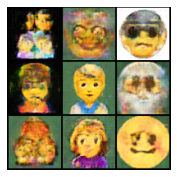

712:27
Epoch #1685 / 2000, Generator Loss: 50.430049896240234, Discriminator Loss: -21.0560245513916
Epoch #1686 / 2000, Generator Loss: 48.255859375, Discriminator Loss: -27.124099731445312
Epoch #1687 / 2000, Generator Loss: 49.62628173828125, Discriminator Loss: -21.035785675048828
Epoch #1688 / 2000, Generator Loss: 48.03668975830078, Discriminator Loss: -22.87459373474121
Generated images for Epoch #1688:


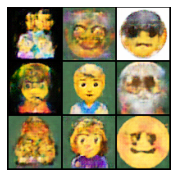

713:45
Epoch #1689 / 2000, Generator Loss: 50.66082000732422, Discriminator Loss: -29.523069381713867
Epoch #1690 / 2000, Generator Loss: 49.985931396484375, Discriminator Loss: -18.553462982177734
Epoch #1691 / 2000, Generator Loss: 50.089229583740234, Discriminator Loss: -21.985553741455078
Epoch #1692 / 2000, Generator Loss: 49.84712600708008, Discriminator Loss: -22.1313533782959
Generated images for Epoch #1692:


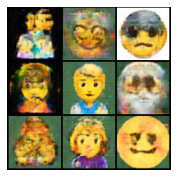

715:04
Epoch #1693 / 2000, Generator Loss: 49.22936248779297, Discriminator Loss: -26.55828857421875
Epoch #1694 / 2000, Generator Loss: 51.365234375, Discriminator Loss: -27.872617721557617
Epoch #1695 / 2000, Generator Loss: 49.1702880859375, Discriminator Loss: -21.844886779785156
Epoch #1696 / 2000, Generator Loss: 48.93558883666992, Discriminator Loss: -22.836910247802734
Generated images for Epoch #1696:


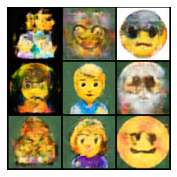

716:21
Epoch #1697 / 2000, Generator Loss: 51.841835021972656, Discriminator Loss: -25.825214385986328
Epoch #1698 / 2000, Generator Loss: 50.5279541015625, Discriminator Loss: -24.660945892333984
Epoch #1699 / 2000, Generator Loss: 49.99243927001953, Discriminator Loss: -22.556880950927734
Epoch #1700 / 2000, Generator Loss: 50.941566467285156, Discriminator Loss: -23.01293182373047
Generated images for Epoch #1700:


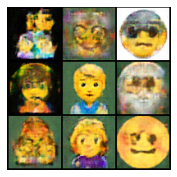

717:39
Epoch #1701 / 2000, Generator Loss: 52.05268096923828, Discriminator Loss: -27.57997703552246
Epoch #1702 / 2000, Generator Loss: 50.67266845703125, Discriminator Loss: -25.859037399291992
Epoch #1703 / 2000, Generator Loss: 50.387481689453125, Discriminator Loss: -23.04355239868164
Epoch #1704 / 2000, Generator Loss: 50.121646881103516, Discriminator Loss: -24.87542152404785
Generated images for Epoch #1704:


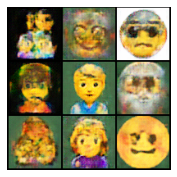

718:56
Epoch #1705 / 2000, Generator Loss: 49.14144515991211, Discriminator Loss: -21.103633880615234
Epoch #1706 / 2000, Generator Loss: 50.147064208984375, Discriminator Loss: -19.06171417236328
Epoch #1707 / 2000, Generator Loss: 50.78700256347656, Discriminator Loss: -23.1849422454834
Epoch #1708 / 2000, Generator Loss: 50.57538604736328, Discriminator Loss: -24.09343910217285
Generated images for Epoch #1708:


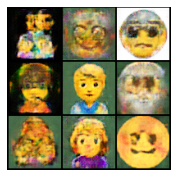

720:14
Epoch #1709 / 2000, Generator Loss: 50.634063720703125, Discriminator Loss: -25.55402183532715
Epoch #1710 / 2000, Generator Loss: 50.01679992675781, Discriminator Loss: -21.292709350585938
Epoch #1711 / 2000, Generator Loss: 52.084983825683594, Discriminator Loss: -19.669878005981445
Epoch #1712 / 2000, Generator Loss: 49.535858154296875, Discriminator Loss: -20.881101608276367
Generated images for Epoch #1712:


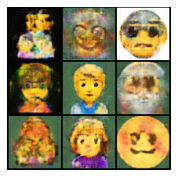

721:32
Epoch #1713 / 2000, Generator Loss: 50.834083557128906, Discriminator Loss: -22.329750061035156
Epoch #1714 / 2000, Generator Loss: 50.11858367919922, Discriminator Loss: -23.339616775512695
Epoch #1715 / 2000, Generator Loss: 52.96892547607422, Discriminator Loss: -22.074260711669922
Epoch #1716 / 2000, Generator Loss: 49.69972229003906, Discriminator Loss: -21.355838775634766
Generated images for Epoch #1716:


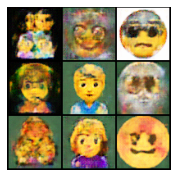

722:49
Epoch #1717 / 2000, Generator Loss: 49.849945068359375, Discriminator Loss: -25.639522552490234
Epoch #1718 / 2000, Generator Loss: 51.13031005859375, Discriminator Loss: -24.603984832763672
Epoch #1719 / 2000, Generator Loss: 50.69507598876953, Discriminator Loss: -25.211101531982422
Epoch #1720 / 2000, Generator Loss: 50.32294845581055, Discriminator Loss: -24.706195831298828
Generated images for Epoch #1720:


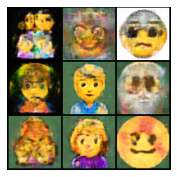

724:07
Epoch #1721 / 2000, Generator Loss: 48.07527542114258, Discriminator Loss: -27.46341896057129
Epoch #1722 / 2000, Generator Loss: 48.71096420288086, Discriminator Loss: -22.788249969482422
Epoch #1723 / 2000, Generator Loss: 50.67769241333008, Discriminator Loss: -23.355234146118164
Epoch #1724 / 2000, Generator Loss: 51.83253860473633, Discriminator Loss: -23.001468658447266
Generated images for Epoch #1724:


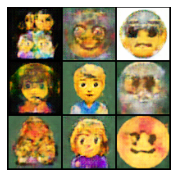

725:25
Epoch #1725 / 2000, Generator Loss: 51.90277099609375, Discriminator Loss: -27.838815689086914
Epoch #1726 / 2000, Generator Loss: 50.71202087402344, Discriminator Loss: -18.8736572265625
Epoch #1727 / 2000, Generator Loss: 51.09669494628906, Discriminator Loss: -21.90833282470703
Epoch #1728 / 2000, Generator Loss: 52.995277404785156, Discriminator Loss: -25.551244735717773
Generated images for Epoch #1728:


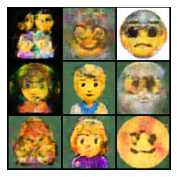

726:42
Epoch #1729 / 2000, Generator Loss: 49.634178161621094, Discriminator Loss: -24.92363739013672
Epoch #1730 / 2000, Generator Loss: 50.90571594238281, Discriminator Loss: -21.663454055786133
Epoch #1731 / 2000, Generator Loss: 49.14664077758789, Discriminator Loss: -25.856197357177734
Epoch #1732 / 2000, Generator Loss: 50.26845169067383, Discriminator Loss: -22.235136032104492
Generated images for Epoch #1732:


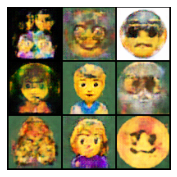

728:00
Epoch #1733 / 2000, Generator Loss: 50.026641845703125, Discriminator Loss: -20.323108673095703
Epoch #1734 / 2000, Generator Loss: 51.34137725830078, Discriminator Loss: -22.301471710205078
Epoch #1735 / 2000, Generator Loss: 48.81636428833008, Discriminator Loss: -23.159927368164062
Epoch #1736 / 2000, Generator Loss: 50.259117126464844, Discriminator Loss: -25.63382911682129
Generated images for Epoch #1736:


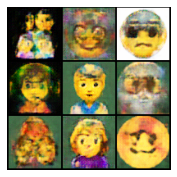

729:18
Epoch #1737 / 2000, Generator Loss: 51.07355499267578, Discriminator Loss: -24.627079010009766
Epoch #1738 / 2000, Generator Loss: 51.452362060546875, Discriminator Loss: -27.721904754638672
Epoch #1739 / 2000, Generator Loss: 50.79271697998047, Discriminator Loss: -26.567867279052734
Epoch #1740 / 2000, Generator Loss: 51.732505798339844, Discriminator Loss: -26.580490112304688
Generated images for Epoch #1740:


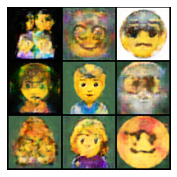

730:35
Epoch #1741 / 2000, Generator Loss: 50.54819869995117, Discriminator Loss: -18.73931312561035
Epoch #1742 / 2000, Generator Loss: 50.470436096191406, Discriminator Loss: -24.357402801513672
Epoch #1743 / 2000, Generator Loss: 49.57033920288086, Discriminator Loss: -18.888771057128906
Epoch #1744 / 2000, Generator Loss: 50.880523681640625, Discriminator Loss: -21.886844635009766
Generated images for Epoch #1744:


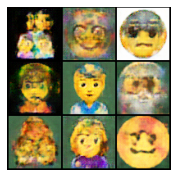

731:53
Epoch #1745 / 2000, Generator Loss: 51.21727752685547, Discriminator Loss: -22.34600067138672
Epoch #1746 / 2000, Generator Loss: 52.66663360595703, Discriminator Loss: -27.190622329711914
Epoch #1747 / 2000, Generator Loss: 51.479713439941406, Discriminator Loss: -20.934349060058594
Epoch #1748 / 2000, Generator Loss: 52.02931213378906, Discriminator Loss: -25.420957565307617
Generated images for Epoch #1748:


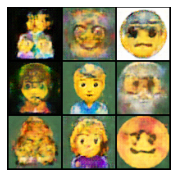

733:12
Epoch #1749 / 2000, Generator Loss: 50.394187927246094, Discriminator Loss: -21.378799438476562
Epoch #1750 / 2000, Generator Loss: 49.726993560791016, Discriminator Loss: -26.08803939819336
Epoch #1751 / 2000, Generator Loss: 52.11625289916992, Discriminator Loss: -18.666545867919922
Epoch #1752 / 2000, Generator Loss: 52.468017578125, Discriminator Loss: -25.99881362915039
Generated images for Epoch #1752:


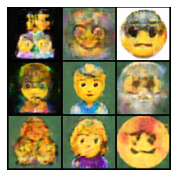

734:30
Epoch #1753 / 2000, Generator Loss: 50.9219970703125, Discriminator Loss: -20.679828643798828
Epoch #1754 / 2000, Generator Loss: 50.26203155517578, Discriminator Loss: -22.58296775817871
Epoch #1755 / 2000, Generator Loss: 52.243255615234375, Discriminator Loss: -25.63916015625
Epoch #1756 / 2000, Generator Loss: 51.040626525878906, Discriminator Loss: -20.307533264160156
Generated images for Epoch #1756:


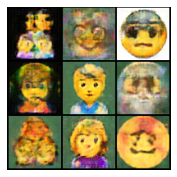

735:47
Epoch #1757 / 2000, Generator Loss: 51.5321044921875, Discriminator Loss: -21.321535110473633
Epoch #1758 / 2000, Generator Loss: 51.3272705078125, Discriminator Loss: -23.667997360229492
Epoch #1759 / 2000, Generator Loss: 49.903602600097656, Discriminator Loss: -28.93256378173828
Epoch #1760 / 2000, Generator Loss: 53.30384826660156, Discriminator Loss: -22.535457611083984
Generated images for Epoch #1760:


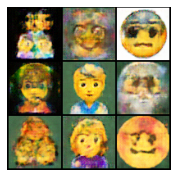

737:05
Epoch #1761 / 2000, Generator Loss: 50.584720611572266, Discriminator Loss: -22.575159072875977
Epoch #1762 / 2000, Generator Loss: 51.178184509277344, Discriminator Loss: -17.935016632080078
Epoch #1763 / 2000, Generator Loss: 52.496360778808594, Discriminator Loss: -23.665803909301758
Epoch #1764 / 2000, Generator Loss: 50.53832244873047, Discriminator Loss: -23.572715759277344
Generated images for Epoch #1764:


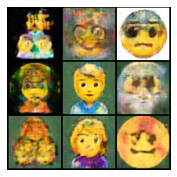

738:23
Epoch #1765 / 2000, Generator Loss: 50.801185607910156, Discriminator Loss: -26.183650970458984
Epoch #1766 / 2000, Generator Loss: 50.997215270996094, Discriminator Loss: -20.032461166381836
Epoch #1767 / 2000, Generator Loss: 50.375938415527344, Discriminator Loss: -21.403026580810547
Epoch #1768 / 2000, Generator Loss: 50.36761474609375, Discriminator Loss: -24.861085891723633
Generated images for Epoch #1768:


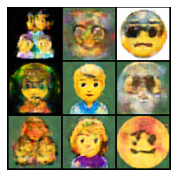

739:41
Epoch #1769 / 2000, Generator Loss: 50.236175537109375, Discriminator Loss: -24.90169334411621
Epoch #1770 / 2000, Generator Loss: 50.55909729003906, Discriminator Loss: -26.027851104736328
Epoch #1771 / 2000, Generator Loss: 50.804237365722656, Discriminator Loss: -24.057781219482422
Epoch #1772 / 2000, Generator Loss: 50.71009063720703, Discriminator Loss: -26.364063262939453
Generated images for Epoch #1772:


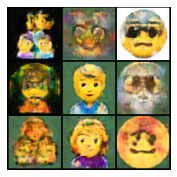

740:58
Epoch #1773 / 2000, Generator Loss: 50.49182891845703, Discriminator Loss: -20.798547744750977
Epoch #1774 / 2000, Generator Loss: 53.24085998535156, Discriminator Loss: -26.075143814086914
Epoch #1775 / 2000, Generator Loss: 51.21923828125, Discriminator Loss: -21.77318572998047
Epoch #1776 / 2000, Generator Loss: 49.41156005859375, Discriminator Loss: -21.452964782714844
Generated images for Epoch #1776:


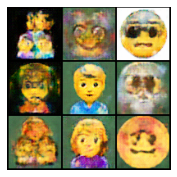

742:16
Epoch #1777 / 2000, Generator Loss: 52.57450866699219, Discriminator Loss: -18.948631286621094
Epoch #1778 / 2000, Generator Loss: 52.22444534301758, Discriminator Loss: -20.707599639892578
Epoch #1779 / 2000, Generator Loss: 51.893470764160156, Discriminator Loss: -28.85782241821289
Epoch #1780 / 2000, Generator Loss: 50.28559112548828, Discriminator Loss: -25.383563995361328
Generated images for Epoch #1780:


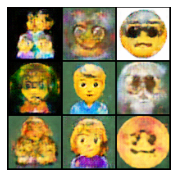

743:33
Epoch #1781 / 2000, Generator Loss: 52.534820556640625, Discriminator Loss: -26.705781936645508
Epoch #1782 / 2000, Generator Loss: 50.357521057128906, Discriminator Loss: -25.4216251373291
Epoch #1783 / 2000, Generator Loss: 49.47925567626953, Discriminator Loss: -21.786779403686523
Epoch #1784 / 2000, Generator Loss: 51.957374572753906, Discriminator Loss: -23.684431076049805
Generated images for Epoch #1784:


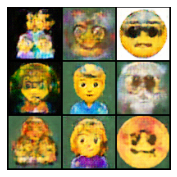

744:51
Epoch #1785 / 2000, Generator Loss: 50.72301483154297, Discriminator Loss: -24.534194946289062
Epoch #1786 / 2000, Generator Loss: 50.85728073120117, Discriminator Loss: -23.376373291015625
Epoch #1787 / 2000, Generator Loss: 51.86178207397461, Discriminator Loss: -23.897676467895508
Epoch #1788 / 2000, Generator Loss: 51.992820739746094, Discriminator Loss: -19.29482650756836
Generated images for Epoch #1788:


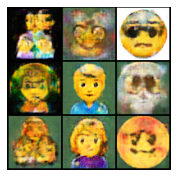

746:09
Epoch #1789 / 2000, Generator Loss: 50.89407730102539, Discriminator Loss: -23.464597702026367
Epoch #1790 / 2000, Generator Loss: 53.5867805480957, Discriminator Loss: -21.398319244384766
Epoch #1791 / 2000, Generator Loss: 51.67096710205078, Discriminator Loss: -22.99036407470703
Epoch #1792 / 2000, Generator Loss: 52.580265045166016, Discriminator Loss: -21.832584381103516
Generated images for Epoch #1792:


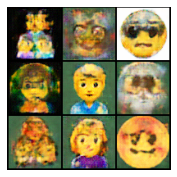

747:26
Epoch #1793 / 2000, Generator Loss: 51.25801467895508, Discriminator Loss: -24.78607940673828
Epoch #1794 / 2000, Generator Loss: 50.93996810913086, Discriminator Loss: -23.106853485107422
Epoch #1795 / 2000, Generator Loss: 51.895511627197266, Discriminator Loss: -24.92561149597168
Epoch #1796 / 2000, Generator Loss: 50.9981689453125, Discriminator Loss: -20.792396545410156
Generated images for Epoch #1796:


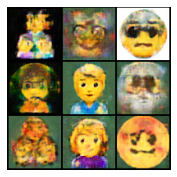

748:44
Epoch #1797 / 2000, Generator Loss: 48.89911651611328, Discriminator Loss: -22.69129180908203
Epoch #1798 / 2000, Generator Loss: 53.2541618347168, Discriminator Loss: -20.094642639160156
Epoch #1799 / 2000, Generator Loss: 51.641212463378906, Discriminator Loss: -27.509443283081055
Epoch #1800 / 2000, Generator Loss: 50.663230895996094, Discriminator Loss: -22.171838760375977
Generated images for Epoch #1800:


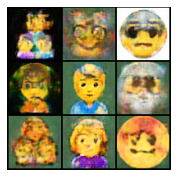

750:01
Epoch #1801 / 2000, Generator Loss: 50.93418502807617, Discriminator Loss: -27.362911224365234
Epoch #1802 / 2000, Generator Loss: 52.32197952270508, Discriminator Loss: -25.816633224487305
Epoch #1803 / 2000, Generator Loss: 50.932411193847656, Discriminator Loss: -23.160446166992188
Epoch #1804 / 2000, Generator Loss: 51.42230224609375, Discriminator Loss: -23.113067626953125
Generated images for Epoch #1804:


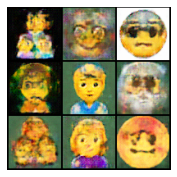

751:19
Epoch #1805 / 2000, Generator Loss: 50.73949432373047, Discriminator Loss: -28.059097290039062
Epoch #1806 / 2000, Generator Loss: 52.444053649902344, Discriminator Loss: -22.69027328491211
Epoch #1807 / 2000, Generator Loss: 49.987205505371094, Discriminator Loss: -22.355676651000977
Epoch #1808 / 2000, Generator Loss: 51.25941467285156, Discriminator Loss: -22.804628372192383
Generated images for Epoch #1808:


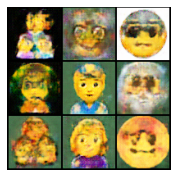

752:37
Epoch #1809 / 2000, Generator Loss: 51.93518829345703, Discriminator Loss: -17.51513671875
Epoch #1810 / 2000, Generator Loss: 51.253631591796875, Discriminator Loss: -23.945932388305664
Epoch #1811 / 2000, Generator Loss: 50.06676483154297, Discriminator Loss: -24.04925537109375
Epoch #1812 / 2000, Generator Loss: 51.86406326293945, Discriminator Loss: -22.38117218017578
Generated images for Epoch #1812:


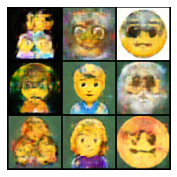

753:55
Epoch #1813 / 2000, Generator Loss: 51.77433776855469, Discriminator Loss: -19.262516021728516
Epoch #1814 / 2000, Generator Loss: 50.19841003417969, Discriminator Loss: -21.750171661376953
Epoch #1815 / 2000, Generator Loss: 49.1573371887207, Discriminator Loss: -20.19723892211914
Epoch #1816 / 2000, Generator Loss: 52.016292572021484, Discriminator Loss: -20.611072540283203
Generated images for Epoch #1816:


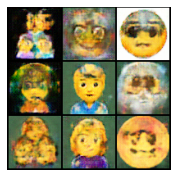

755:13
Epoch #1817 / 2000, Generator Loss: 53.051422119140625, Discriminator Loss: -22.832218170166016
Epoch #1818 / 2000, Generator Loss: 51.12836456298828, Discriminator Loss: -24.978160858154297
Epoch #1819 / 2000, Generator Loss: 52.64044952392578, Discriminator Loss: -24.241497039794922
Epoch #1820 / 2000, Generator Loss: 52.455421447753906, Discriminator Loss: -21.485912322998047
Generated images for Epoch #1820:


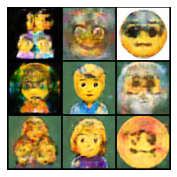

756:31
Epoch #1821 / 2000, Generator Loss: 50.21533966064453, Discriminator Loss: -21.90587615966797
Epoch #1822 / 2000, Generator Loss: 51.87507629394531, Discriminator Loss: -20.841060638427734
Epoch #1823 / 2000, Generator Loss: 51.7326545715332, Discriminator Loss: -24.050376892089844
Epoch #1824 / 2000, Generator Loss: 51.472076416015625, Discriminator Loss: -25.340396881103516
Generated images for Epoch #1824:


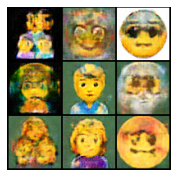

757:49
Epoch #1825 / 2000, Generator Loss: 51.049591064453125, Discriminator Loss: -23.174266815185547
Epoch #1826 / 2000, Generator Loss: 51.260379791259766, Discriminator Loss: -21.072608947753906
Epoch #1827 / 2000, Generator Loss: 52.00859069824219, Discriminator Loss: -21.51734733581543
Epoch #1828 / 2000, Generator Loss: 51.61338806152344, Discriminator Loss: -25.38927459716797
Generated images for Epoch #1828:


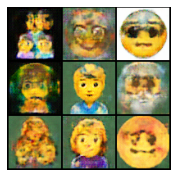

759:07
Epoch #1829 / 2000, Generator Loss: 50.15751647949219, Discriminator Loss: -28.59872055053711
Epoch #1830 / 2000, Generator Loss: 50.50128936767578, Discriminator Loss: -18.008228302001953
Epoch #1831 / 2000, Generator Loss: 51.596954345703125, Discriminator Loss: -23.930681228637695
Epoch #1832 / 2000, Generator Loss: 50.65486145019531, Discriminator Loss: -26.768268585205078
Generated images for Epoch #1832:


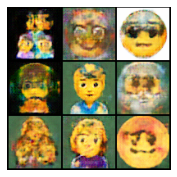

760:25
Epoch #1833 / 2000, Generator Loss: 51.45714569091797, Discriminator Loss: -20.9189453125
Epoch #1834 / 2000, Generator Loss: 50.07258605957031, Discriminator Loss: -20.102041244506836
Epoch #1835 / 2000, Generator Loss: 50.53118133544922, Discriminator Loss: -21.495853424072266
Epoch #1836 / 2000, Generator Loss: 51.63388442993164, Discriminator Loss: -19.855976104736328
Generated images for Epoch #1836:


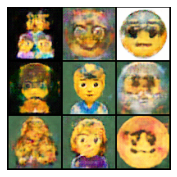

761:43
Epoch #1837 / 2000, Generator Loss: 53.03294372558594, Discriminator Loss: -23.294647216796875
Epoch #1838 / 2000, Generator Loss: 52.01445770263672, Discriminator Loss: -29.240259170532227
Epoch #1839 / 2000, Generator Loss: 50.51922607421875, Discriminator Loss: -26.19445037841797
Epoch #1840 / 2000, Generator Loss: 50.99229431152344, Discriminator Loss: -22.0633487701416
Generated images for Epoch #1840:


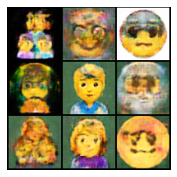

763:00
Epoch #1841 / 2000, Generator Loss: 51.96992492675781, Discriminator Loss: -17.415124893188477
Epoch #1842 / 2000, Generator Loss: 52.271751403808594, Discriminator Loss: -25.237802505493164
Epoch #1843 / 2000, Generator Loss: 50.998809814453125, Discriminator Loss: -20.898954391479492
Epoch #1844 / 2000, Generator Loss: 50.60917663574219, Discriminator Loss: -23.798309326171875
Generated images for Epoch #1844:


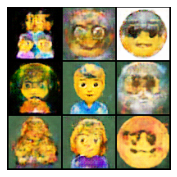

764:18
Epoch #1845 / 2000, Generator Loss: 51.876983642578125, Discriminator Loss: -21.177364349365234
Epoch #1846 / 2000, Generator Loss: 50.35580825805664, Discriminator Loss: -16.627227783203125
Epoch #1847 / 2000, Generator Loss: 50.240386962890625, Discriminator Loss: -19.611242294311523
Epoch #1848 / 2000, Generator Loss: 49.4715461730957, Discriminator Loss: -19.853225708007812
Generated images for Epoch #1848:


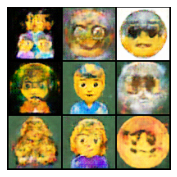

765:36
Epoch #1849 / 2000, Generator Loss: 50.82341766357422, Discriminator Loss: -22.37115478515625
Epoch #1850 / 2000, Generator Loss: 51.28861999511719, Discriminator Loss: -19.17620849609375
Epoch #1851 / 2000, Generator Loss: 50.423301696777344, Discriminator Loss: -27.975540161132812
Epoch #1852 / 2000, Generator Loss: 52.18562698364258, Discriminator Loss: -23.09294891357422
Generated images for Epoch #1852:


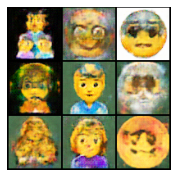

766:53
Epoch #1853 / 2000, Generator Loss: 52.39598083496094, Discriminator Loss: -24.39474105834961
Epoch #1854 / 2000, Generator Loss: 50.78352737426758, Discriminator Loss: -27.323991775512695
Epoch #1855 / 2000, Generator Loss: 49.81236267089844, Discriminator Loss: -26.328636169433594
Epoch #1856 / 2000, Generator Loss: 52.185752868652344, Discriminator Loss: -25.003286361694336
Generated images for Epoch #1856:


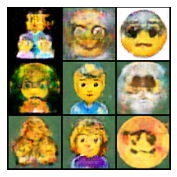

768:11
Epoch #1857 / 2000, Generator Loss: 50.488704681396484, Discriminator Loss: -23.377729415893555
Epoch #1858 / 2000, Generator Loss: 50.3218994140625, Discriminator Loss: -25.80818748474121
Epoch #1859 / 2000, Generator Loss: 50.9661865234375, Discriminator Loss: -27.107284545898438
Epoch #1860 / 2000, Generator Loss: 53.562225341796875, Discriminator Loss: -26.678096771240234
Generated images for Epoch #1860:


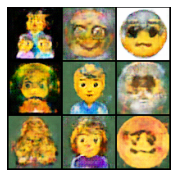

769:29
Epoch #1861 / 2000, Generator Loss: 53.688446044921875, Discriminator Loss: -26.498746871948242
Epoch #1862 / 2000, Generator Loss: 50.3238639831543, Discriminator Loss: -25.194015502929688
Epoch #1863 / 2000, Generator Loss: 52.33127212524414, Discriminator Loss: -27.12343978881836
Epoch #1864 / 2000, Generator Loss: 52.55766296386719, Discriminator Loss: -26.358482360839844
Generated images for Epoch #1864:


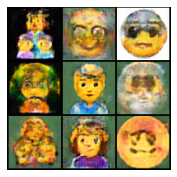

770:46
Epoch #1865 / 2000, Generator Loss: 51.236175537109375, Discriminator Loss: -22.564193725585938
Epoch #1866 / 2000, Generator Loss: 51.1417350769043, Discriminator Loss: -21.194541931152344
Epoch #1867 / 2000, Generator Loss: 51.49591827392578, Discriminator Loss: -25.128376007080078
Epoch #1868 / 2000, Generator Loss: 51.8686408996582, Discriminator Loss: -24.191162109375
Generated images for Epoch #1868:


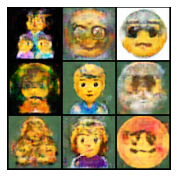

772:04
Epoch #1869 / 2000, Generator Loss: 51.03730773925781, Discriminator Loss: -20.544025421142578
Epoch #1870 / 2000, Generator Loss: 52.987735748291016, Discriminator Loss: -25.17595863342285
Epoch #1871 / 2000, Generator Loss: 49.93048858642578, Discriminator Loss: -26.124927520751953
Epoch #1872 / 2000, Generator Loss: 51.178001403808594, Discriminator Loss: -23.134174346923828
Generated images for Epoch #1872:


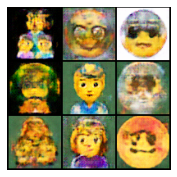

773:22
Epoch #1873 / 2000, Generator Loss: 51.394187927246094, Discriminator Loss: -21.445755004882812
Epoch #1874 / 2000, Generator Loss: 52.351932525634766, Discriminator Loss: -22.805166244506836
Epoch #1875 / 2000, Generator Loss: 52.59459686279297, Discriminator Loss: -27.73360252380371
Epoch #1876 / 2000, Generator Loss: 50.58304214477539, Discriminator Loss: -23.665287017822266
Generated images for Epoch #1876:


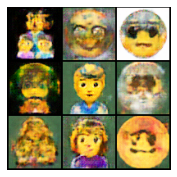

774:40
Epoch #1877 / 2000, Generator Loss: 50.570556640625, Discriminator Loss: -21.935829162597656
Epoch #1878 / 2000, Generator Loss: 52.069862365722656, Discriminator Loss: -22.667667388916016
Epoch #1879 / 2000, Generator Loss: 52.24663543701172, Discriminator Loss: -27.84935188293457
Epoch #1880 / 2000, Generator Loss: 52.84247589111328, Discriminator Loss: -22.462995529174805
Generated images for Epoch #1880:


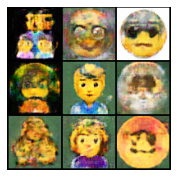

775:58
Epoch #1881 / 2000, Generator Loss: 52.5765380859375, Discriminator Loss: -25.20529556274414
Epoch #1882 / 2000, Generator Loss: 52.05027389526367, Discriminator Loss: -25.204240798950195
Epoch #1883 / 2000, Generator Loss: 51.750244140625, Discriminator Loss: -21.14803695678711
Epoch #1884 / 2000, Generator Loss: 51.20350646972656, Discriminator Loss: -25.1132755279541
Generated images for Epoch #1884:


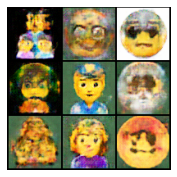

777:16
Epoch #1885 / 2000, Generator Loss: 51.66511917114258, Discriminator Loss: -24.322484970092773
Epoch #1886 / 2000, Generator Loss: 51.90993881225586, Discriminator Loss: -22.04900360107422
Epoch #1887 / 2000, Generator Loss: 51.596553802490234, Discriminator Loss: -22.653772354125977
Epoch #1888 / 2000, Generator Loss: 51.46446990966797, Discriminator Loss: -26.22186851501465
Generated images for Epoch #1888:


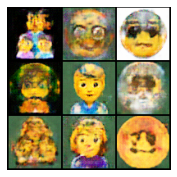

778:33
Epoch #1889 / 2000, Generator Loss: 52.791748046875, Discriminator Loss: -23.836233139038086
Epoch #1890 / 2000, Generator Loss: 51.33660888671875, Discriminator Loss: -25.53990936279297
Epoch #1891 / 2000, Generator Loss: 52.3311882019043, Discriminator Loss: -23.295989990234375
Epoch #1892 / 2000, Generator Loss: 53.16828918457031, Discriminator Loss: -26.2455997467041
Generated images for Epoch #1892:


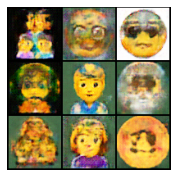

779:51
Epoch #1893 / 2000, Generator Loss: 54.394630432128906, Discriminator Loss: -19.254043579101562
Epoch #1894 / 2000, Generator Loss: 51.63739013671875, Discriminator Loss: -24.974143981933594
Epoch #1895 / 2000, Generator Loss: 51.223609924316406, Discriminator Loss: -19.562055587768555
Epoch #1896 / 2000, Generator Loss: 50.81492233276367, Discriminator Loss: -25.82686996459961
Generated images for Epoch #1896:


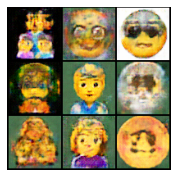

781:09
Epoch #1897 / 2000, Generator Loss: 51.92943572998047, Discriminator Loss: -24.161911010742188
Epoch #1898 / 2000, Generator Loss: 51.278106689453125, Discriminator Loss: -21.082233428955078
Epoch #1899 / 2000, Generator Loss: 51.53590393066406, Discriminator Loss: -26.648653030395508
Epoch #1900 / 2000, Generator Loss: 52.38043212890625, Discriminator Loss: -23.542240142822266
Generated images for Epoch #1900:


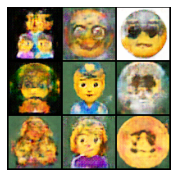

782:27
Epoch #1901 / 2000, Generator Loss: 52.67938232421875, Discriminator Loss: -26.05682373046875
Epoch #1902 / 2000, Generator Loss: 53.01439666748047, Discriminator Loss: -20.91583251953125
Epoch #1903 / 2000, Generator Loss: 51.04280471801758, Discriminator Loss: -24.08536148071289
Epoch #1904 / 2000, Generator Loss: 50.36494827270508, Discriminator Loss: -21.437541961669922
Generated images for Epoch #1904:


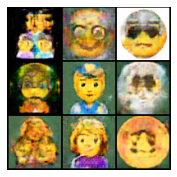

783:45
Epoch #1905 / 2000, Generator Loss: 53.34915542602539, Discriminator Loss: -20.457763671875
Epoch #1906 / 2000, Generator Loss: 52.619667053222656, Discriminator Loss: -20.455299377441406
Epoch #1907 / 2000, Generator Loss: 52.4373893737793, Discriminator Loss: -24.808940887451172
Epoch #1908 / 2000, Generator Loss: 51.83060836791992, Discriminator Loss: -19.030094146728516
Generated images for Epoch #1908:


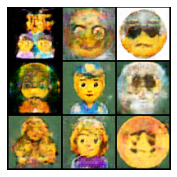

785:02
Epoch #1909 / 2000, Generator Loss: 51.5147705078125, Discriminator Loss: -20.475261688232422
Epoch #1910 / 2000, Generator Loss: 52.57994842529297, Discriminator Loss: -20.063236236572266
Epoch #1911 / 2000, Generator Loss: 53.37213134765625, Discriminator Loss: -27.364639282226562
Epoch #1912 / 2000, Generator Loss: 52.586639404296875, Discriminator Loss: -23.044618606567383
Generated images for Epoch #1912:


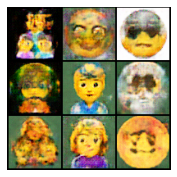

786:20
Epoch #1913 / 2000, Generator Loss: 53.664424896240234, Discriminator Loss: -23.309341430664062
Epoch #1914 / 2000, Generator Loss: 52.669281005859375, Discriminator Loss: -20.688865661621094
Epoch #1915 / 2000, Generator Loss: 52.18621826171875, Discriminator Loss: -22.450223922729492
Epoch #1916 / 2000, Generator Loss: 52.15830993652344, Discriminator Loss: -24.016117095947266
Generated images for Epoch #1916:


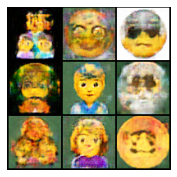

787:37
Epoch #1917 / 2000, Generator Loss: 52.38814163208008, Discriminator Loss: -23.426847457885742
Epoch #1918 / 2000, Generator Loss: 53.29193115234375, Discriminator Loss: -24.685894012451172
Epoch #1919 / 2000, Generator Loss: 52.14277648925781, Discriminator Loss: -18.620555877685547
Epoch #1920 / 2000, Generator Loss: 51.68108367919922, Discriminator Loss: -25.506610870361328
Generated images for Epoch #1920:


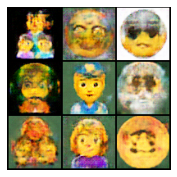

788:55
Epoch #1921 / 2000, Generator Loss: 52.47301483154297, Discriminator Loss: -22.26284408569336
Epoch #1922 / 2000, Generator Loss: 51.651615142822266, Discriminator Loss: -23.999425888061523
Epoch #1923 / 2000, Generator Loss: 52.970069885253906, Discriminator Loss: -22.316434860229492
Epoch #1924 / 2000, Generator Loss: 51.168243408203125, Discriminator Loss: -26.91579818725586
Generated images for Epoch #1924:


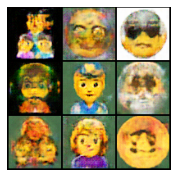

790:13
Epoch #1925 / 2000, Generator Loss: 52.27932357788086, Discriminator Loss: -22.478534698486328
Epoch #1926 / 2000, Generator Loss: 50.403968811035156, Discriminator Loss: -20.38188934326172
Epoch #1927 / 2000, Generator Loss: 53.071495056152344, Discriminator Loss: -23.900053024291992
Epoch #1928 / 2000, Generator Loss: 50.54559326171875, Discriminator Loss: -23.260604858398438
Generated images for Epoch #1928:


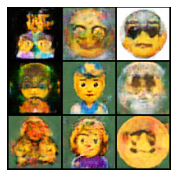

791:30
Epoch #1929 / 2000, Generator Loss: 49.809478759765625, Discriminator Loss: -25.59986686706543
Epoch #1930 / 2000, Generator Loss: 51.183372497558594, Discriminator Loss: -24.535045623779297
Epoch #1931 / 2000, Generator Loss: 51.014488220214844, Discriminator Loss: -22.400562286376953
Epoch #1932 / 2000, Generator Loss: 49.726158142089844, Discriminator Loss: -27.01470947265625
Generated images for Epoch #1932:


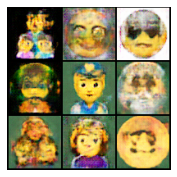

792:48
Epoch #1933 / 2000, Generator Loss: 51.76513671875, Discriminator Loss: -24.079357147216797
Epoch #1934 / 2000, Generator Loss: 51.70637512207031, Discriminator Loss: -22.19491958618164
Epoch #1935 / 2000, Generator Loss: 52.739501953125, Discriminator Loss: -24.97084617614746
Epoch #1936 / 2000, Generator Loss: 51.75408172607422, Discriminator Loss: -21.85308074951172
Generated images for Epoch #1936:


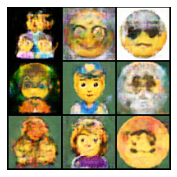

794:06
Epoch #1937 / 2000, Generator Loss: 50.78260803222656, Discriminator Loss: -21.985309600830078
Epoch #1938 / 2000, Generator Loss: 51.544105529785156, Discriminator Loss: -23.355297088623047
Epoch #1939 / 2000, Generator Loss: 52.662384033203125, Discriminator Loss: -22.401765823364258
Epoch #1940 / 2000, Generator Loss: 52.97557830810547, Discriminator Loss: -28.98627471923828
Generated images for Epoch #1940:


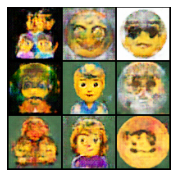

795:24
Epoch #1941 / 2000, Generator Loss: 50.79777526855469, Discriminator Loss: -24.120365142822266
Epoch #1942 / 2000, Generator Loss: 52.59504318237305, Discriminator Loss: -25.151233673095703
Epoch #1943 / 2000, Generator Loss: 54.0692138671875, Discriminator Loss: -24.89399528503418
Epoch #1944 / 2000, Generator Loss: 53.820716857910156, Discriminator Loss: -23.153419494628906
Generated images for Epoch #1944:


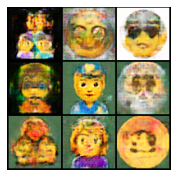

796:42
Epoch #1945 / 2000, Generator Loss: 52.644229888916016, Discriminator Loss: -22.454538345336914
Epoch #1946 / 2000, Generator Loss: 52.990718841552734, Discriminator Loss: -25.91262435913086
Epoch #1947 / 2000, Generator Loss: 51.87641143798828, Discriminator Loss: -23.058576583862305
Epoch #1948 / 2000, Generator Loss: 52.02531433105469, Discriminator Loss: -23.269184112548828
Generated images for Epoch #1948:


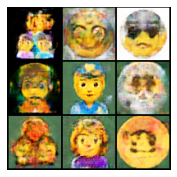

798:00
Epoch #1949 / 2000, Generator Loss: 54.01668167114258, Discriminator Loss: -22.626951217651367
Epoch #1950 / 2000, Generator Loss: 53.348140716552734, Discriminator Loss: -24.353906631469727
Epoch #1951 / 2000, Generator Loss: 53.2591552734375, Discriminator Loss: -24.992876052856445
Epoch #1952 / 2000, Generator Loss: 53.0685920715332, Discriminator Loss: -25.897836685180664
Generated images for Epoch #1952:


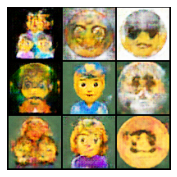

799:18
Epoch #1953 / 2000, Generator Loss: 53.67731475830078, Discriminator Loss: -24.77820587158203
Epoch #1954 / 2000, Generator Loss: 53.26106262207031, Discriminator Loss: -19.938940048217773
Epoch #1955 / 2000, Generator Loss: 52.07227325439453, Discriminator Loss: -21.656951904296875
Epoch #1956 / 2000, Generator Loss: 52.56774139404297, Discriminator Loss: -21.334896087646484
Generated images for Epoch #1956:


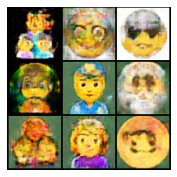

800:36
Epoch #1957 / 2000, Generator Loss: 53.63043212890625, Discriminator Loss: -23.792327880859375
Epoch #1958 / 2000, Generator Loss: 54.18181610107422, Discriminator Loss: -19.082162857055664
Epoch #1959 / 2000, Generator Loss: 53.319034576416016, Discriminator Loss: -27.462871551513672
Epoch #1960 / 2000, Generator Loss: 53.28672409057617, Discriminator Loss: -20.984745025634766
Generated images for Epoch #1960:


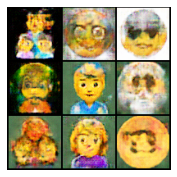

801:53
Epoch #1961 / 2000, Generator Loss: 52.31645584106445, Discriminator Loss: -23.551671981811523
Epoch #1962 / 2000, Generator Loss: 53.023887634277344, Discriminator Loss: -21.222393035888672
Epoch #1963 / 2000, Generator Loss: 54.144622802734375, Discriminator Loss: -22.559329986572266
Epoch #1964 / 2000, Generator Loss: 52.444358825683594, Discriminator Loss: -27.410171508789062
Generated images for Epoch #1964:


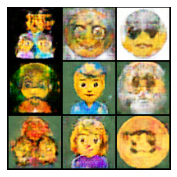

803:11
Epoch #1965 / 2000, Generator Loss: 54.909706115722656, Discriminator Loss: -26.24872589111328
Epoch #1966 / 2000, Generator Loss: 51.75660705566406, Discriminator Loss: -22.694738388061523
Epoch #1967 / 2000, Generator Loss: 52.88581085205078, Discriminator Loss: -26.611820220947266
Epoch #1968 / 2000, Generator Loss: 53.57023620605469, Discriminator Loss: -28.546314239501953
Generated images for Epoch #1968:


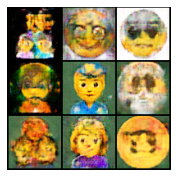

804:29
Epoch #1969 / 2000, Generator Loss: 53.82084655761719, Discriminator Loss: -28.87417221069336
Epoch #1970 / 2000, Generator Loss: 53.43939208984375, Discriminator Loss: -21.989967346191406
Epoch #1971 / 2000, Generator Loss: 54.68690872192383, Discriminator Loss: -24.56983184814453
Epoch #1972 / 2000, Generator Loss: 53.95711898803711, Discriminator Loss: -22.170427322387695
Generated images for Epoch #1972:


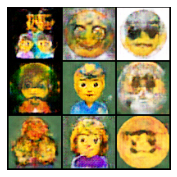

805:47
Epoch #1973 / 2000, Generator Loss: 53.73168182373047, Discriminator Loss: -20.87388801574707
Epoch #1974 / 2000, Generator Loss: 51.142967224121094, Discriminator Loss: -26.683712005615234
Epoch #1975 / 2000, Generator Loss: 54.41068649291992, Discriminator Loss: -20.186141967773438
Epoch #1976 / 2000, Generator Loss: 54.794376373291016, Discriminator Loss: -24.60407257080078
Generated images for Epoch #1976:


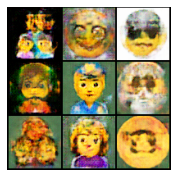

807:04
Epoch #1977 / 2000, Generator Loss: 52.65887451171875, Discriminator Loss: -18.656078338623047
Epoch #1978 / 2000, Generator Loss: 53.11692810058594, Discriminator Loss: -23.716323852539062
Epoch #1979 / 2000, Generator Loss: 54.170631408691406, Discriminator Loss: -21.873756408691406
Epoch #1980 / 2000, Generator Loss: 53.94719696044922, Discriminator Loss: -18.296689987182617
Generated images for Epoch #1980:


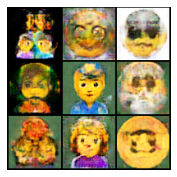

808:21
Epoch #1981 / 2000, Generator Loss: 54.65446472167969, Discriminator Loss: -21.09356117248535
Epoch #1982 / 2000, Generator Loss: 53.19799041748047, Discriminator Loss: -22.396133422851562
Epoch #1983 / 2000, Generator Loss: 55.46519088745117, Discriminator Loss: -26.51457977294922
Epoch #1984 / 2000, Generator Loss: 54.574825286865234, Discriminator Loss: -24.487504959106445
Generated images for Epoch #1984:


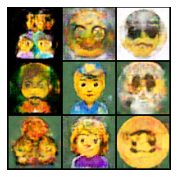

809:39
Epoch #1985 / 2000, Generator Loss: 54.93813705444336, Discriminator Loss: -21.758636474609375
Epoch #1986 / 2000, Generator Loss: 53.61680603027344, Discriminator Loss: -21.003040313720703
Epoch #1987 / 2000, Generator Loss: 54.873905181884766, Discriminator Loss: -23.959857940673828
Epoch #1988 / 2000, Generator Loss: 55.67389678955078, Discriminator Loss: -21.43791389465332
Generated images for Epoch #1988:


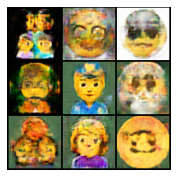

810:57
Epoch #1989 / 2000, Generator Loss: 55.196441650390625, Discriminator Loss: -18.424522399902344
Epoch #1990 / 2000, Generator Loss: 55.72454833984375, Discriminator Loss: -22.148237228393555
Epoch #1991 / 2000, Generator Loss: 54.77783966064453, Discriminator Loss: -20.08671760559082
Epoch #1992 / 2000, Generator Loss: 56.48085403442383, Discriminator Loss: -24.36333465576172
Generated images for Epoch #1992:


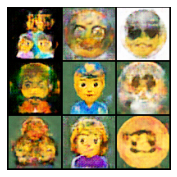

812:15
Epoch #1993 / 2000, Generator Loss: 56.24018096923828, Discriminator Loss: -23.734636306762695
Epoch #1994 / 2000, Generator Loss: 55.02136993408203, Discriminator Loss: -27.657794952392578
Epoch #1995 / 2000, Generator Loss: 55.20602798461914, Discriminator Loss: -25.03338623046875
Epoch #1996 / 2000, Generator Loss: 56.450218200683594, Discriminator Loss: -24.34494400024414
Generated images for Epoch #1996:


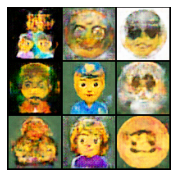

813:33
Epoch #1997 / 2000, Generator Loss: 54.60292434692383, Discriminator Loss: -23.303010940551758
Epoch #1998 / 2000, Generator Loss: 54.298484802246094, Discriminator Loss: -21.695602416992188
Epoch #1999 / 2000, Generator Loss: 53.53316879272461, Discriminator Loss: -22.485092163085938


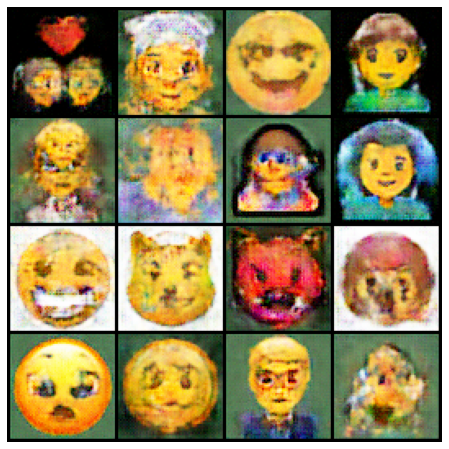

In [15]:
#use binary cross entropy for loss
loss_function = nn.BCELoss()

#for best results use: num_epochs = really big number
num_epochs = 2000

batch_size = 256
d_losses, g_losses = [], []

#define dataloaders
dataset = TensorDataset(images, labels)

# We need a random number generator that works on gpu for shuffle to work
random_generator = torch.Generator(device=torch.get_default_device())
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, generator=random_generator)

#learning rate and optimizers
learning_rate = 0.0001
d_optimizer = optim.Adam(discriminator.parameters(), lr=learning_rate)
g_optimizer = optim.Adam(generator.parameters(), lr=learning_rate)

start_time = time.time()


# How frequently to show and save sample images
image_epoch_frequency = 4
# How often to save the model weights
model_save_frequency = 10
# How many times to train the discriminator for 1 pass on the generator
discriminator_passes = 5
# Discriminator training noise amount
training_noise = 0.01



#training loop for generating emojis
for epoch in range(num_epochs):
    #dataloader shuffles the batches

    for d_pass in range(discriminator_passes):
        for real_data, iteration in dataloader:
            #only need this line if running on cuda:
            real_data = real_data.to(processing_device)


             # Generate fake data
            fake_data = generator(noise(real_data.size(0))).detach()
            
            # Train the critic
            d_optimizer.zero_grad()
            real_scores = discriminator(real_data)
            fake_scores = discriminator(fake_data)
            
            # Compute WGAN loss
            d_loss = critic_loss(real_scores, fake_scores)
            
            # Add gradient penalty (if using WGAN-GP)
            gp = gradient_penalty(discriminator, real_data, fake_data)
            d_loss += lambda_gp * gp
            
            d_loss.backward()
            d_optimizer.step()

    for real_data, iteration in dataloader:
        #train the generator
        g_optimizer.zero_grad()
        fake_data = generator(noise(batch_size))
        fake_pred = discriminator(fake_data)
        g_loss = generator_loss(fake_pred)
        g_loss.backward()
        g_optimizer.step()

    #record losses
    d_losses.append(d_loss.item())
    g_losses.append(g_loss.item())
    print(f"Epoch #{epoch} / {num_epochs}, Generator Loss: {g_loss.item()}, Discriminator Loss: {d_loss.item()}")


    #print images at every x epochs
    if epoch % image_epoch_frequency == 0:
        print(f"Generated images for Epoch #{epoch}:")
        input_noise = noise(9) if sample_noise == None else sample_noise
        image_grid(3, 3, input_noise=sample_noise, size=3, save_path=f'progress4/{epoch}.jpg')

        now = int(time.time() - start_time)
        print(f'{now // 60}:{now % 60:02}')

    if epoch % model_save_frequency == 0:
        save_model()
    

#generate final set of images
image_grid(4, 4)

The best generated emoji had a score of: -51.739830017089844
Here is the best chosen, final generated emoji:


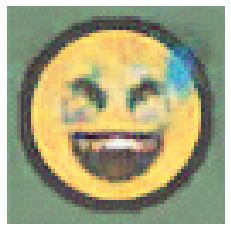

In [16]:
def best_emoji_output(generator, discriminator, generated_images):
    #if cuda is used, then the images must be on the same device (GPU using cuda)
    #generated_images = generated_images.to(processing_device)

    #target yellow color using RGB
    #if using cude make sure to use param for device: target_yellow = torch.tensor([1.0, 1.0, 0.0], device=processing_device).view(1, 3, 1, 1)
    target_yellow = torch.tensor([1.0, 1.0, 0.0]).view(1, 3, 1, 1)  #looks for a brighter yellow

    #selecting the best yellow emoji
    def select_best_yellow_emoji(generated_images, discriminator):
        scores = []
        for img in generated_images:
            #only needed for cuda usage:
            #img = img.to(processing_device)

            #gets discriminator scores
            disc_score = discriminator(img.unsqueeze(0)).item()

            #computes the color similarity to yellow
            avg_color = img.mean(dim=(1, 2))  #average color per channel
            yellow_bias = -F_nn.mse_loss(avg_color, target_yellow.view(-1))  #the lower the MSE the closer the color is to yellow

            combined_score = disc_score + yellow_bias.item()
            scores.append(combined_score)

        #gets the image with highest score
        best_index = scores.index(max(scores))
        best_image = generated_images[best_index]
        print(f"The best generated emoji had a score of: {scores[best_index]}")
        return best_image

    best_emoji = select_best_yellow_emoji(generated_images, discriminator)

    #output the best emoji
    print(f"Here is the best chosen, final generated emoji:")
    plt.figure(figsize=(4, 4))
    grid = torchvision.utils.make_grid(best_emoji.unsqueeze(0), normalize=True)
    plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
    plt.axis("off")
    plt.show()

best_emoji_output(generator, discriminator, generator(noise(12)))

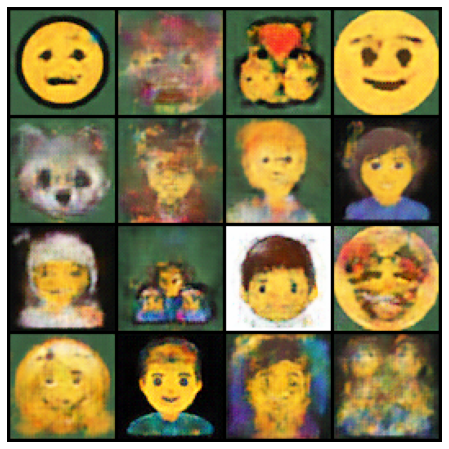

In [17]:
image_grid(4, 4)

In [19]:
# This exports the model in the ONNX format so it can be used on a website.
# You need onnx installed: 'pip install onnx'
torch.onnx.export(generator, (noise(1),), 'model.onnx', input_names=['input'], output_names=['output'])